/ssd/users/kevin/conda/test_SNPmanifold/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


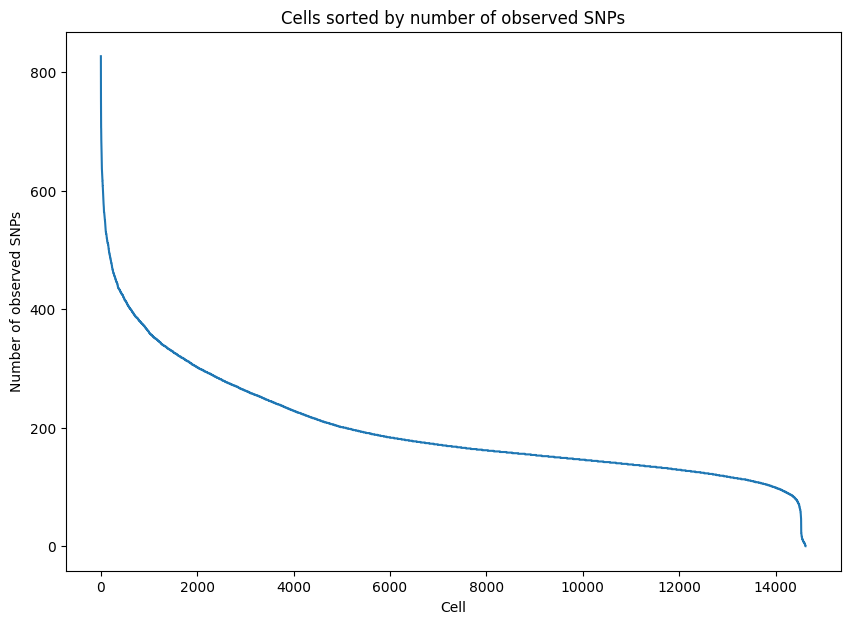

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


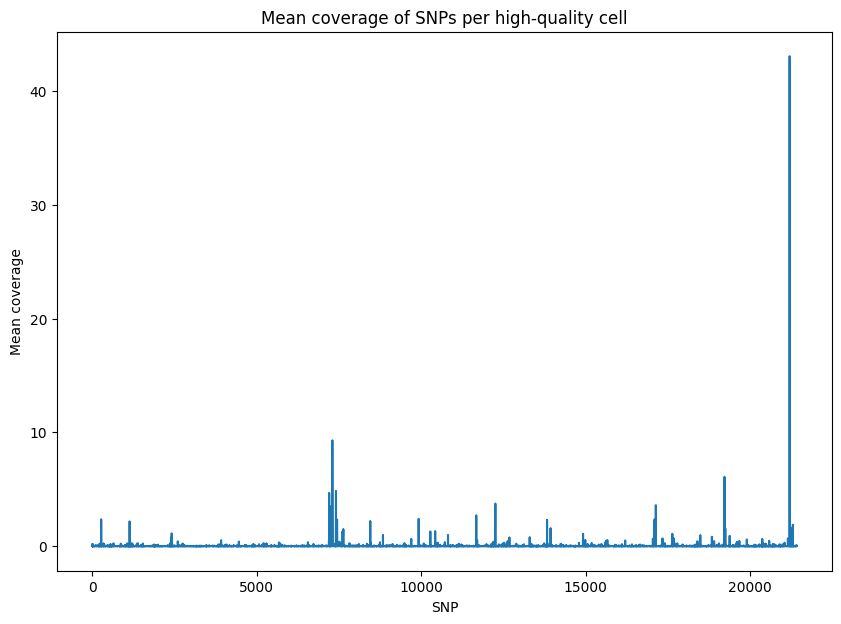

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


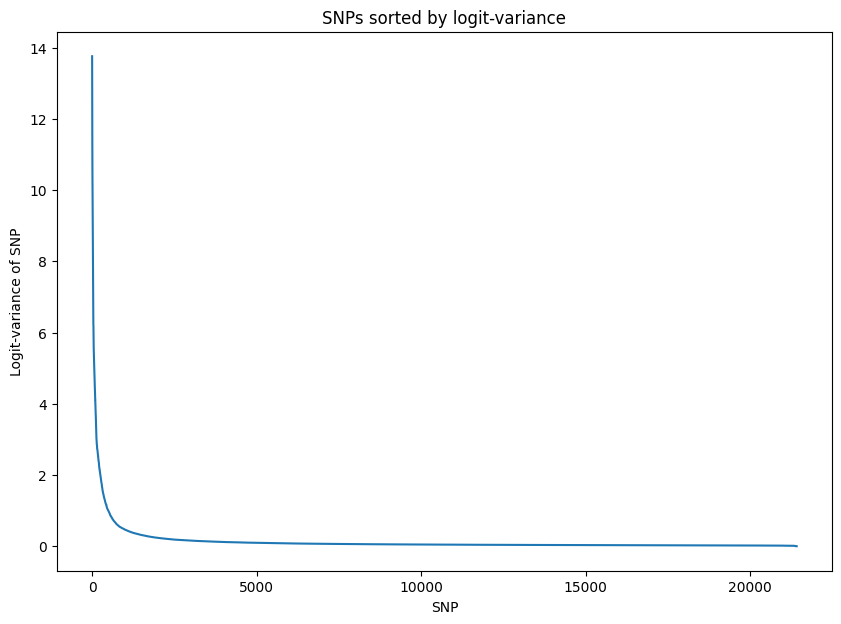

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.146723
Epoch[20/2000], Cost: 0.894500
Epoch[30/2000], Cost: 0.777520
Epoch[40/2000], Cost: 0.712085
Epoch[50/2000], Cost: 0.668540
Epoch[60/2000], Cost: 0.635791
Epoch[70/2000], Cost: 0.609906
Epoch[80/2000], Cost: 0.588004
Epoch[90/2000], Cost: 0.569144
Epoch[100/2000], Cost: 0.552631
Epoch[200/2000], Cost: 0.458493
Epoch[300/2000], Cost: 0.418835
Epoch[400/2000], Cost: 0.398808
Epoch[500/2000], Cost: 0.387589
Epoch[600/2000], Cost: 0.380788
Epoch[700/2000], Cost: 0.376548
Epoch[800/2000], Cost: 0.373793
Epoch[900/2000], Cost: 0.371968
Epoch[1000/2000], Cost: 0.370720
Epoch[1100/2000], Cost: 0.369805
Epoch[1200/2000], Cost: 0.369133
Epoch[1300/2000], Cost: 0.368641
Epoch[1400/2000], Cost: 0.368249
Epoch[1500/2000], Cost: 0.367961
Epoch[1600/20

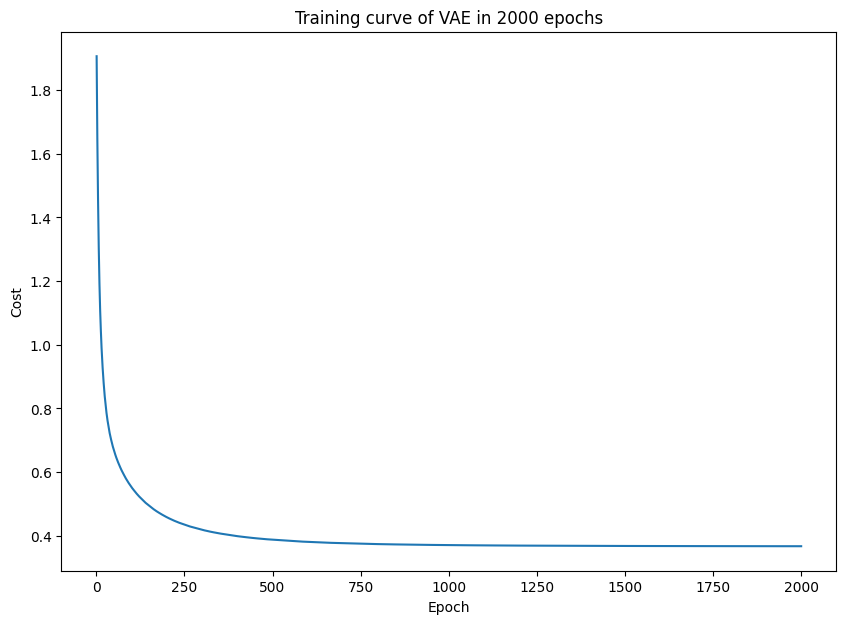

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


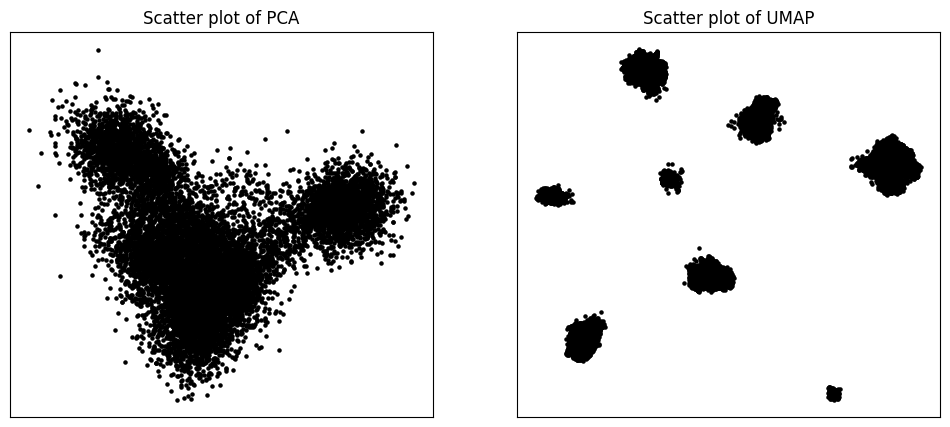

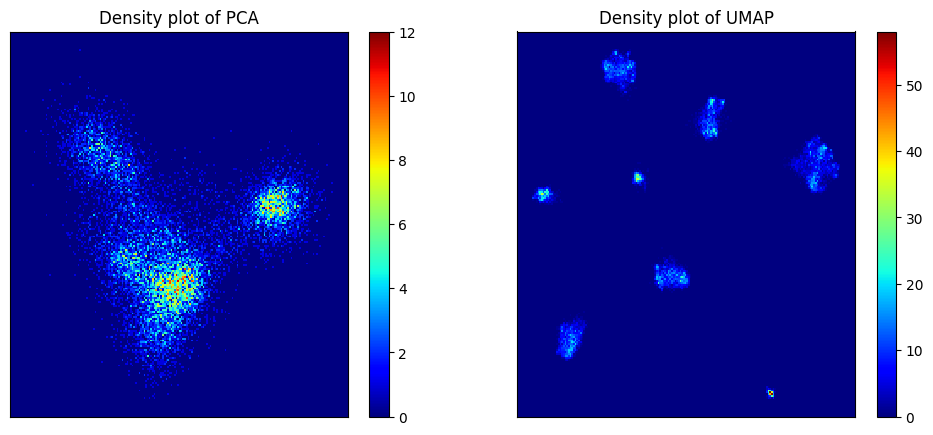

Start clustering.
2 clusters, Distortion: 318209.000000
3 clusters, Distortion: 190163.593750
4 clusters, Distortion: 114228.859375
5 clusters, Distortion: 82208.695312
6 clusters, Distortion: 41296.460938
7 clusters, Distortion: 19952.134766
8 clusters, Distortion: 5350.903809
9 clusters, Distortion: 4904.245605
10 clusters, Distortion: 4372.045898
11 clusters, Distortion: 4003.944336
12 clusters, Distortion: 3421.457520
13 clusters, Distortion: 3731.485840
14 clusters, Distortion: 2965.750732
15 clusters, Distortion: 2723.554443
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


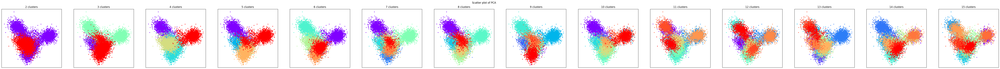

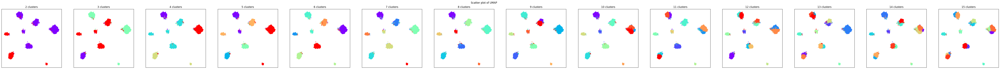

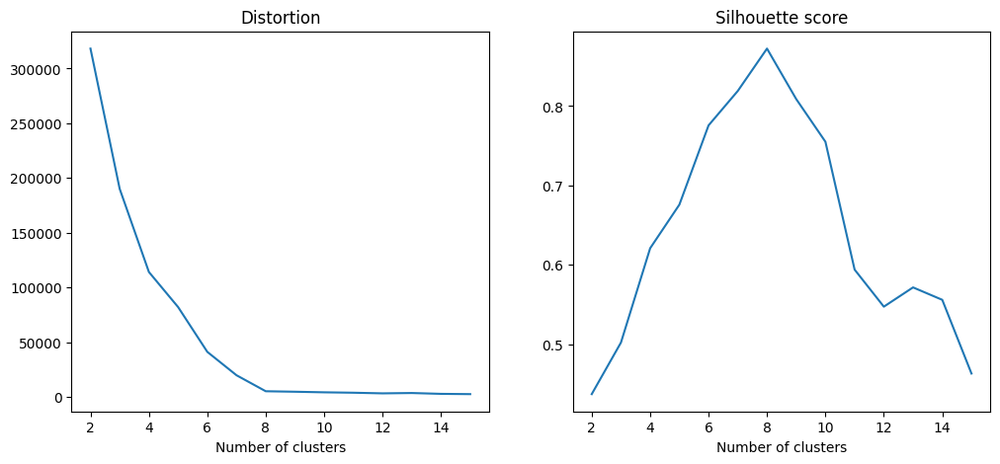

PCA and UMAP of individual clusters will be shown below.


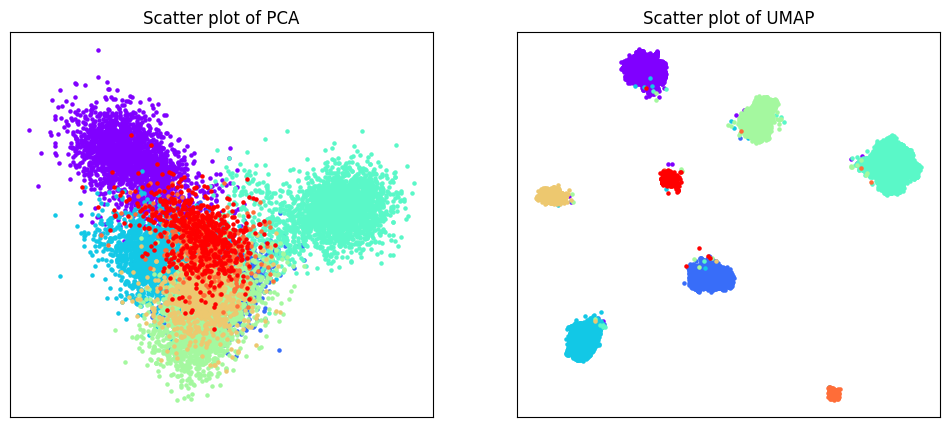

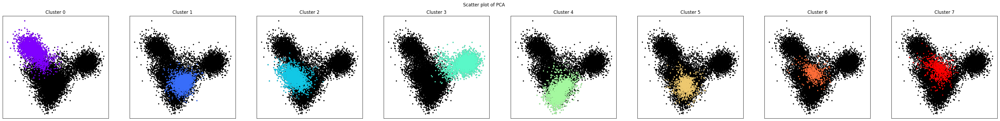

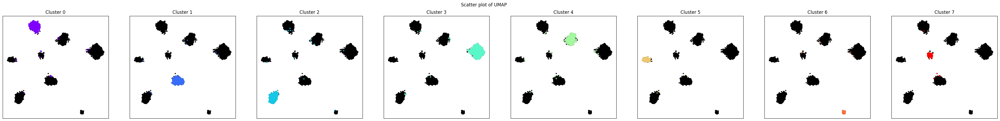

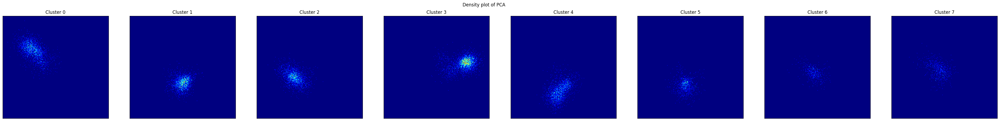

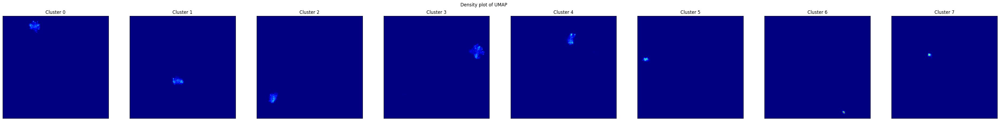

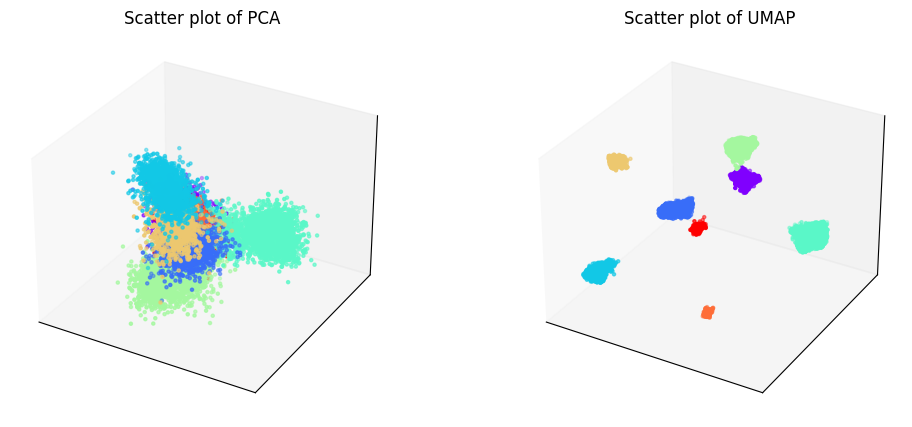

Phylogenetic tree in latent space will be shown below.


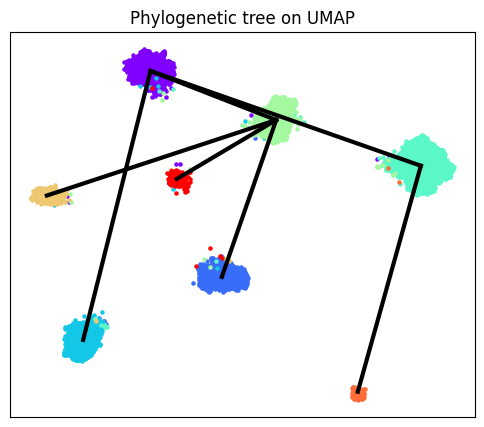

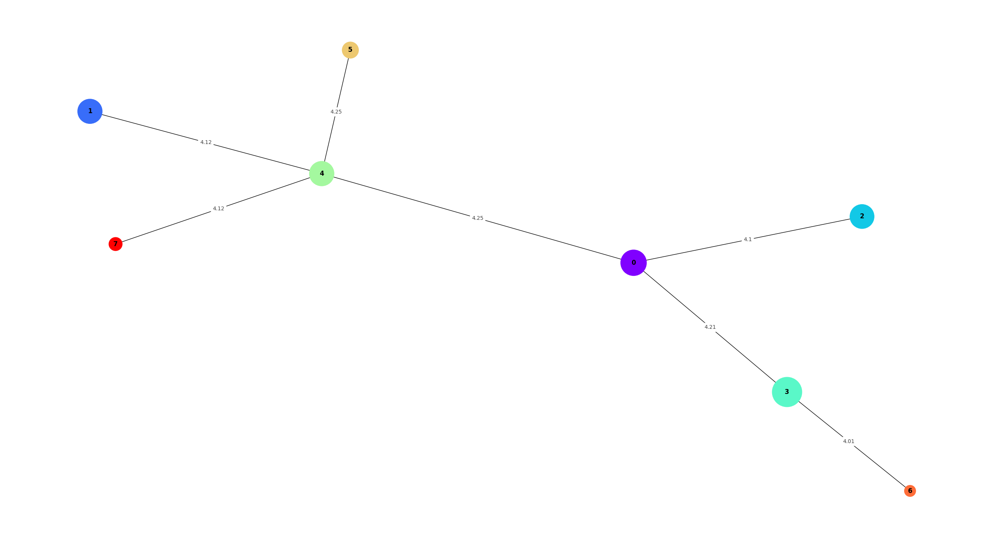

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


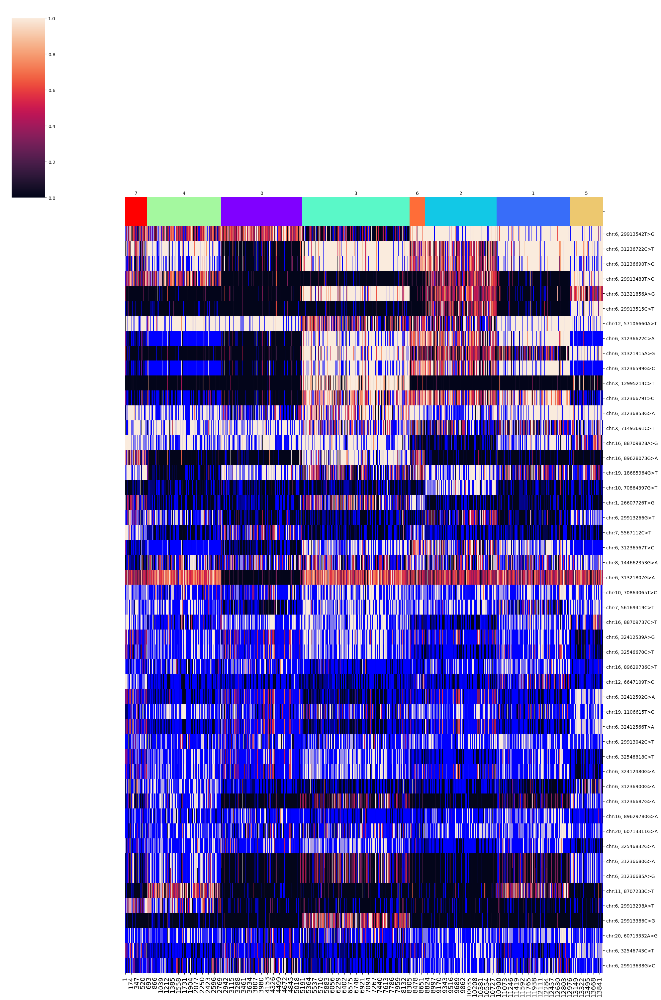

SNPs sorted by lowest p-value will be shown below


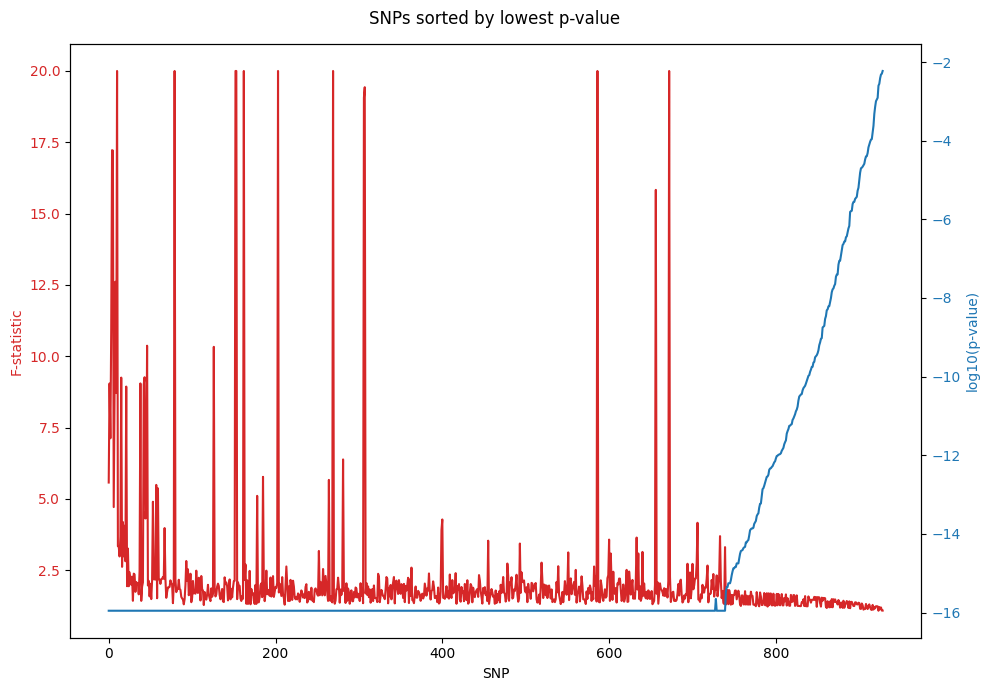

In [1]:
import torch
torch.set_default_device('cuda')
torch.cuda.set_device('cuda:6')

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

normalized_layer1 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
normalized_layer1.filtering()
normalized_layer1.training()
normalized_layer1.clustering(algorithm = "kmeans_umap3d")
normalized_layer1.phylogeny(cluster_no = 8)

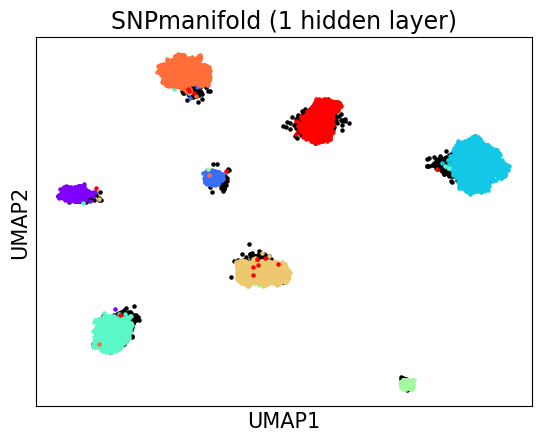

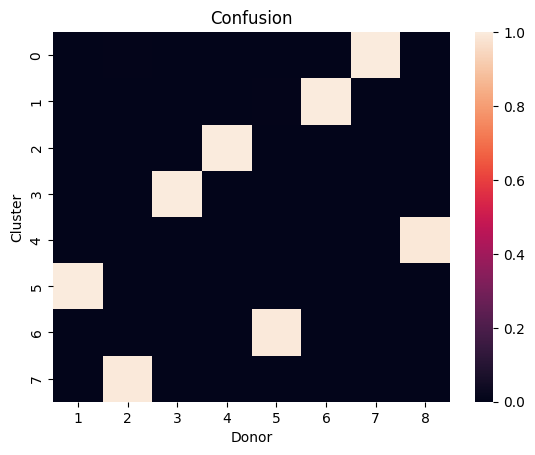

accuracy: 99.65493684792426
silhouette score: 0.8697957212748683


In [2]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[normalized_layer1.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[normalized_layer1.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(normalized_layer1.embedding_2d[donors[8], 0], normalized_layer1.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(normalized_layer1.embedding_2d[donors[w], 0], normalized_layer1.embedding_2d[donors[w], 1], s = 5, color = normalized_layer1.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = normalized_layer1.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(normalized_layer1.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(normalized_layer1.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


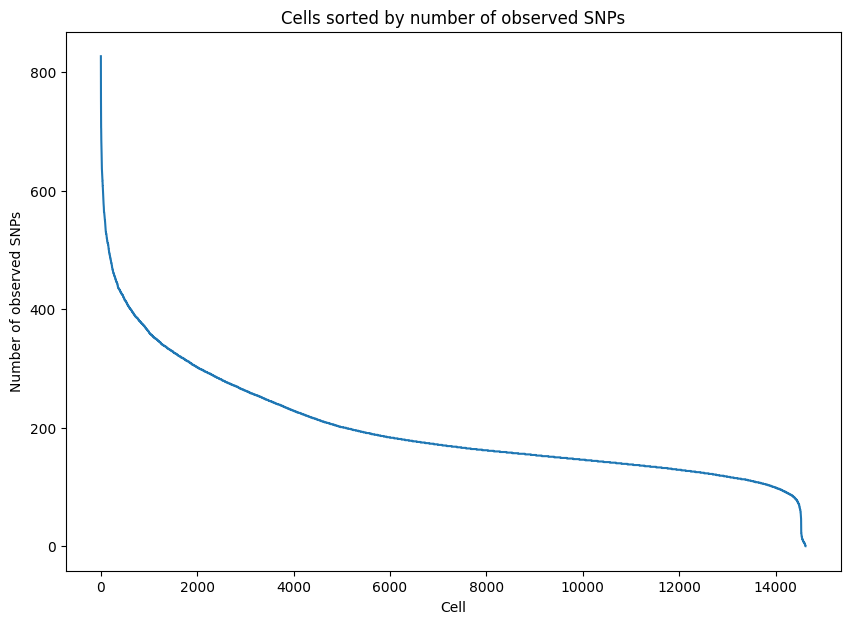

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


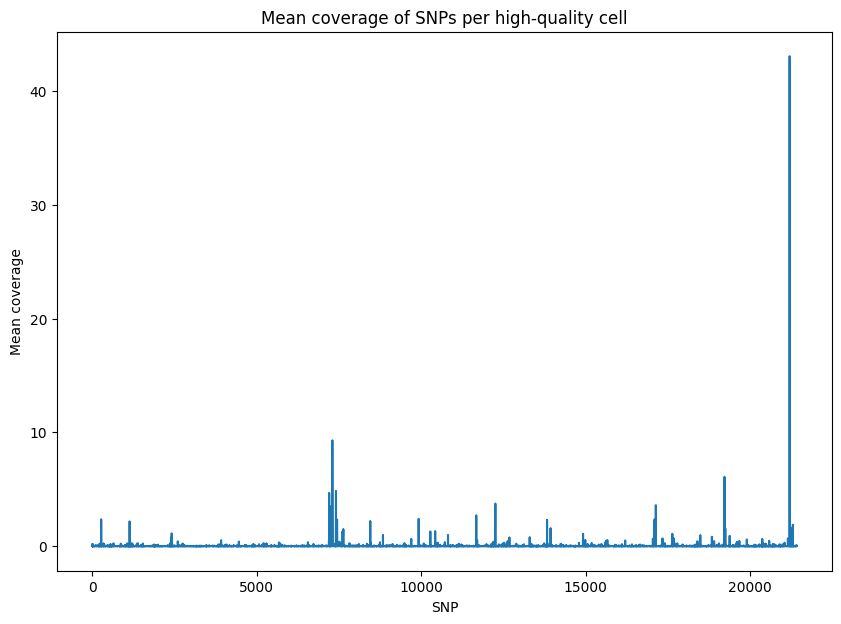

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


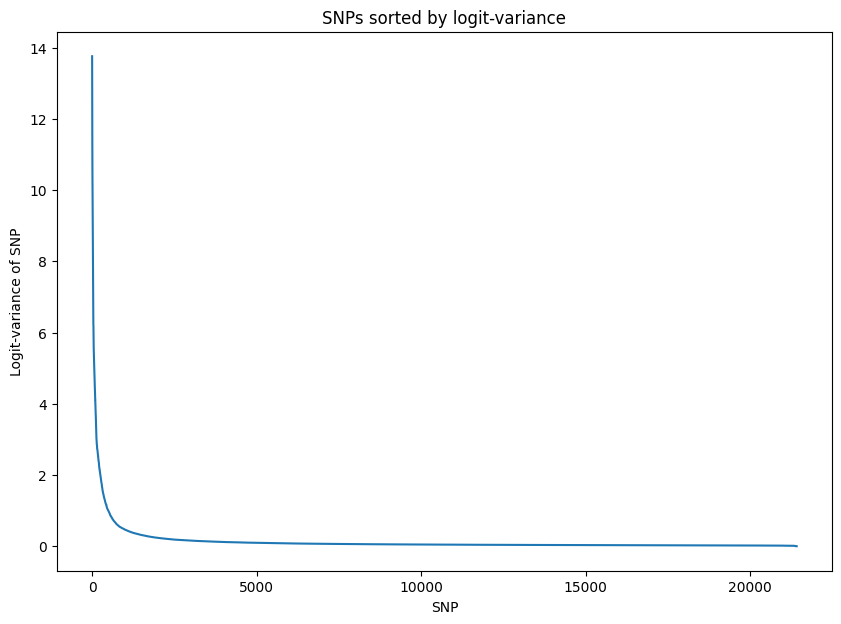

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.147370
Epoch[20/2000], Cost: 0.855518
Epoch[30/2000], Cost: 0.743693
Epoch[40/2000], Cost: 0.700219
Epoch[50/2000], Cost: 0.671546
Epoch[60/2000], Cost: 0.648555
Epoch[70/2000], Cost: 0.628418
Epoch[80/2000], Cost: 0.609559
Epoch[90/2000], Cost: 0.591634
Epoch[100/2000], Cost: 0.574576
Epoch[200/2000], Cost: 0.467052
Epoch[300/2000], Cost: 0.422249
Epoch[400/2000], Cost: 0.399999
Epoch[500/2000], Cost: 0.386727
Epoch[600/2000], Cost: 0.378558
Epoch[700/2000], Cost: 0.373903
Epoch[800/2000], Cost: 0.370240
Epoch[900/2000], Cost: 0.367790
Epoch[1000/2000], Cost: 0.368206
Epoch[1100/2000], Cost: 0.364682
Epoch[1200/2000], Cost: 0.364017
Epoch[1300/2000], Cost: 0.362896
Epoch[1400/2000], Cost: 0.362628
Epoch[1500/2000], Cost: 0.361739
Epoch[1600/20

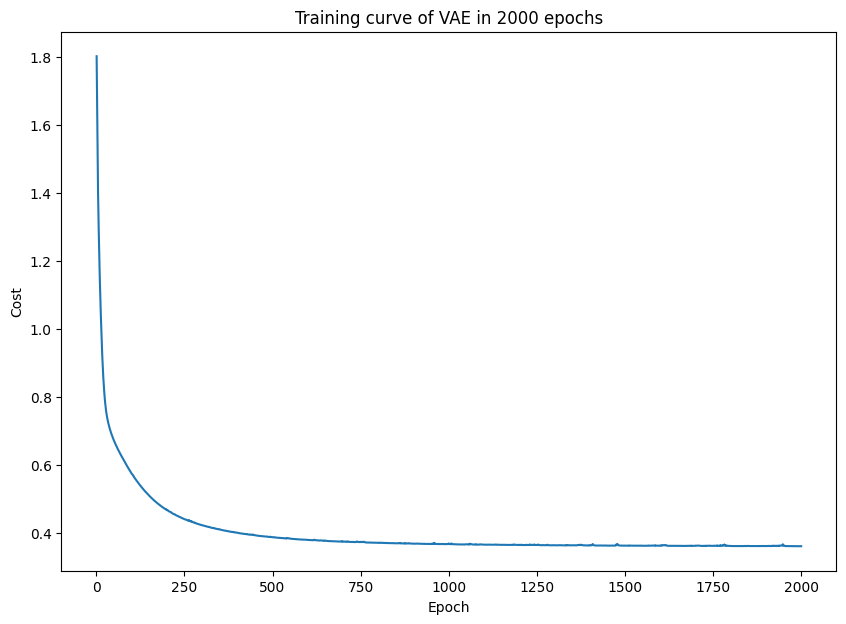

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


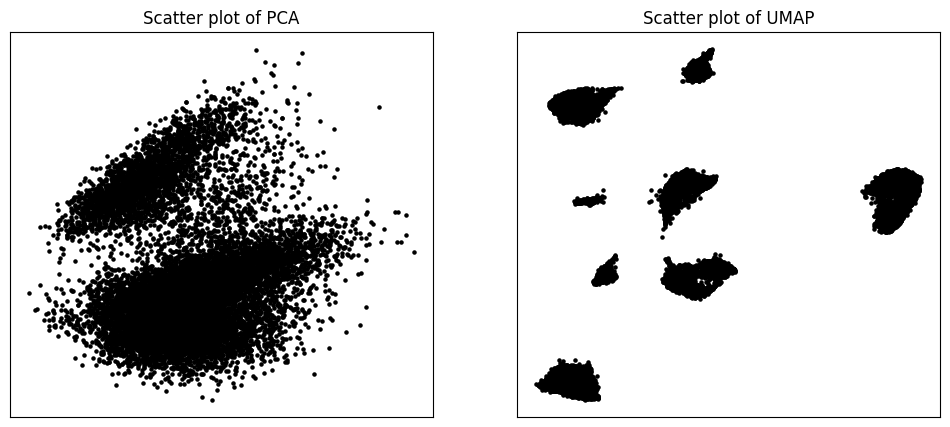

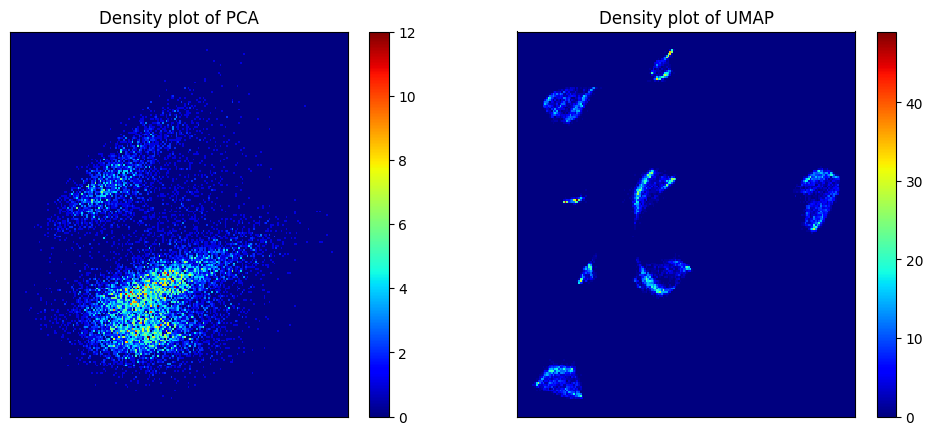

Start clustering.
2 clusters, Distortion: 403165.156250
3 clusters, Distortion: 159633.125000
4 clusters, Distortion: 87467.757812
5 clusters, Distortion: 52379.191406
6 clusters, Distortion: 29619.185547
7 clusters, Distortion: 18172.298828
8 clusters, Distortion: 11157.858398
9 clusters, Distortion: 9176.829102
10 clusters, Distortion: 8798.141602
11 clusters, Distortion: 6816.621094
12 clusters, Distortion: 6665.867676
13 clusters, Distortion: 5222.425781
14 clusters, Distortion: 4860.153320
15 clusters, Distortion: 4920.925293
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


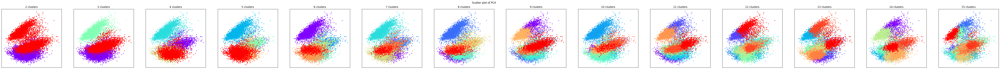

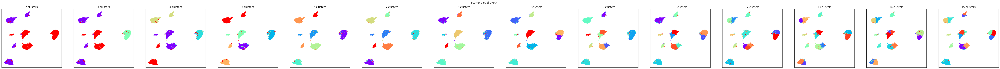

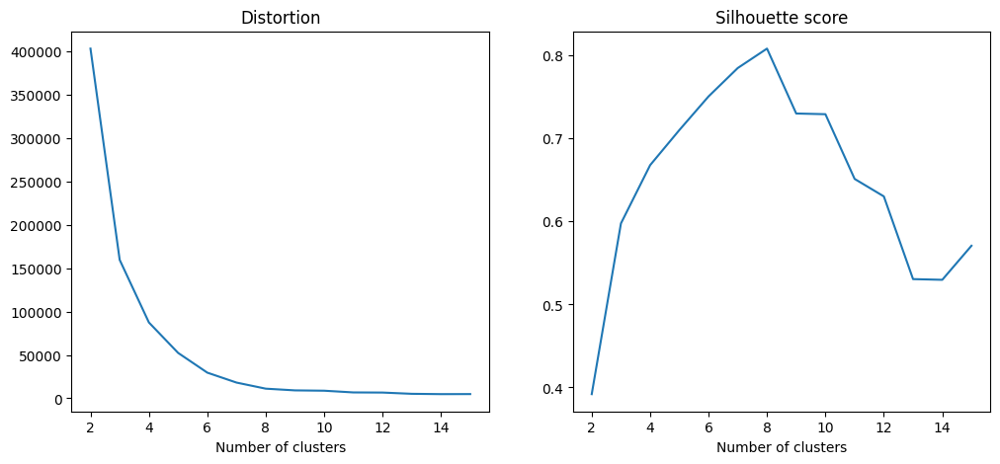

PCA and UMAP of individual clusters will be shown below.


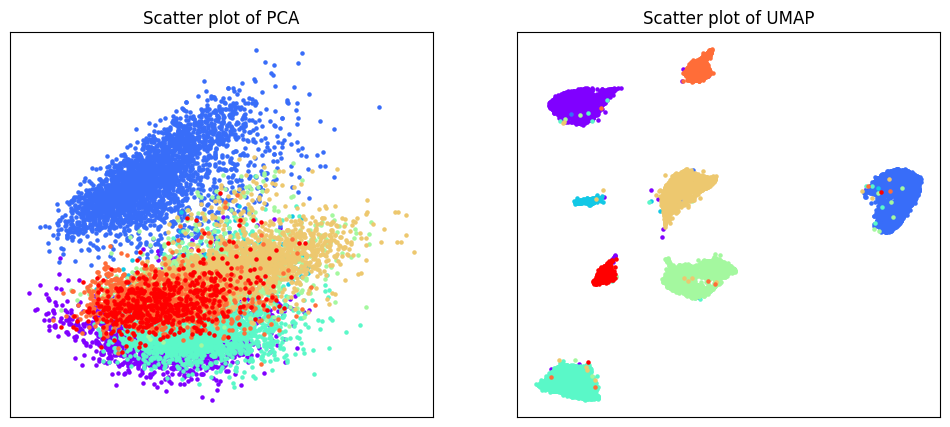

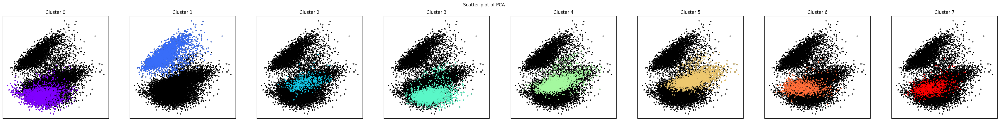

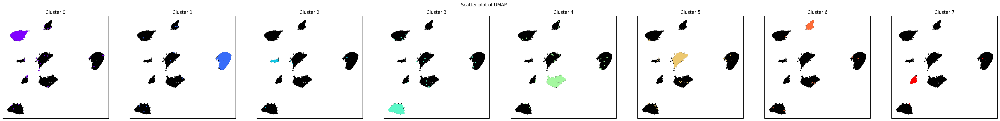

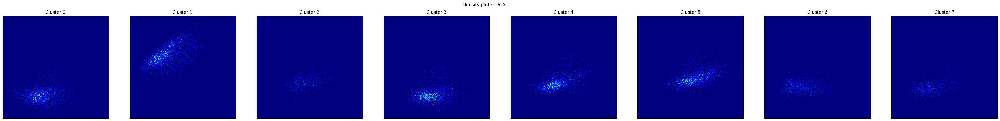

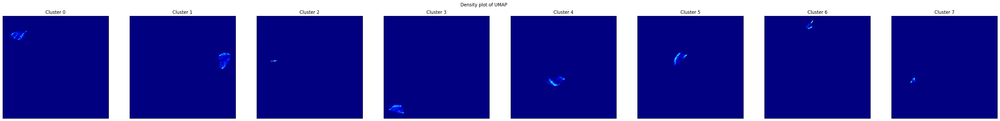

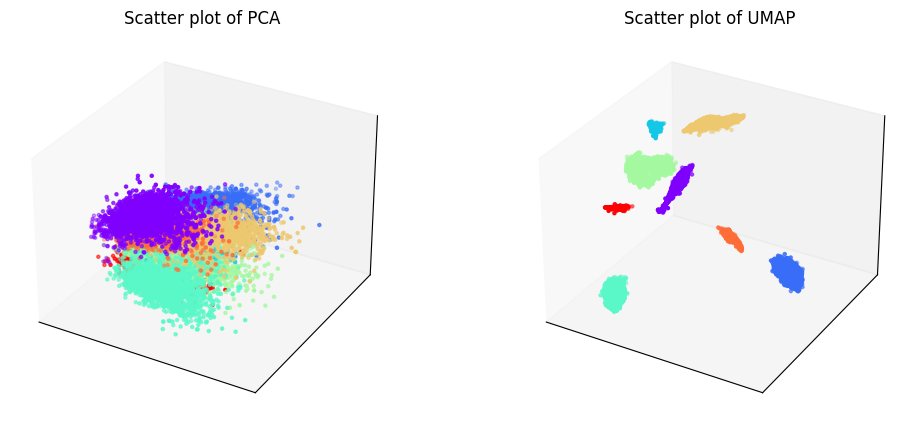

Phylogenetic tree in latent space will be shown below.


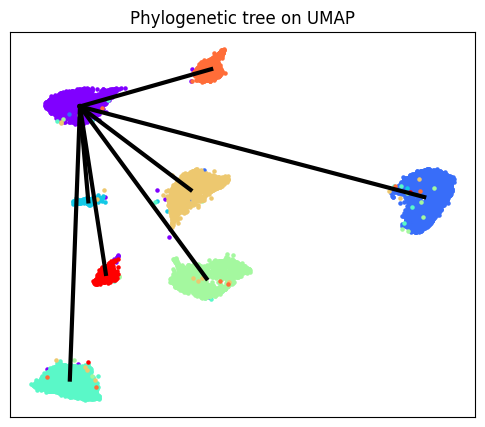

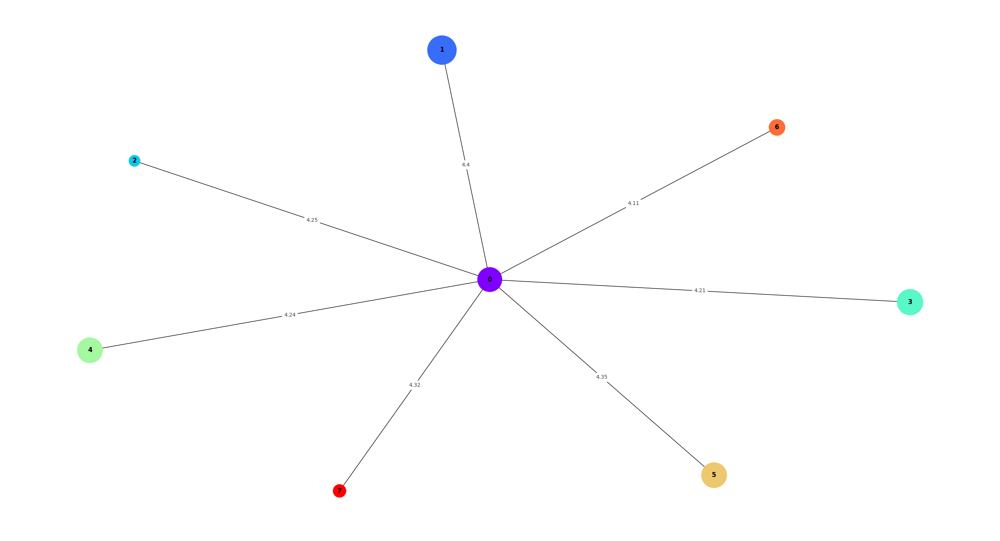

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


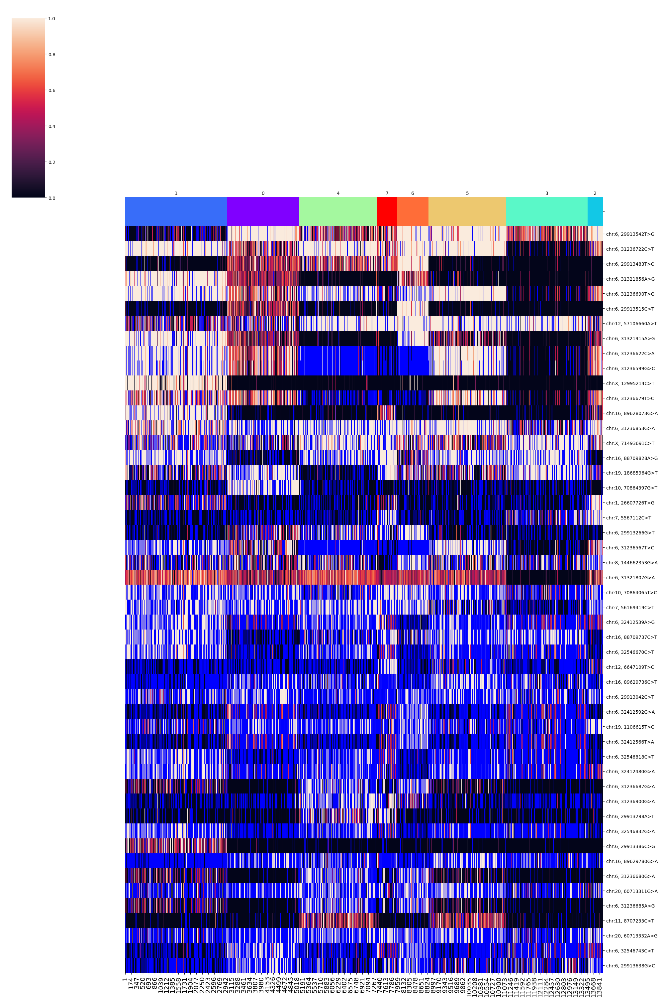

SNPs sorted by lowest p-value will be shown below


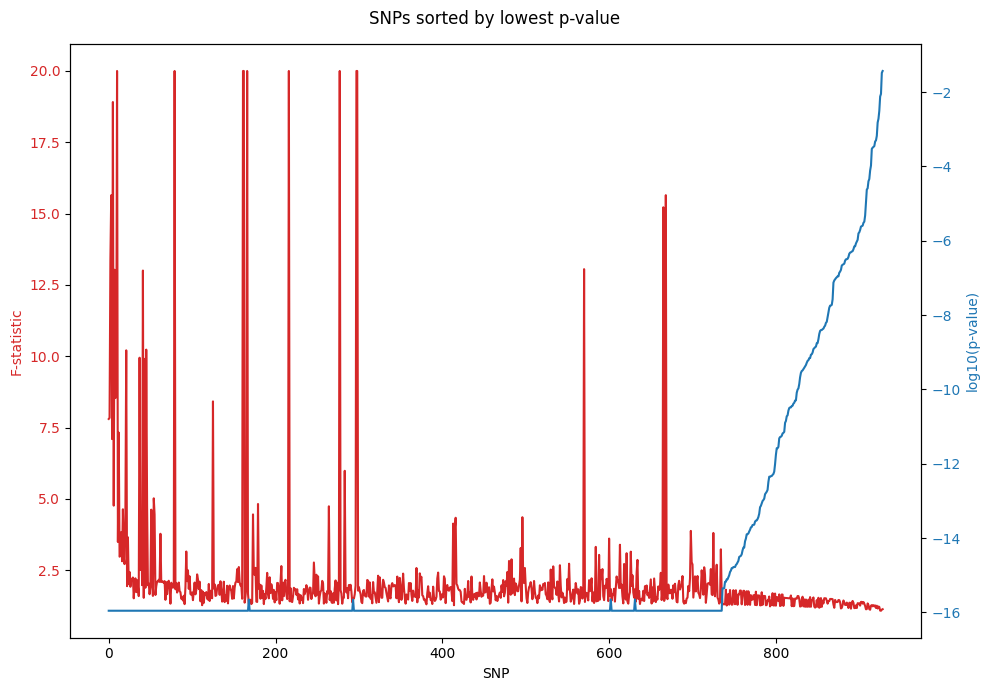

In [3]:
del normalized_layer1

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer3_updated.ipynb

unnormalized_layer3 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8", SNPread = "unnormalized")
unnormalized_layer3.filtering()
unnormalized_layer3.training()
unnormalized_layer3.clustering(algorithm = "kmeans_umap3d")
unnormalized_layer3.phylogeny(cluster_no = 8)

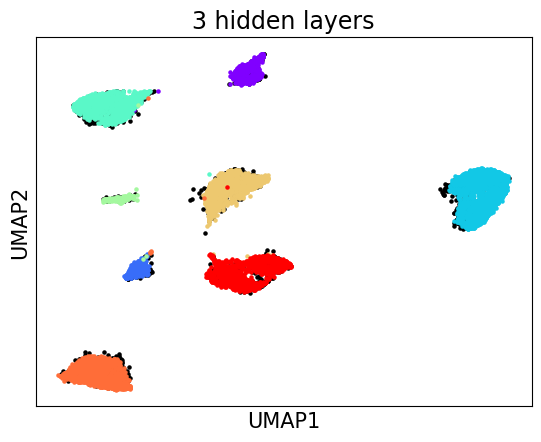

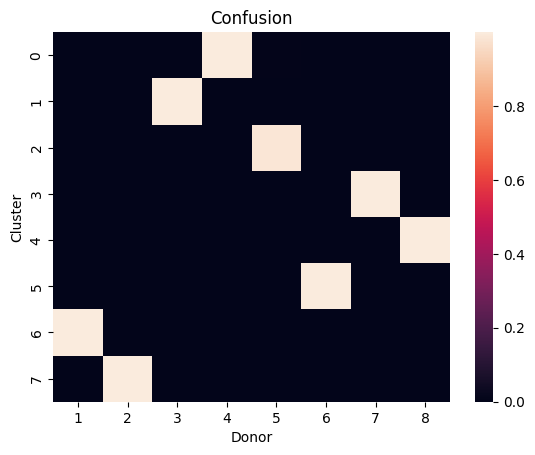

accuracy: 99.61717434058559
silhouette score: 0.8074730959611338


In [4]:
unnormalized_layer3_embedding_2d = unnormalized_layer3.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[unnormalized_layer3.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[unnormalized_layer3.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(unnormalized_layer3.embedding_2d[donors[8], 0], unnormalized_layer3.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(unnormalized_layer3.embedding_2d[donors[w], 0], unnormalized_layer3.embedding_2d[donors[w], 1], s = 5, color = unnormalized_layer3.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("3 hidden layers", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = unnormalized_layer3.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(unnormalized_layer3.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer3.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


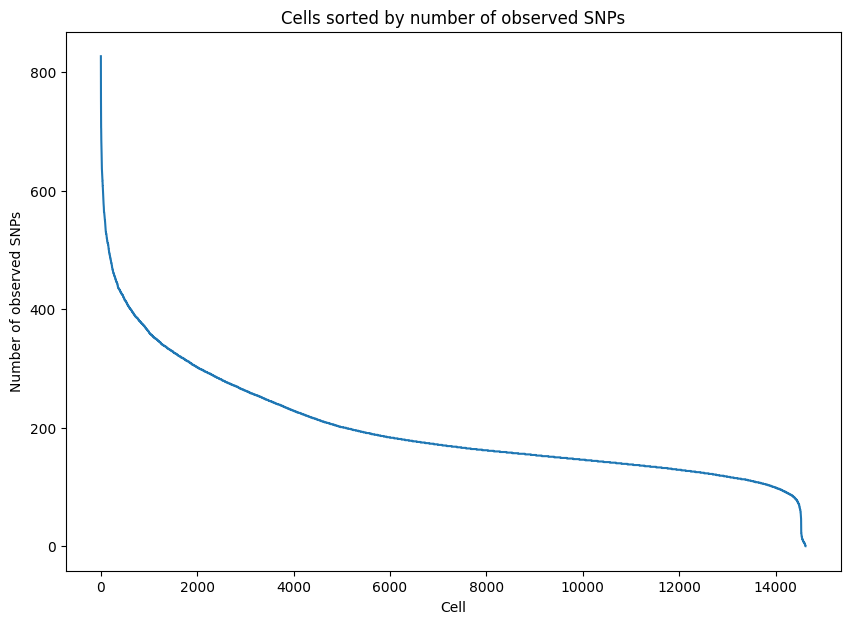

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


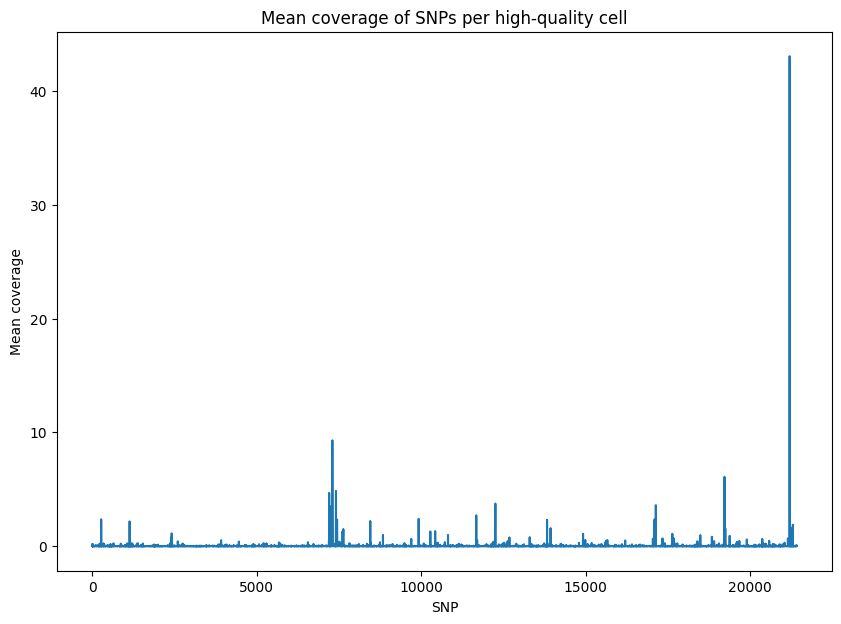

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


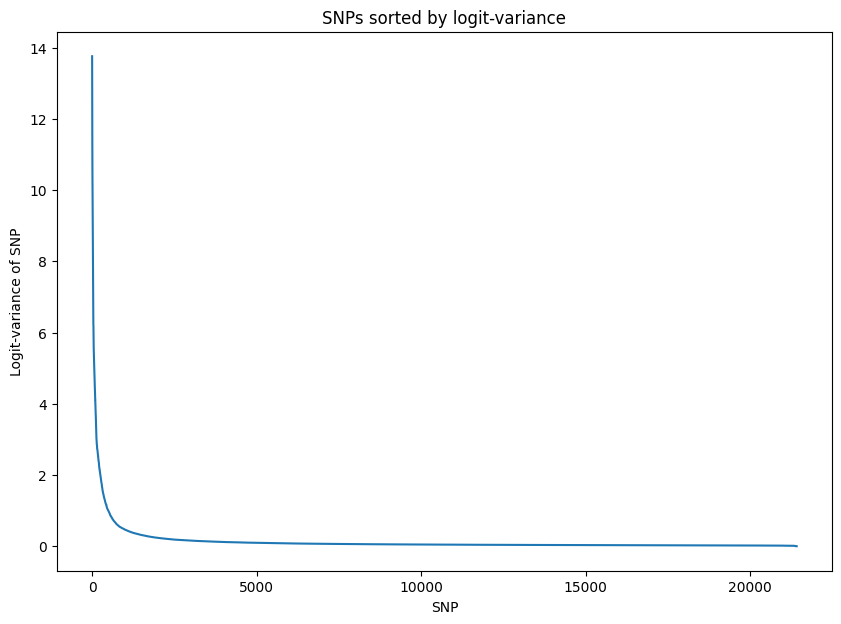

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.224965
Epoch[20/2000], Cost: 0.909119
Epoch[30/2000], Cost: 0.762942
Epoch[40/2000], Cost: 0.713800
Epoch[50/2000], Cost: 0.689800
Epoch[60/2000], Cost: 0.675144
Epoch[70/2000], Cost: 0.663977
Epoch[80/2000], Cost: 0.655205
Epoch[90/2000], Cost: 0.646087
Epoch[100/2000], Cost: 0.637688
Epoch[200/2000], Cost: 0.570256
Epoch[300/2000], Cost: 0.520838
Epoch[400/2000], Cost: 0.483661
Epoch[500/2000], Cost: 0.455487
Epoch[600/2000], Cost: 0.431626
Epoch[700/2000], Cost: 0.415394
Epoch[800/2000], Cost: 0.402043
Epoch[900/2000], Cost: 0.392829
Epoch[1000/2000], Cost: 0.387129
Epoch[1100/2000], Cost: 0.380044
Epoch[1200/2000], Cost: 0.379150
Epoch[1300/2000], Cost: 0.373562
Epoch[1400/2000], Cost: 0.370675
Epoch[1500/2000], Cost: 0.369070
Epoch[1600/20

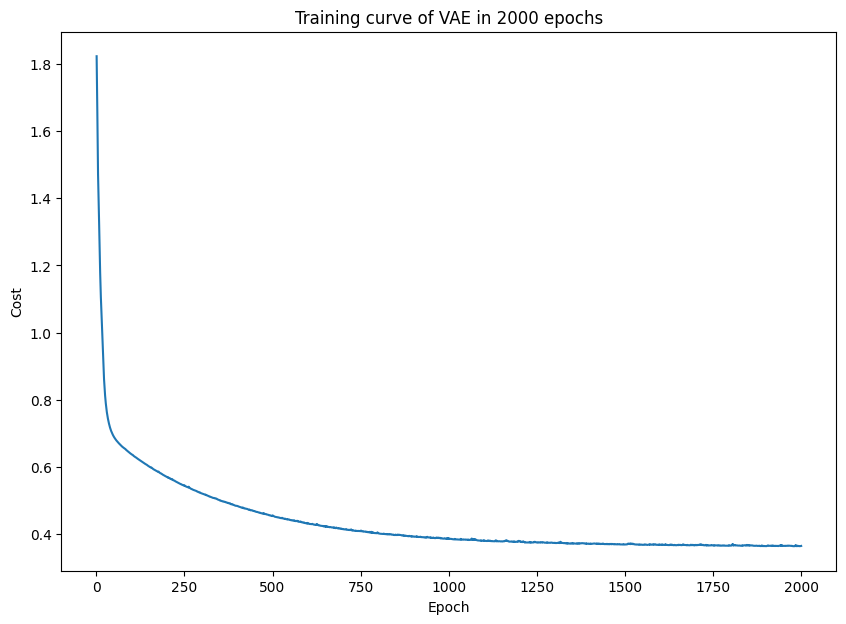

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


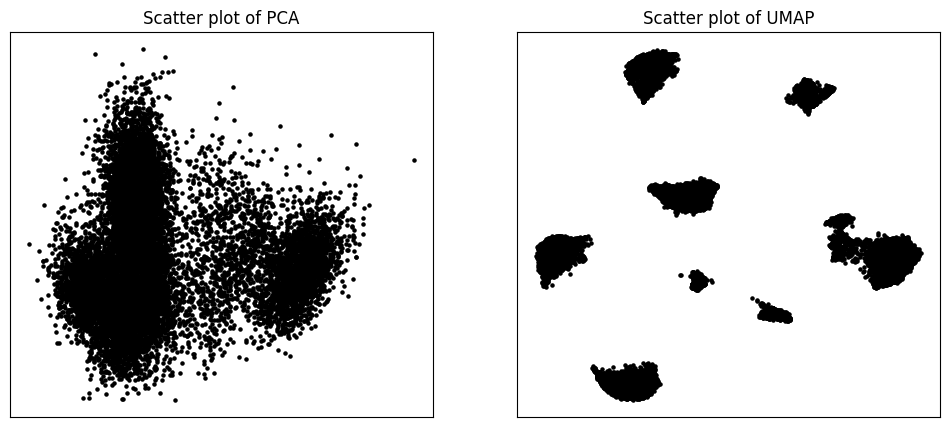

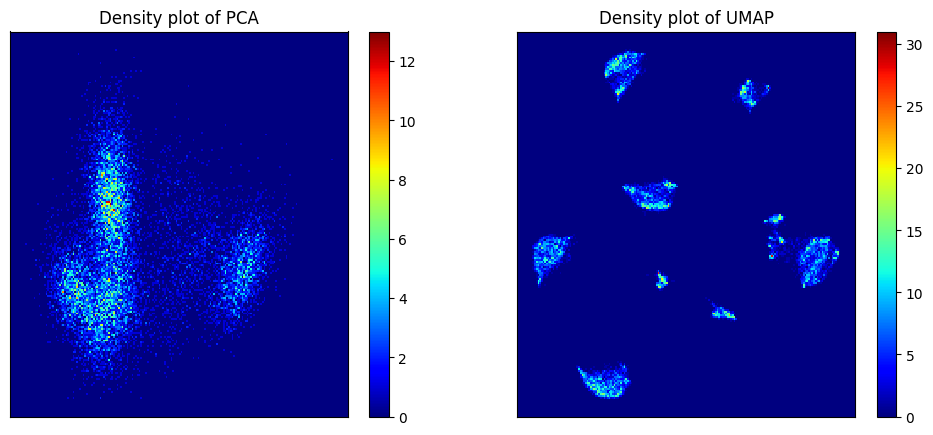

Start clustering.
2 clusters, Distortion: 456533.687500
3 clusters, Distortion: 254880.562500
4 clusters, Distortion: 155448.343750
5 clusters, Distortion: 82076.625000
6 clusters, Distortion: 51938.769531
7 clusters, Distortion: 25744.494141
8 clusters, Distortion: 12591.329102
9 clusters, Distortion: 8962.815430
10 clusters, Distortion: 8020.996094
11 clusters, Distortion: 7818.872559
12 clusters, Distortion: 6778.253906
13 clusters, Distortion: 6040.169922
14 clusters, Distortion: 5634.435059
15 clusters, Distortion: 5138.069824
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


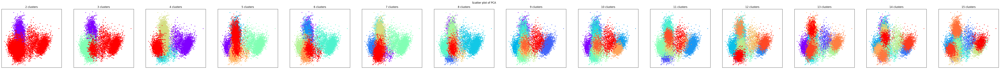

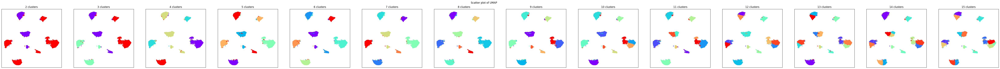

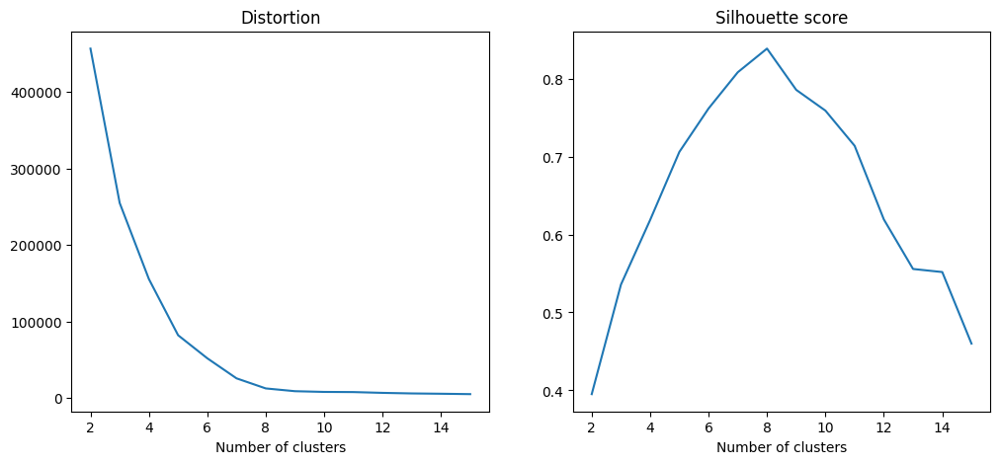

PCA and UMAP of individual clusters will be shown below.


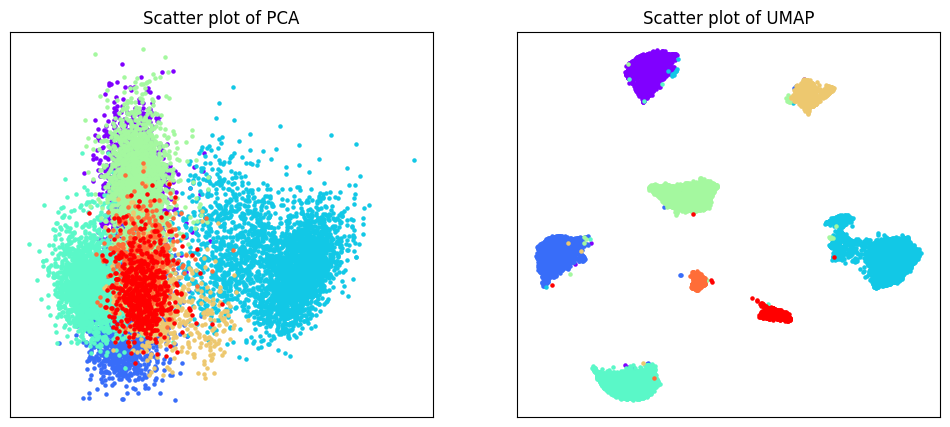

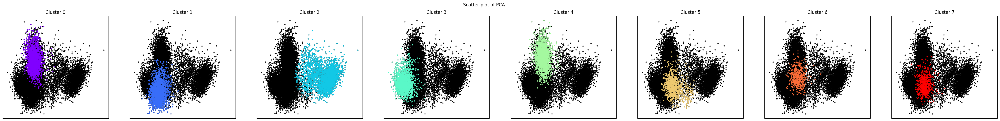

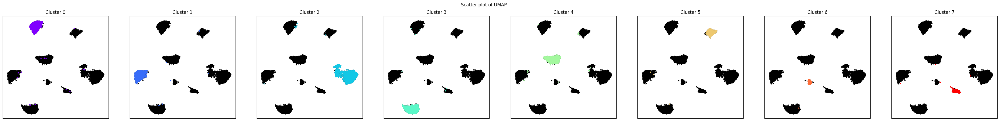

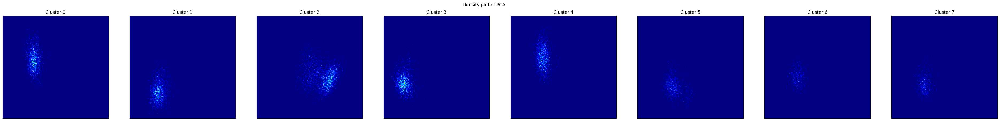

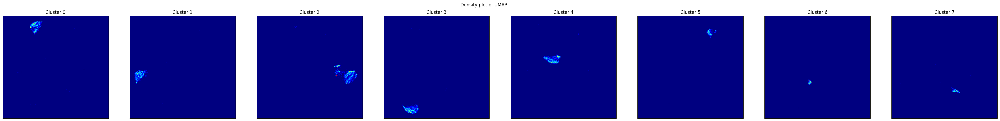

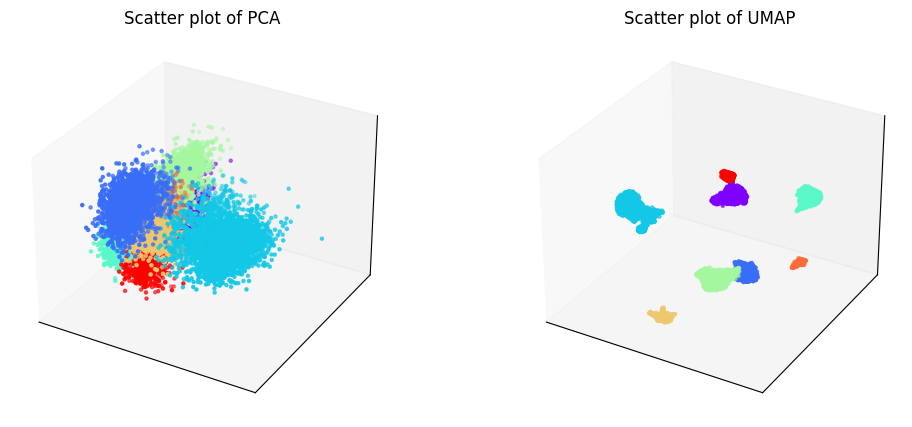

Phylogenetic tree in latent space will be shown below.


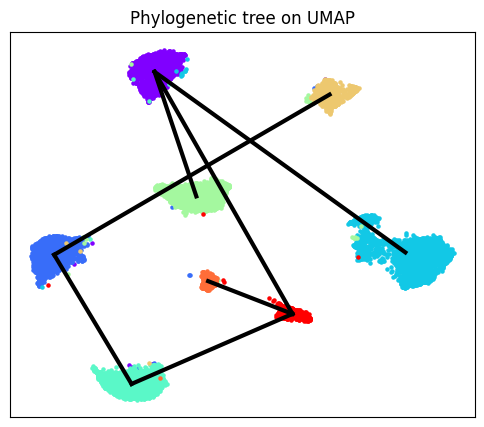

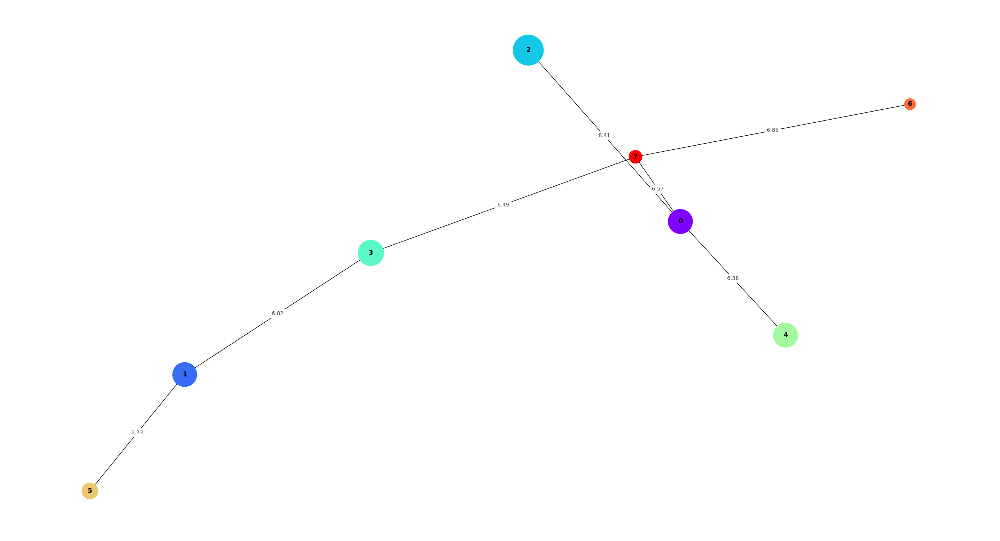

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


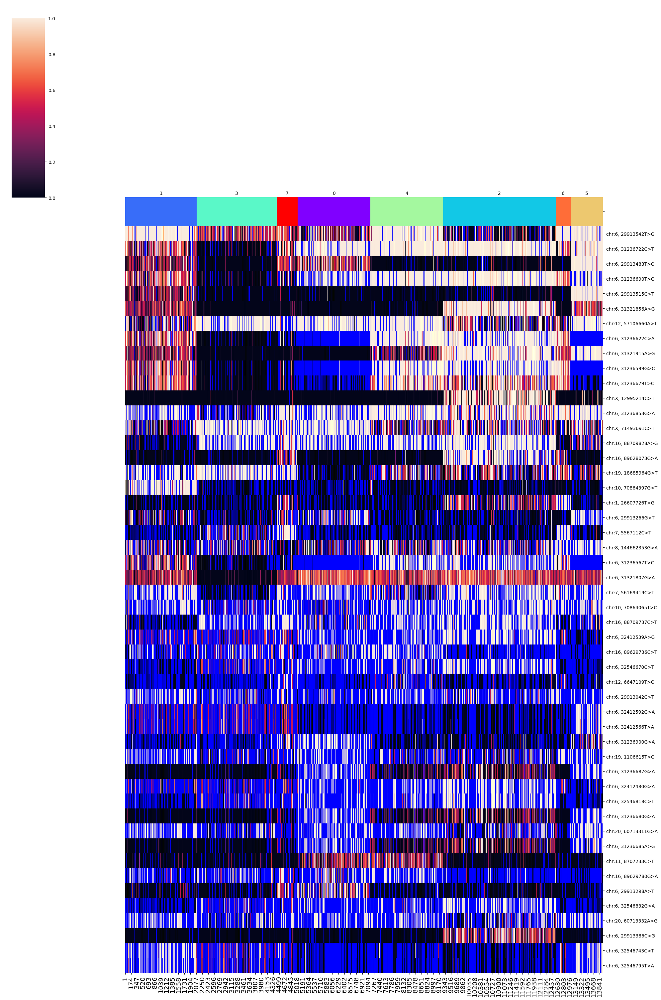

SNPs sorted by lowest p-value will be shown below


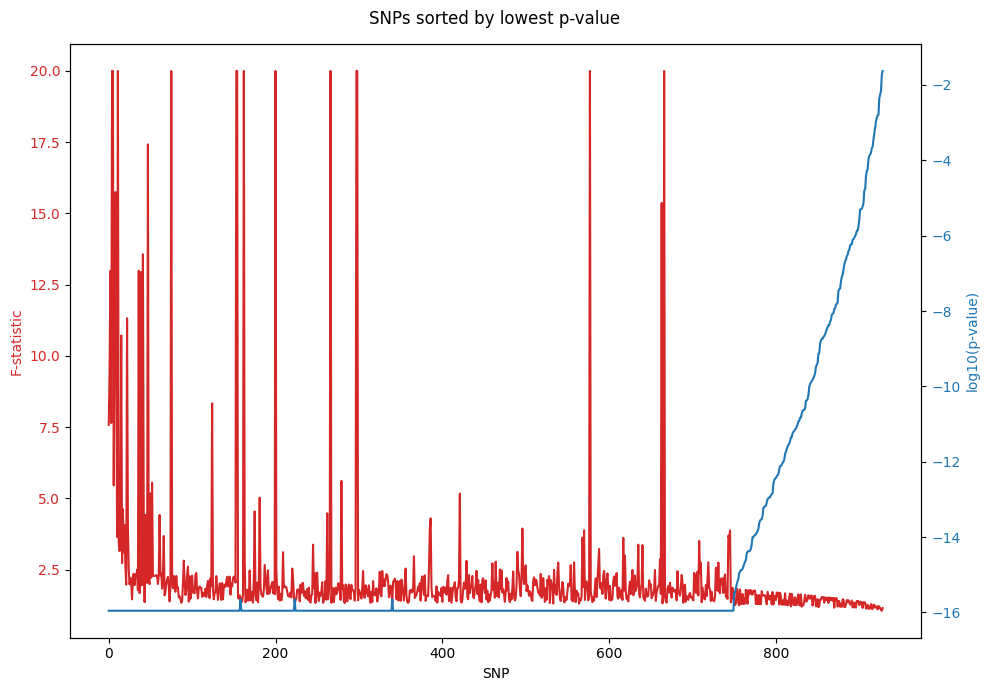

In [5]:
del unnormalized_layer3

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer5_updated.ipynb

unnormalized_layer5 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8", SNPread = "unnormalized")
unnormalized_layer5.filtering()
unnormalized_layer5.training()
unnormalized_layer5.clustering(algorithm = "kmeans_umap3d")
unnormalized_layer5.phylogeny(cluster_no = 8)

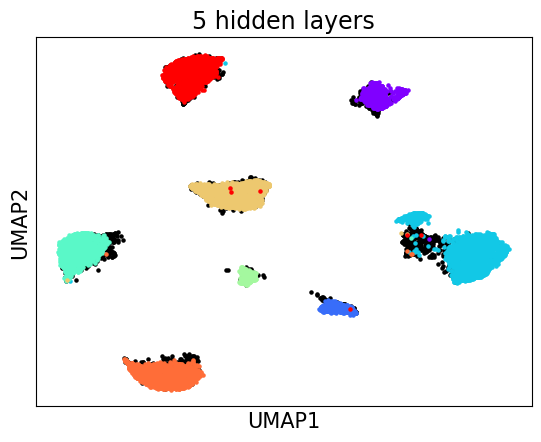

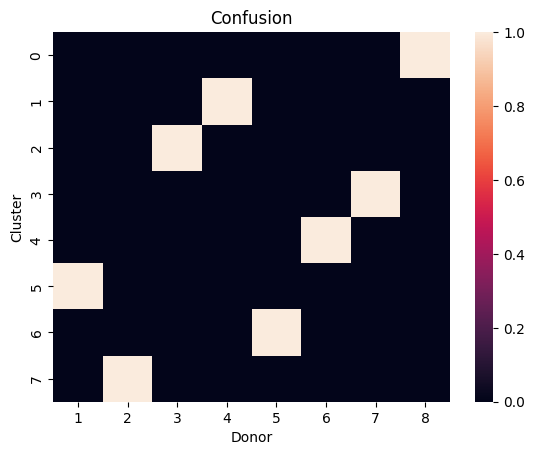

accuracy: 99.83762315764241
silhouette score: 0.8465480737976918


In [6]:
unnormalized_layer5_embedding_2d = unnormalized_layer5.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[unnormalized_layer5.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[unnormalized_layer5.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(unnormalized_layer5.embedding_2d[donors[8], 0], unnormalized_layer5.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(unnormalized_layer5.embedding_2d[donors[w], 0], unnormalized_layer5.embedding_2d[donors[w], 1], s = 5, color = unnormalized_layer5.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("5 hidden layers", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = unnormalized_layer5.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(unnormalized_layer5.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer5.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


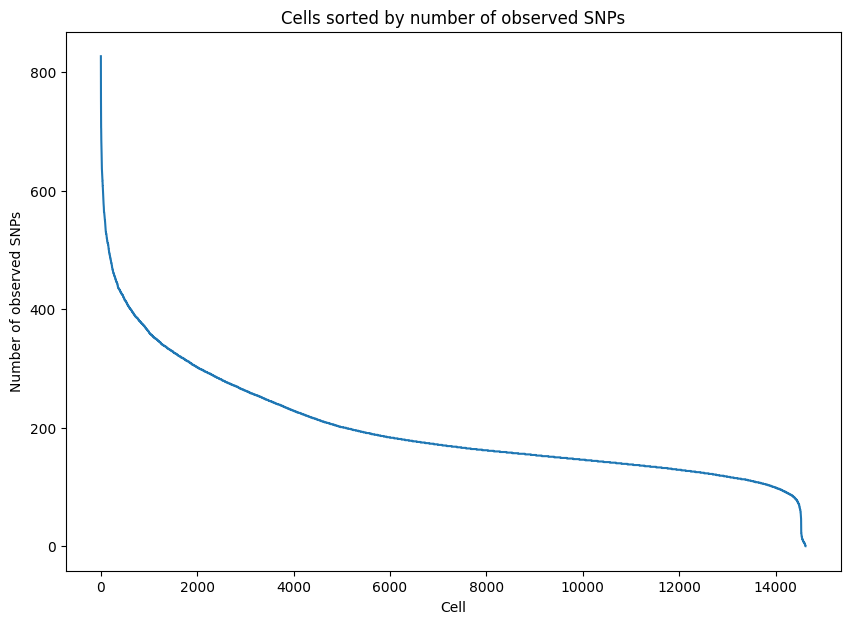

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


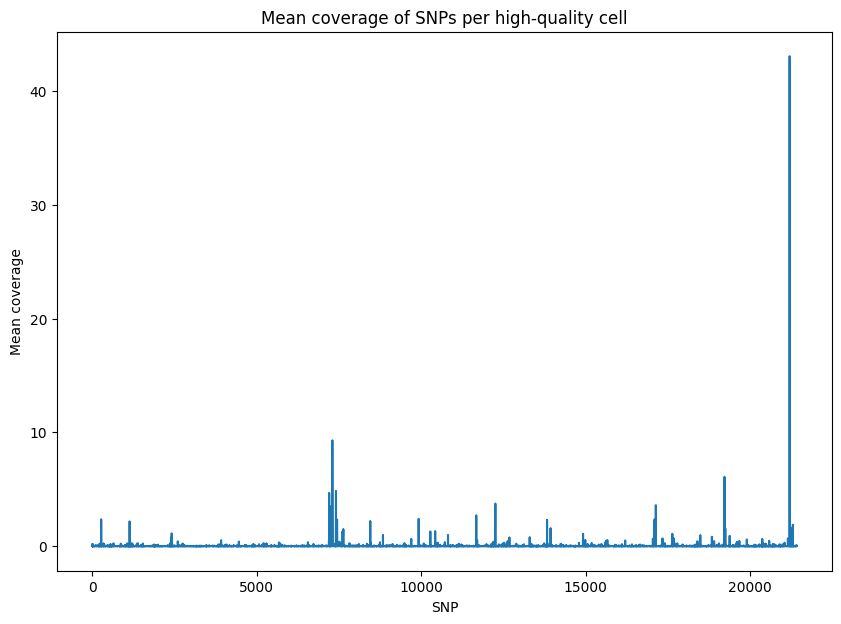

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


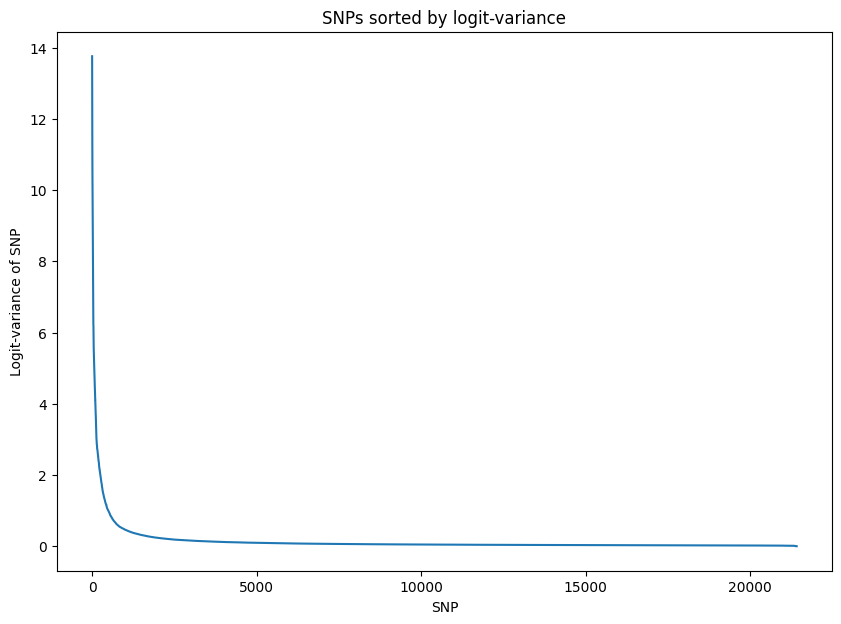

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.621097
Epoch[20/2000], Cost: 1.375123
Epoch[30/2000], Cost: 1.234462
Epoch[40/2000], Cost: 1.137227
Epoch[50/2000], Cost: 1.061890
Epoch[60/2000], Cost: 1.002620
Epoch[70/2000], Cost: 0.957636
Epoch[80/2000], Cost: 0.921851
Epoch[90/2000], Cost: 0.891247
Epoch[100/2000], Cost: 0.865829
Epoch[200/2000], Cost: 0.746111
Epoch[300/2000], Cost: 0.710328
Epoch[400/2000], Cost: 0.692509
Epoch[500/2000], Cost: 0.680999
Epoch[600/2000], Cost: 0.672553
Epoch[700/2000], Cost: 0.665674
Epoch[800/2000], Cost: 0.660049
Epoch[900/2000], Cost: 0.655014
Epoch[1000/2000], Cost: 0.650719
Epoch[1100/2000], Cost: 0.646631
Epoch[1200/2000], Cost: 0.643388
Epoch[1300/2000], Cost: 0.640269
Epoch[1400/2000], Cost: 0.637000
Epoch[1500/2000], Cost: 0.633736
Epoch[1600/20

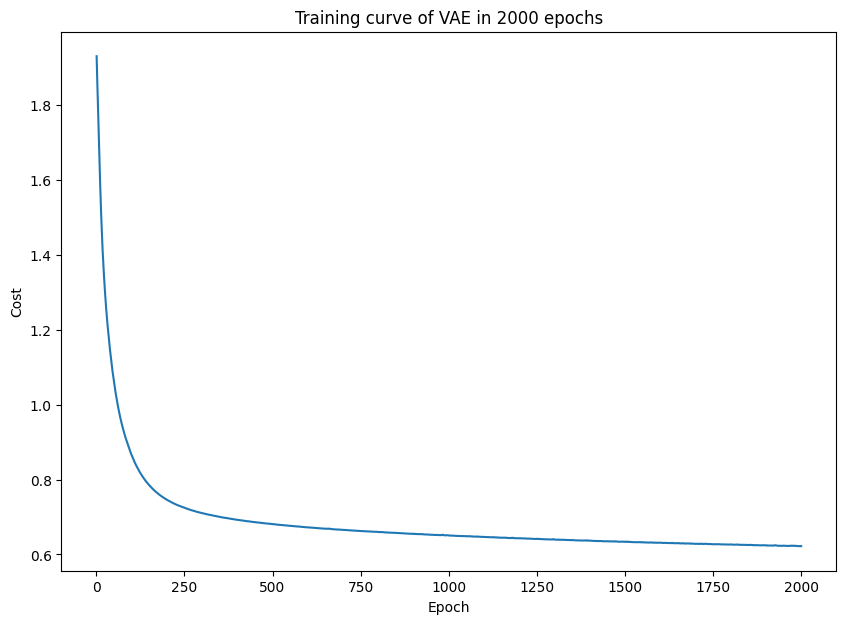

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


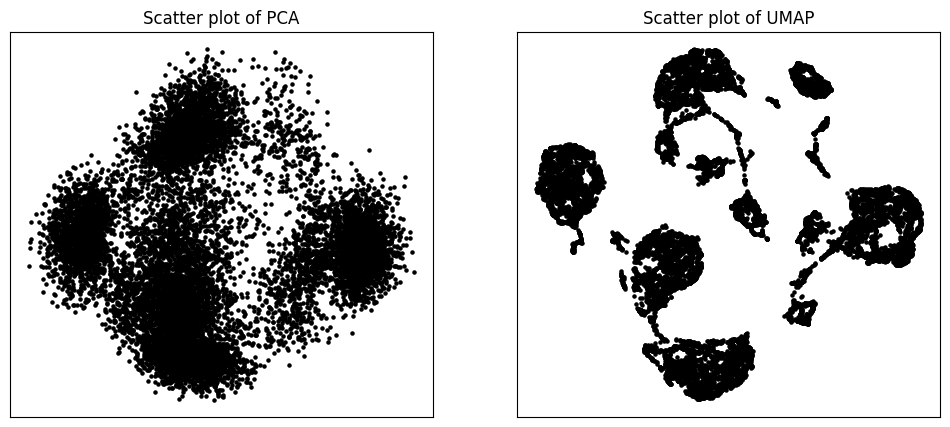

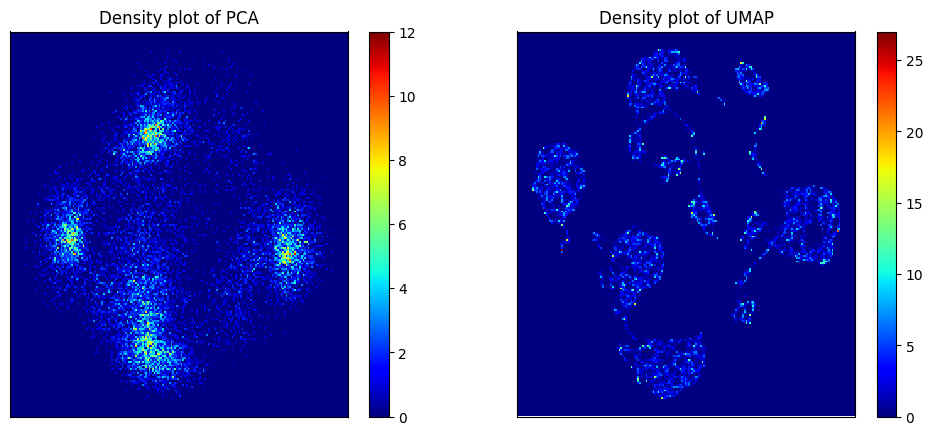

Start clustering.
2 clusters, Distortion: 566271.625000
3 clusters, Distortion: 377791.375000
4 clusters, Distortion: 196799.515625
5 clusters, Distortion: 127324.648438
6 clusters, Distortion: 96133.125000
7 clusters, Distortion: 89402.562500
8 clusters, Distortion: 57498.117188
9 clusters, Distortion: 48097.425781
10 clusters, Distortion: 46052.777344
11 clusters, Distortion: 43161.578125
12 clusters, Distortion: 43523.613281
13 clusters, Distortion: 36047.867188
14 clusters, Distortion: 30646.943359
15 clusters, Distortion: 29225.703125
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


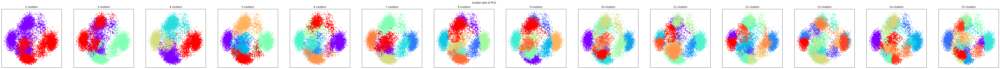

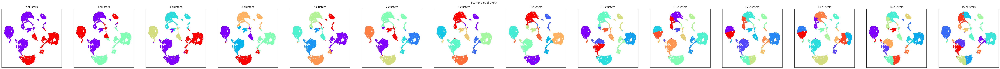

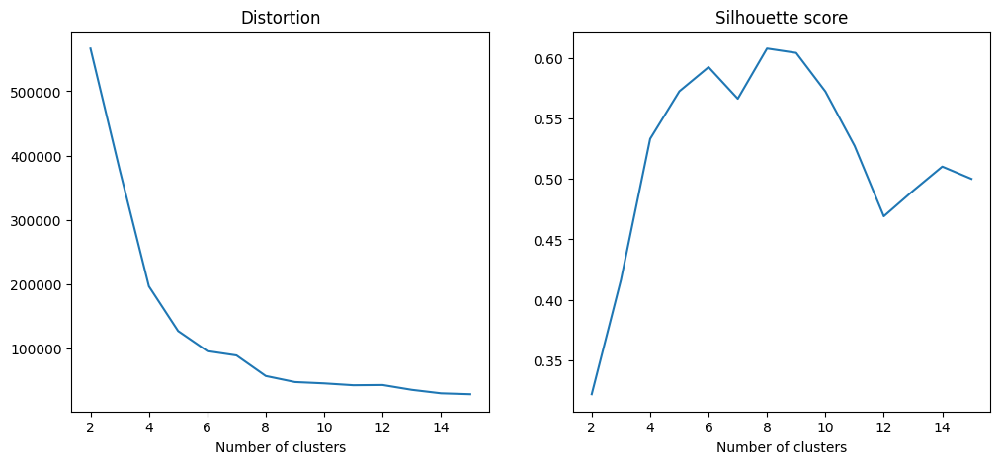

PCA and UMAP of individual clusters will be shown below.


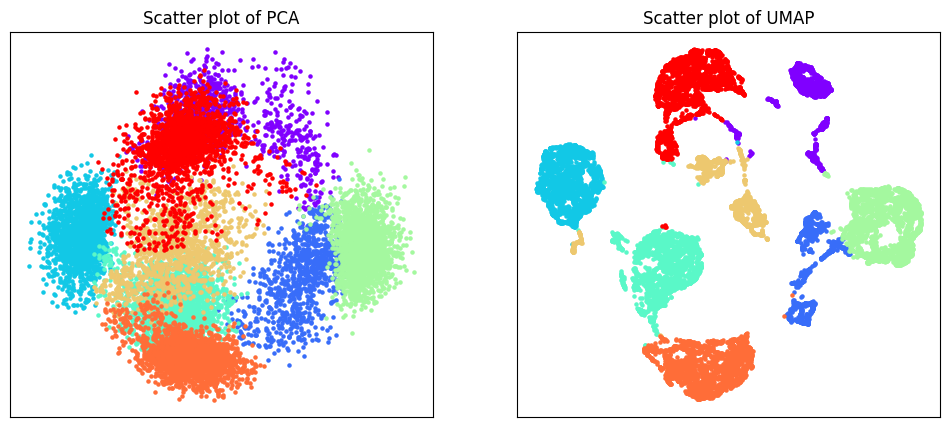

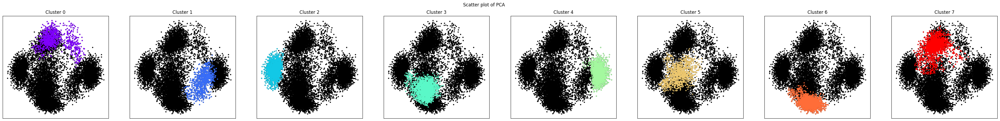

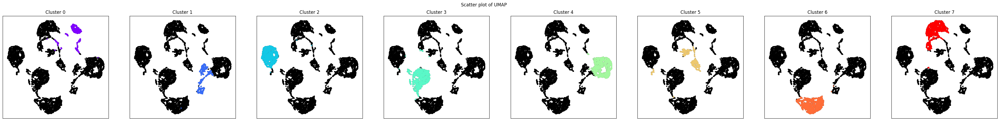

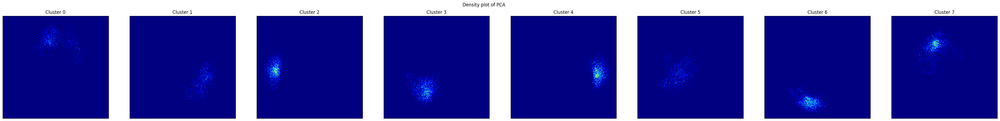

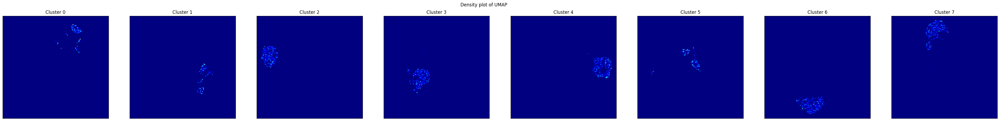

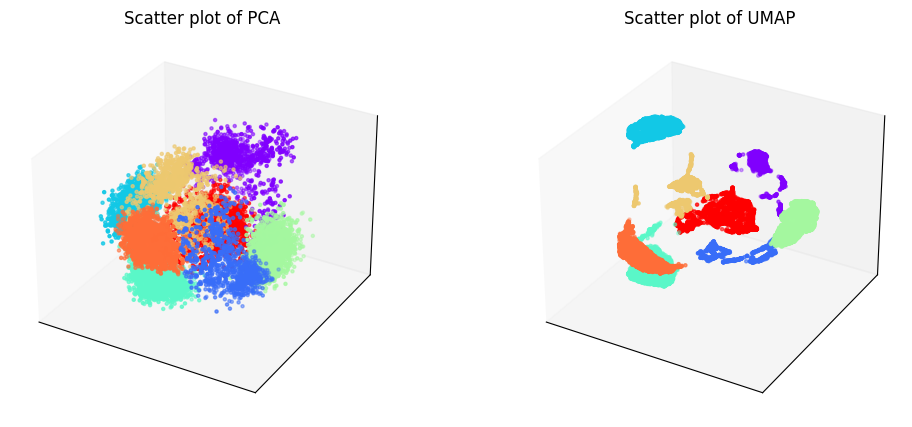

Phylogenetic tree in latent space will be shown below.


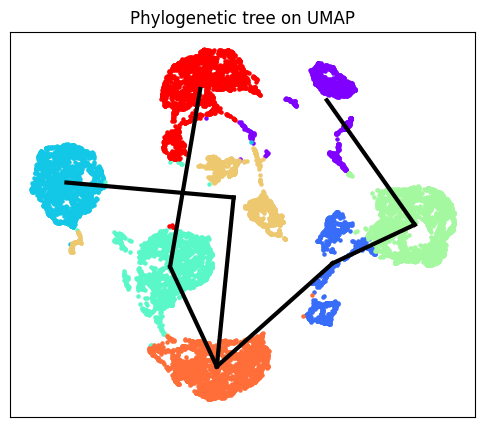

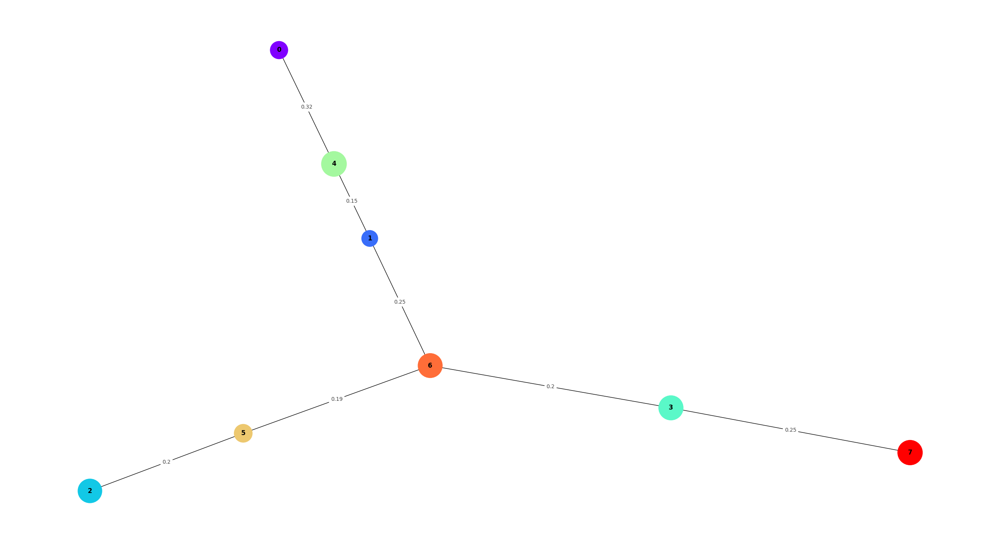

ValueError: could not broadcast input array from shape (3,) into shape (465,)

In [7]:
del unnormalized_layer5

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-bmVAE_updated.ipynb

bmVAE = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8", SNPread = "unnormalized")
bmVAE.filtering()
bmVAE.training(beta = 0.0001)
bmVAE.clustering(algorithm = "kmeans_umap3d")
bmVAE.phylogeny(cluster_no = 8)

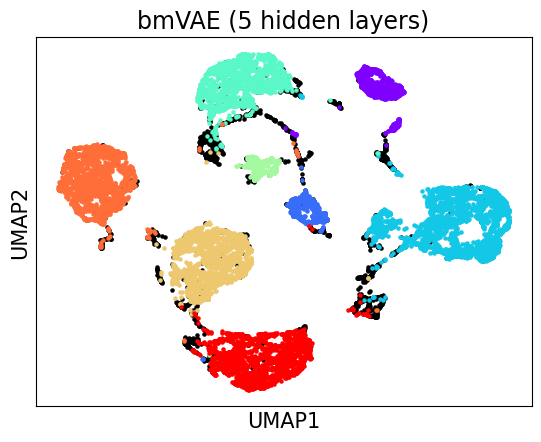

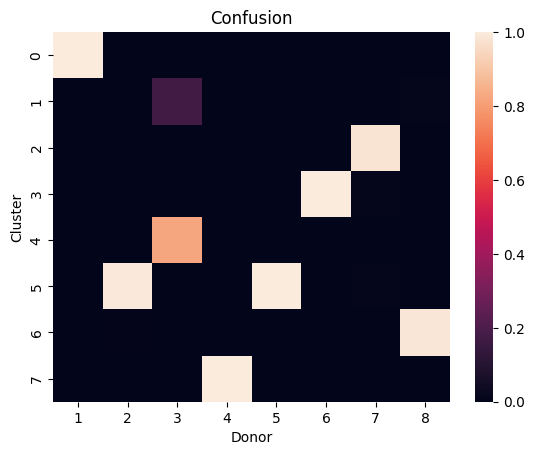

accuracy: 97.18174884251857
silhouette score: 0.6848590899421166


In [8]:
bmVAE_embedding_2d = bmVAE.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[bmVAE.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[bmVAE.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(bmVAE.embedding_2d[donors[8], 0], bmVAE.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(bmVAE.embedding_2d[donors[w], 0], bmVAE.embedding_2d[donors[w], 1], s = 5, color = bmVAE.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE (5 hidden layers)", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = bmVAE.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(bmVAE.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(bmVAE.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


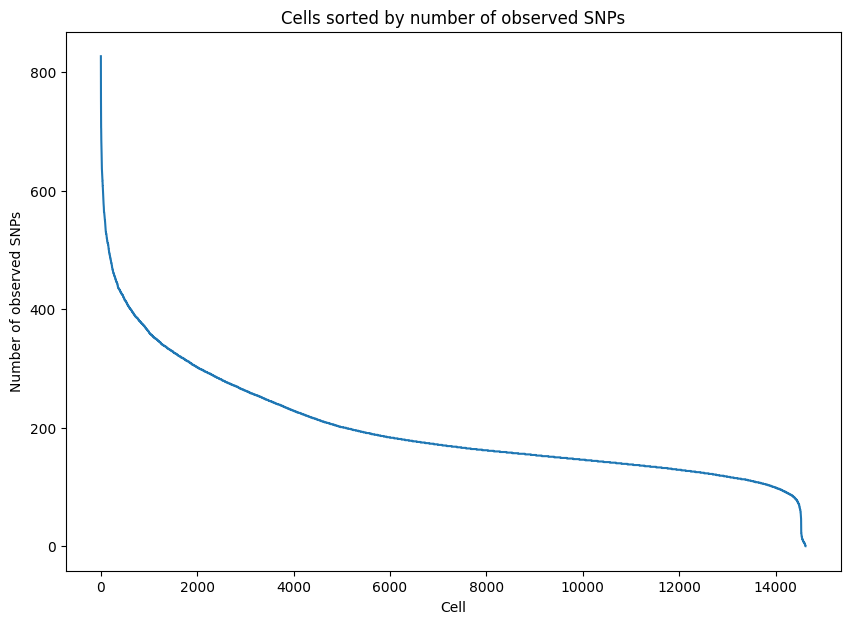

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


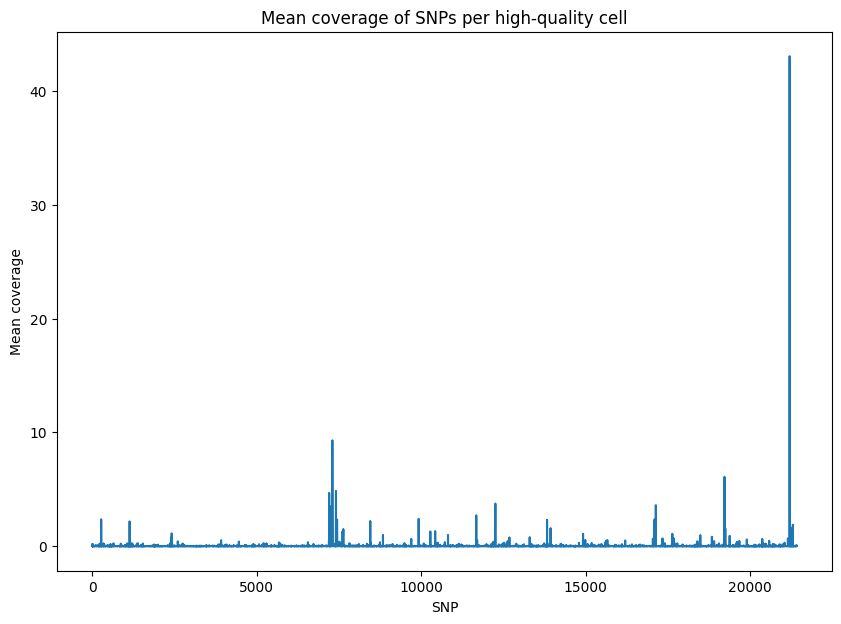

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


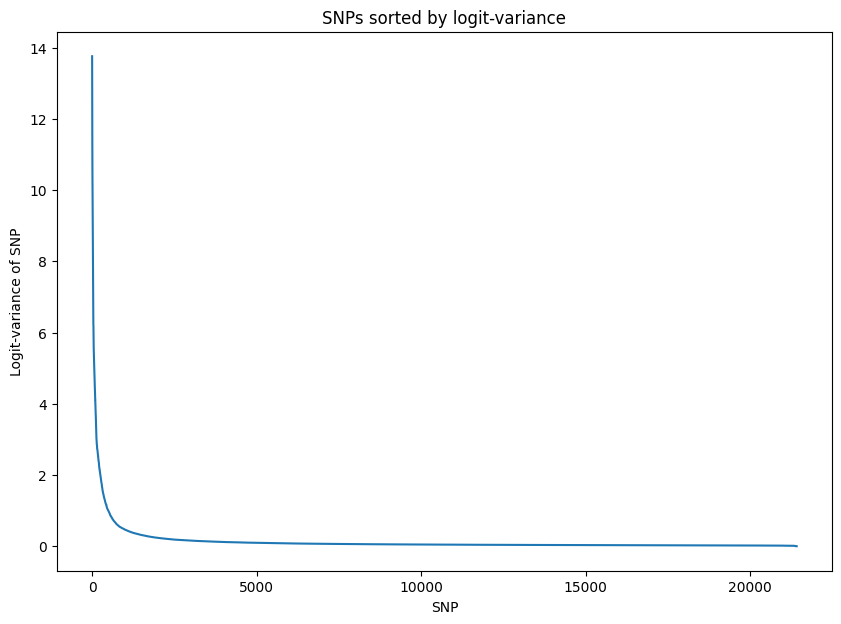

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.593756
Epoch[20/2000], Cost: 1.340339
Epoch[30/2000], Cost: 1.204226
Epoch[40/2000], Cost: 1.113199
Epoch[50/2000], Cost: 1.045909
Epoch[60/2000], Cost: 0.996076
Epoch[70/2000], Cost: 0.956446
Epoch[80/2000], Cost: 0.924477
Epoch[90/2000], Cost: 0.897662
Epoch[100/2000], Cost: 0.875788
Epoch[200/2000], Cost: 0.771195
Epoch[300/2000], Cost: 0.734837
Epoch[400/2000], Cost: 0.716605
Epoch[500/2000], Cost: 0.704109
Epoch[600/2000], Cost: 0.695596
Epoch[700/2000], Cost: 0.688301
Epoch[800/2000], Cost: 0.682349
Epoch[900/2000], Cost: 0.678750
Epoch[1000/2000], Cost: 0.673799
Epoch[1100/2000], Cost: 0.668960
Epoch[1200/2000], Cost: 0.664949
Epoch[1300/2000], Cost: 0.659977
Epoch[1400/2000], Cost: 0.655549
Epoch[1500/2000], Cost: 0.650473
Epoch[1600/20

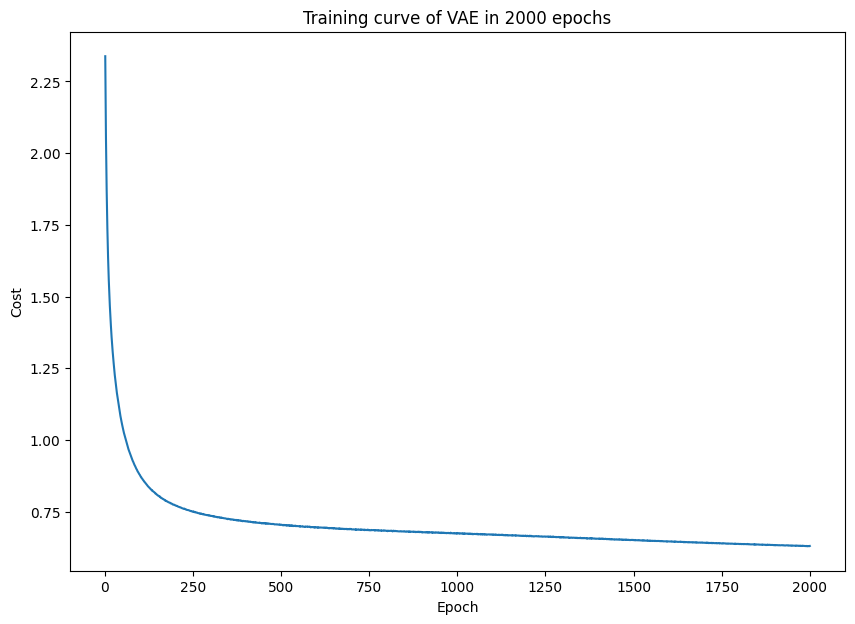

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


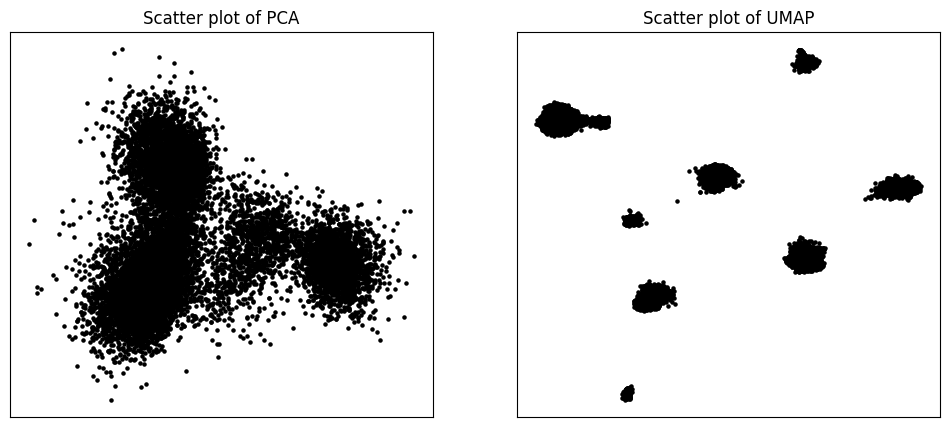

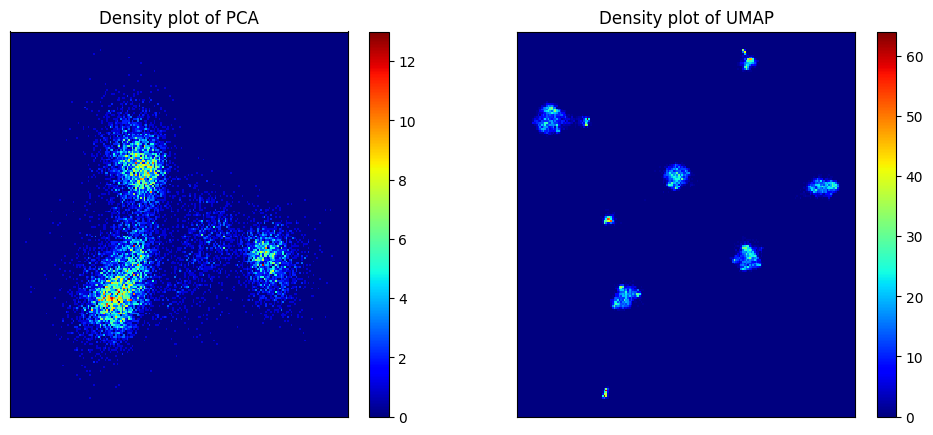

Start clustering.
2 clusters, Distortion: 415504.031250
3 clusters, Distortion: 288009.250000
4 clusters, Distortion: 180090.484375
5 clusters, Distortion: 98710.281250
6 clusters, Distortion: 40815.253906
7 clusters, Distortion: 22467.679688
8 clusters, Distortion: 5659.773926
9 clusters, Distortion: 4161.618164
10 clusters, Distortion: 3864.948730
11 clusters, Distortion: 3595.403809
12 clusters, Distortion: 3274.347656
13 clusters, Distortion: 3016.452637
14 clusters, Distortion: 2613.772949
15 clusters, Distortion: 2452.937256
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


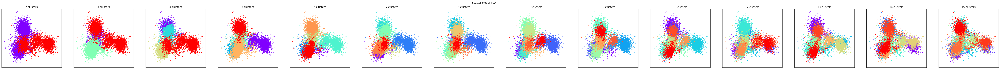

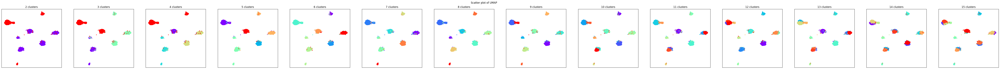

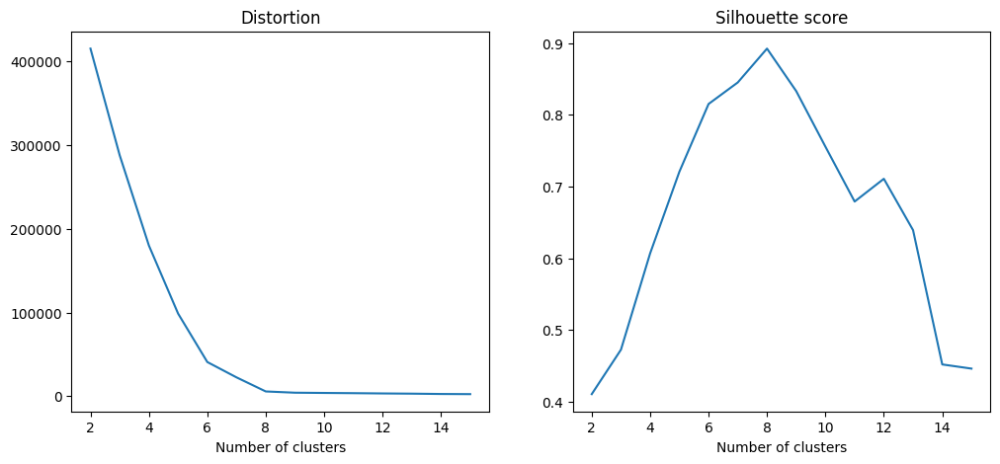

PCA and UMAP of individual clusters will be shown below.


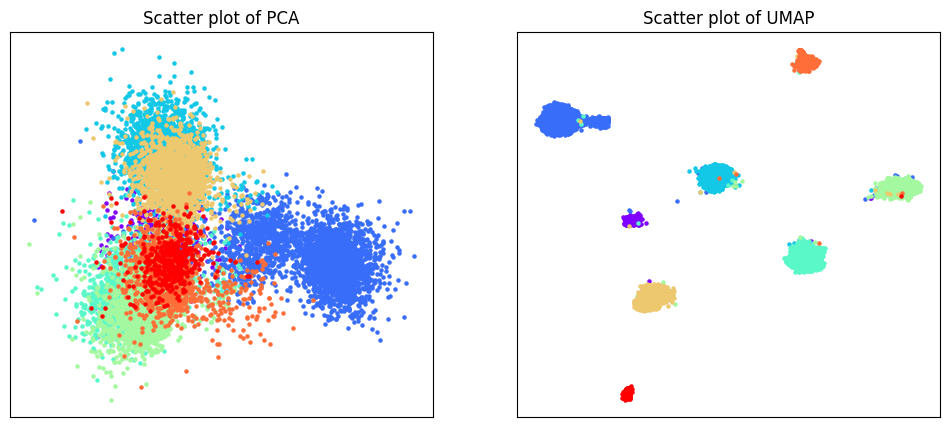

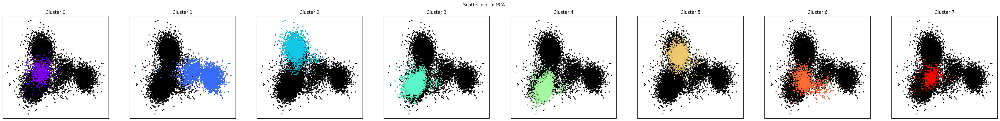

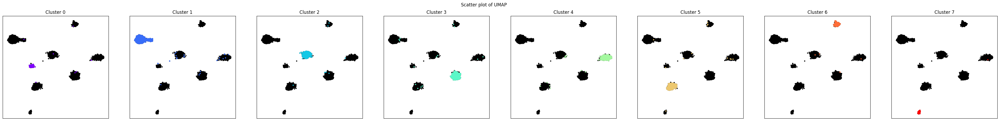

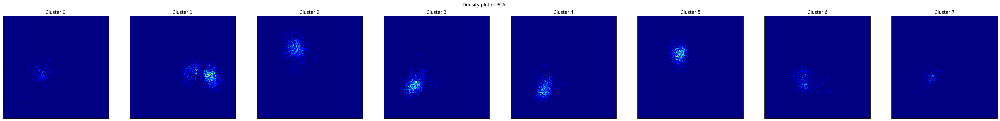

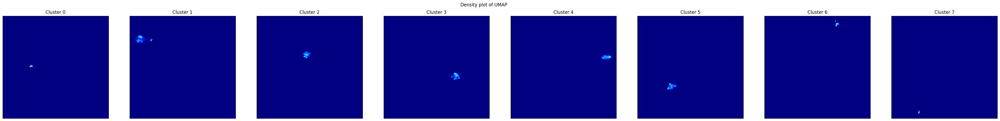

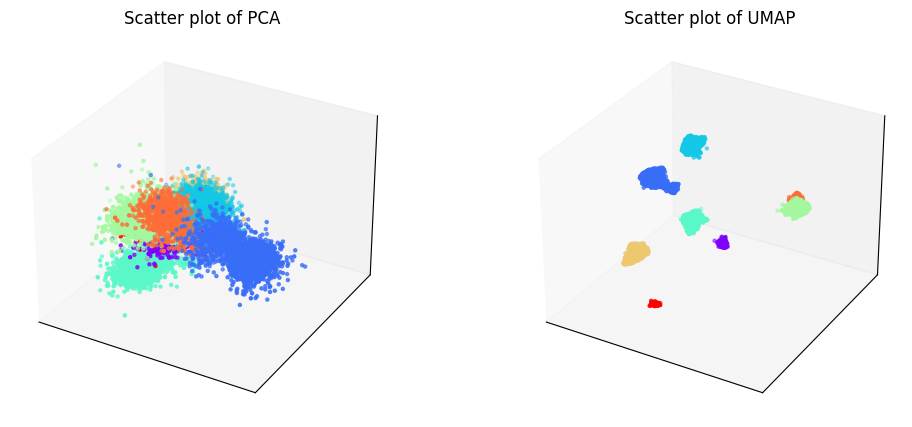

Phylogenetic tree in latent space will be shown below.


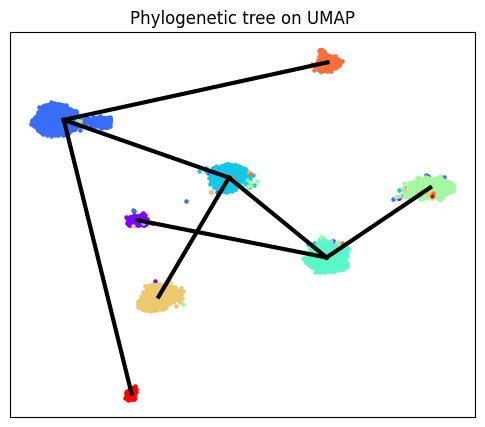

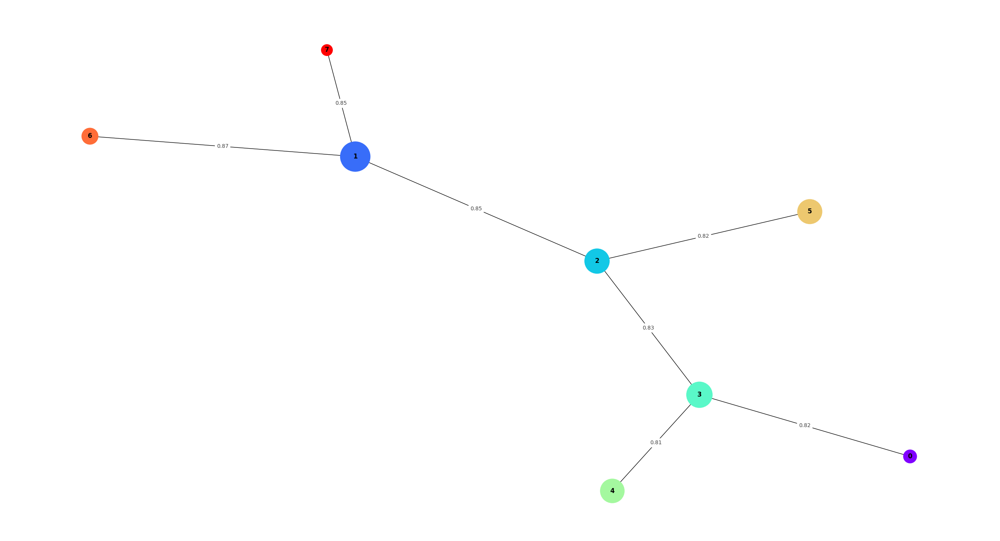

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


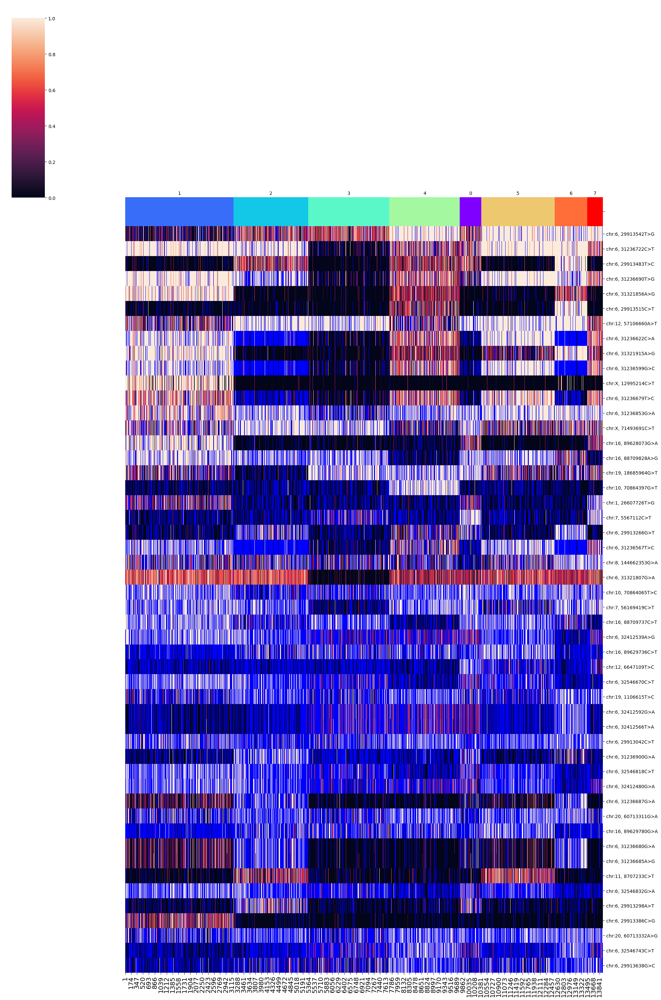

SNPs sorted by lowest p-value will be shown below


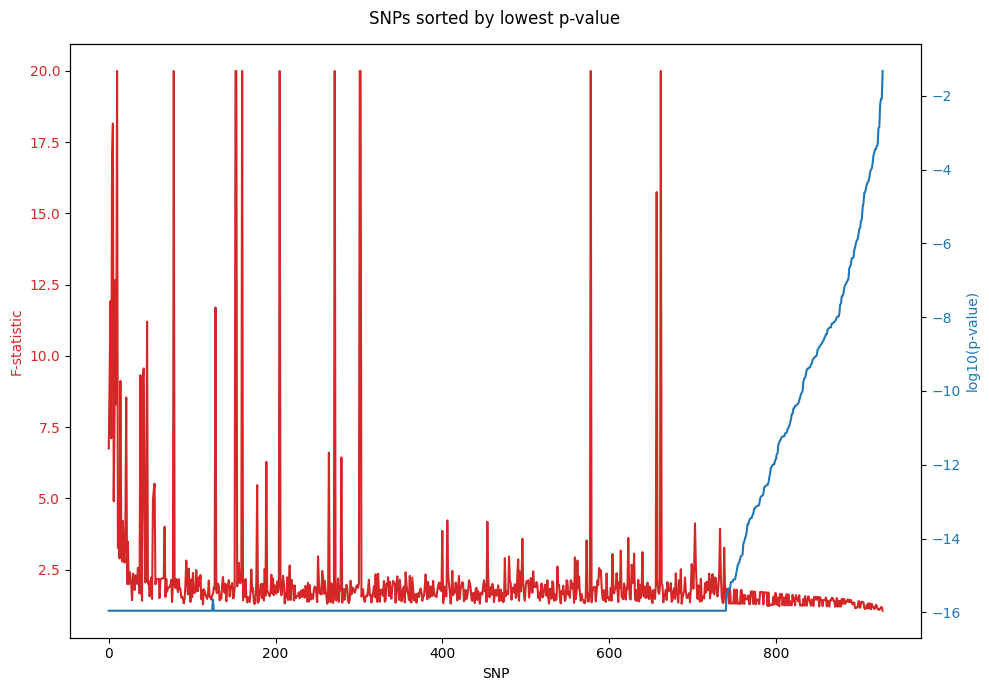

In [9]:
del bmVAE

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_05 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
b_05.filtering()
b_05.training(beta = 0.5)
b_05.clustering(algorithm = "kmeans_umap3d")
b_05.phylogeny(cluster_no = 8)

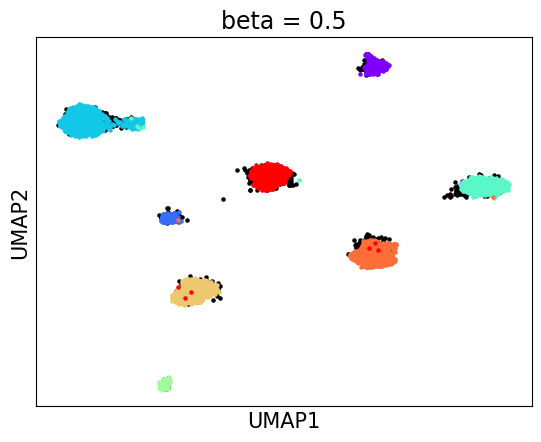

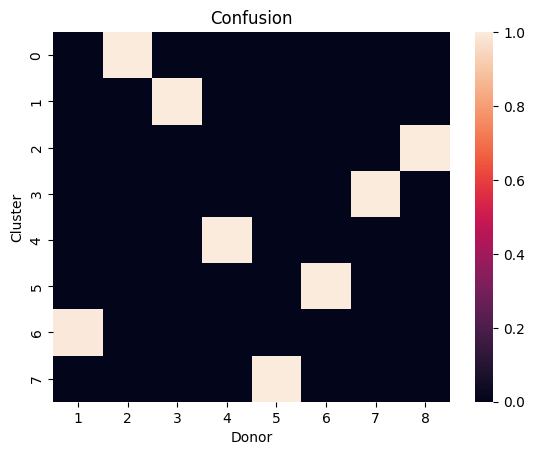

accuracy: 99.8378285267312
silhouette score: 0.8887506620130886


In [10]:
b_05_embedding_2d = b_05.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[b_05.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[b_05.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(b_05.embedding_2d[donors[8], 0], b_05.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(b_05.embedding_2d[donors[w], 0], b_05.embedding_2d[donors[w], 1], s = 5, color = b_05.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 0.5", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = b_05.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(b_05.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_05.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


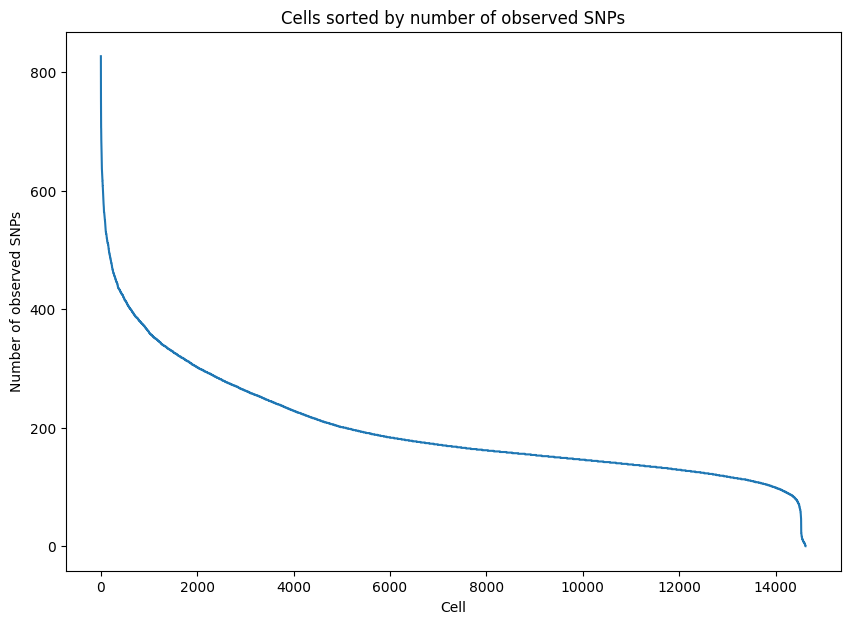

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


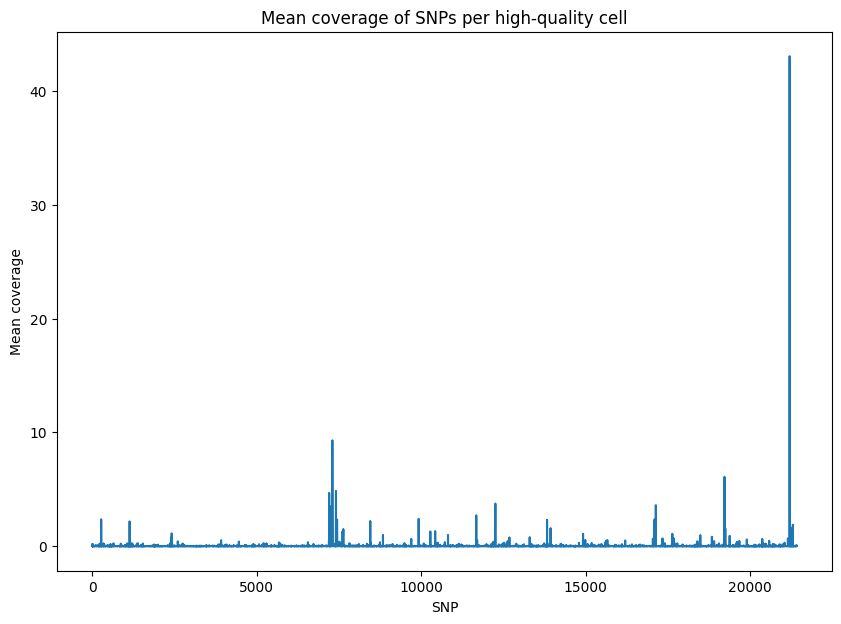

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


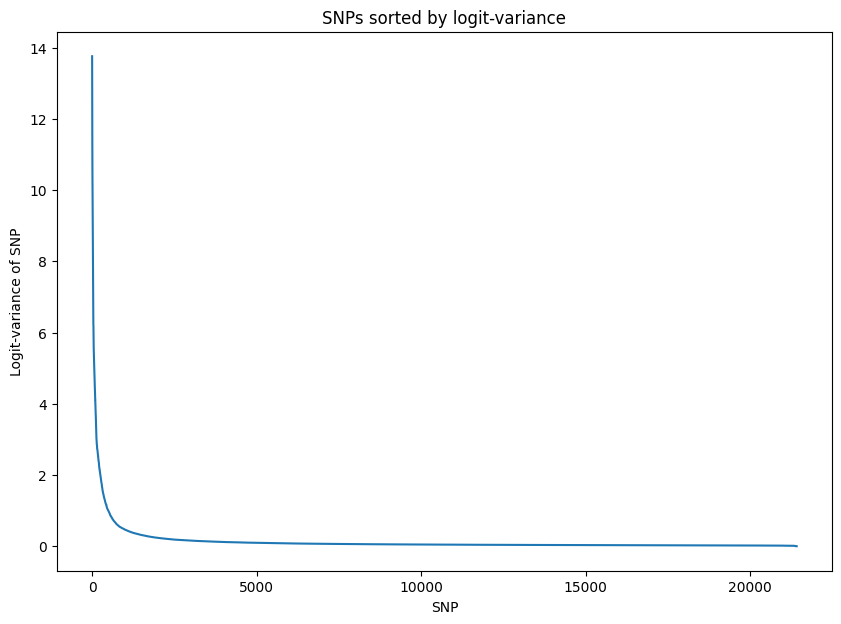

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.890342
Epoch[20/2000], Cost: 1.579682
Epoch[30/2000], Cost: 1.398950
Epoch[40/2000], Cost: 1.274182
Epoch[50/2000], Cost: 1.184527
Epoch[60/2000], Cost: 1.116225
Epoch[70/2000], Cost: 1.064097
Epoch[80/2000], Cost: 1.026056
Epoch[90/2000], Cost: 0.994987
Epoch[100/2000], Cost: 0.968431
Epoch[200/2000], Cost: 0.864288
Epoch[300/2000], Cost: 0.832991
Epoch[400/2000], Cost: 0.816993
Epoch[500/2000], Cost: 0.808716
Epoch[600/2000], Cost: 0.801296
Epoch[700/2000], Cost: 0.795333
Epoch[800/2000], Cost: 0.792398
Epoch[900/2000], Cost: 0.787975
Epoch[1000/2000], Cost: 0.783226
Epoch[1100/2000], Cost: 0.779595
Epoch[1200/2000], Cost: 0.773037
Epoch[1300/2000], Cost: 0.767057
Epoch[1400/2000], Cost: 0.760710
Epoch[1500/2000], Cost: 0.755172
Epoch[1600/20

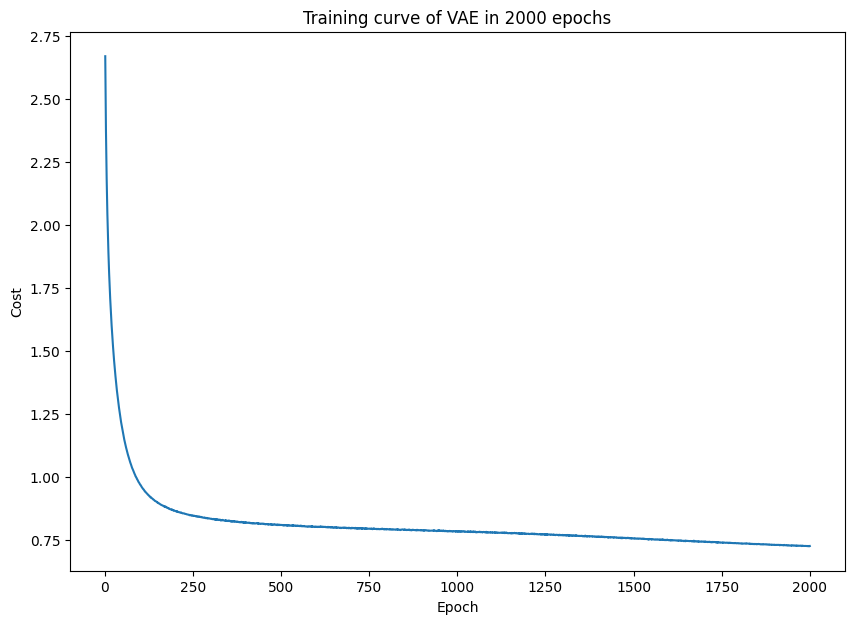

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


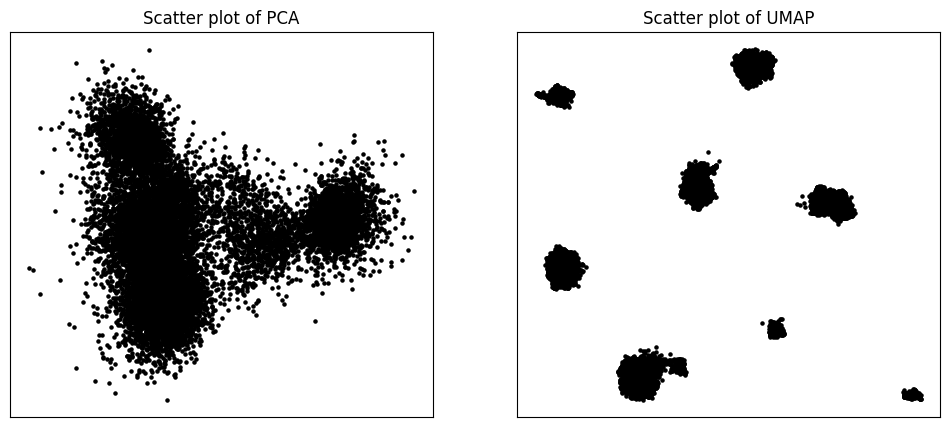

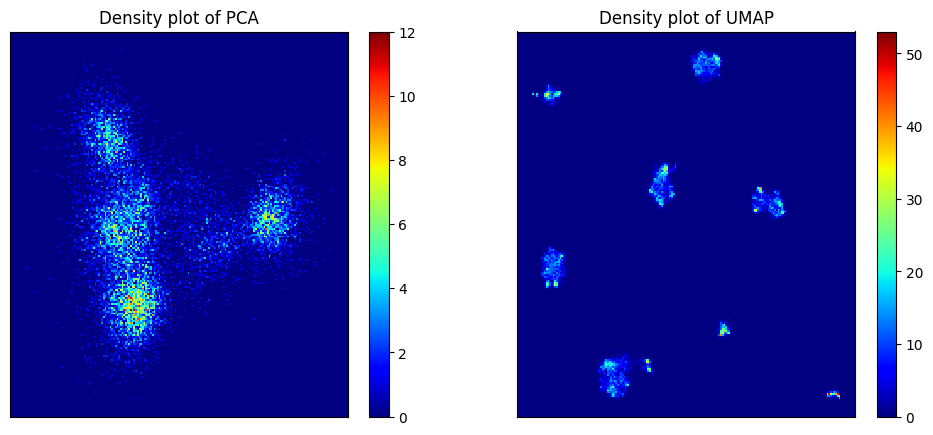

Start clustering.
2 clusters, Distortion: 447185.312500
3 clusters, Distortion: 278538.656250
4 clusters, Distortion: 222983.515625
5 clusters, Distortion: 154741.875000
6 clusters, Distortion: 75571.695312
7 clusters, Distortion: 17642.947266
8 clusters, Distortion: 6939.490234
9 clusters, Distortion: 5267.757324
10 clusters, Distortion: 4925.681152
11 clusters, Distortion: 4147.727051
12 clusters, Distortion: 3818.000488
13 clusters, Distortion: 3579.404541
14 clusters, Distortion: 3088.642578
15 clusters, Distortion: 2882.126709
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


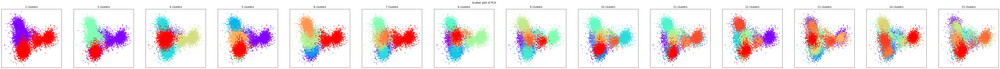

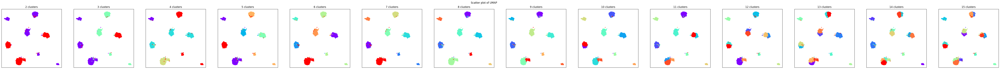

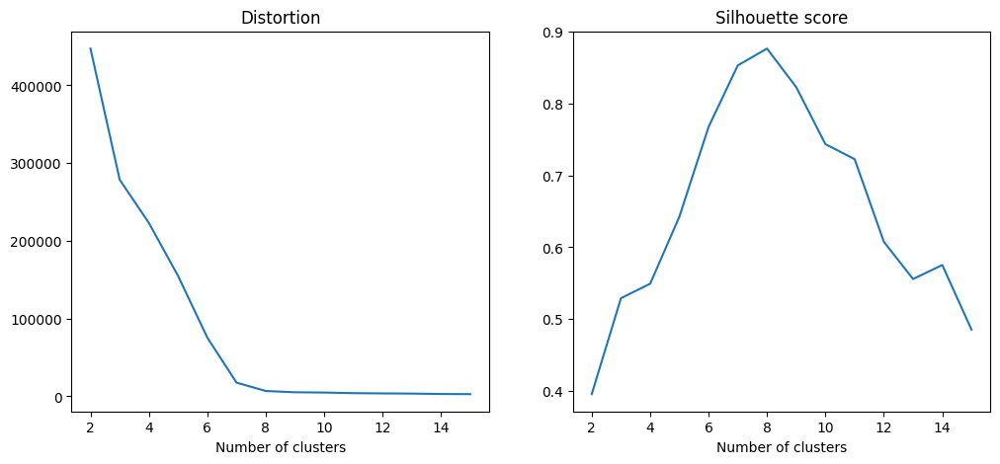

PCA and UMAP of individual clusters will be shown below.


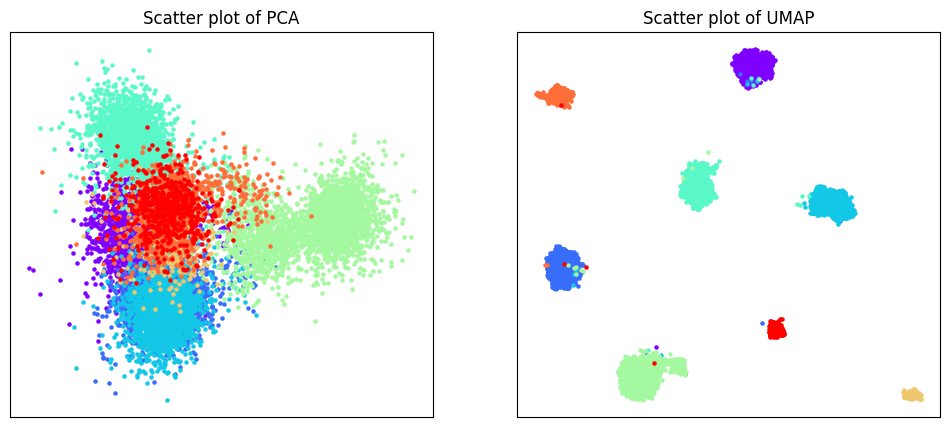

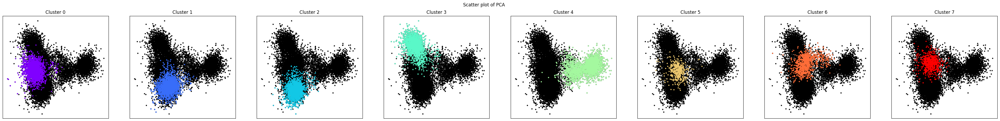

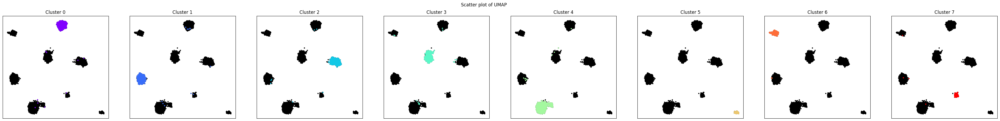

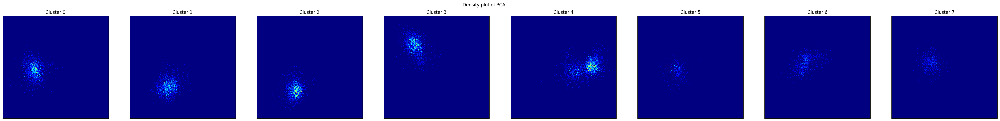

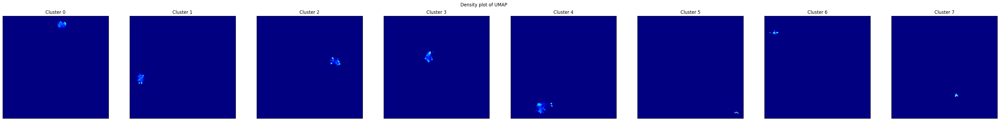

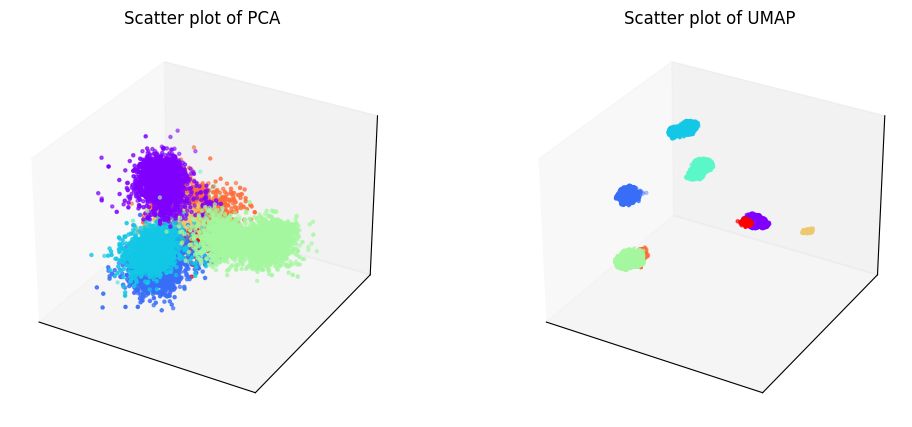

Phylogenetic tree in latent space will be shown below.


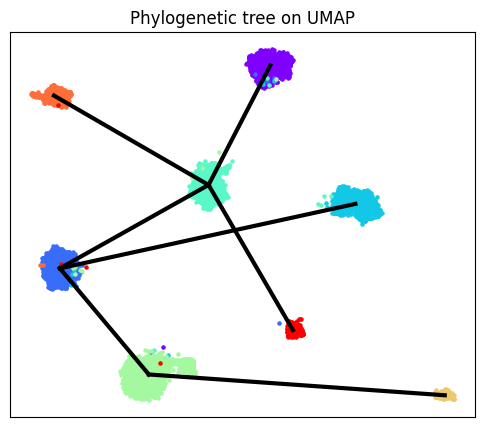

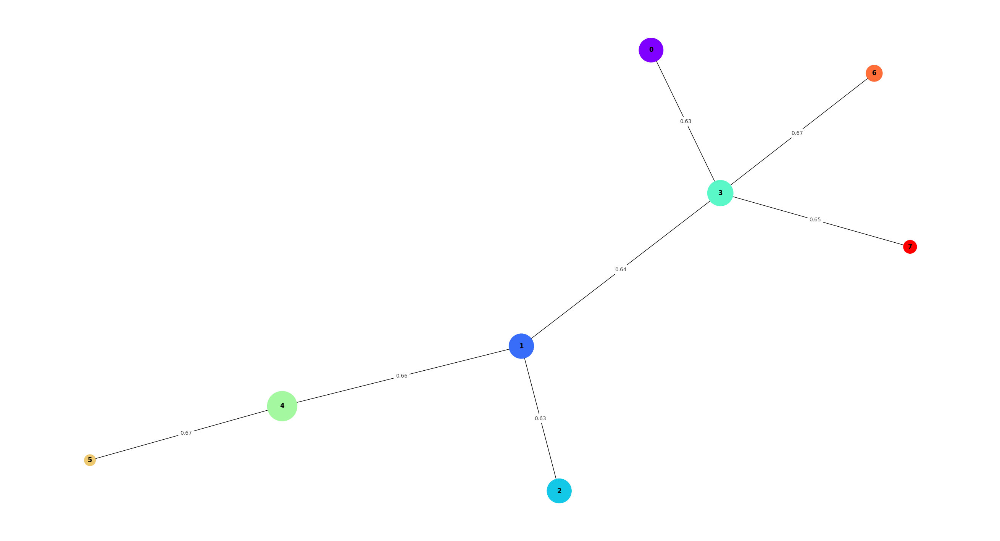

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


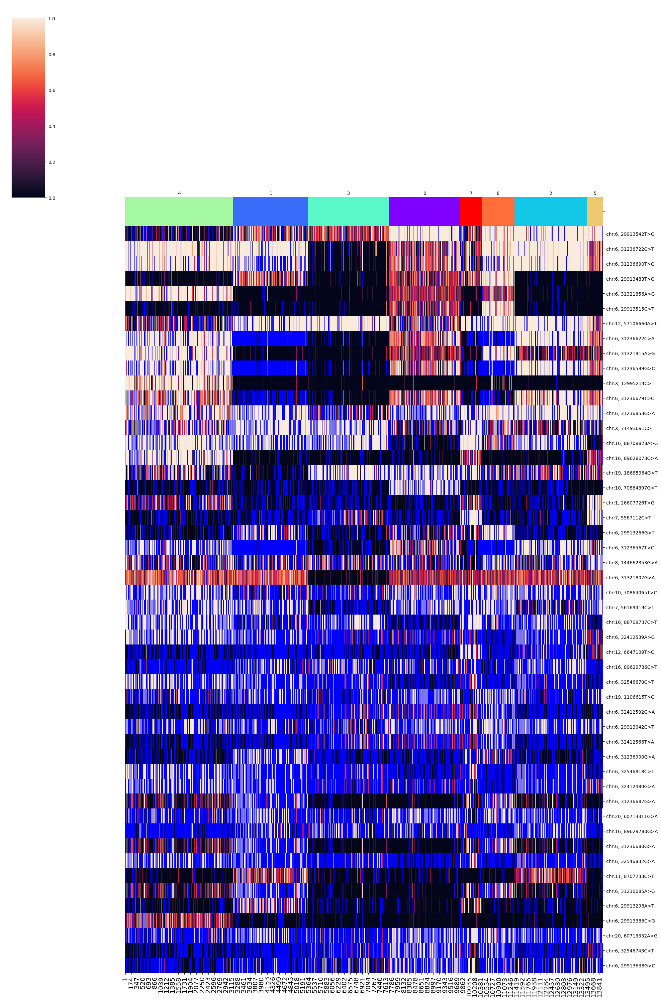

SNPs sorted by lowest p-value will be shown below


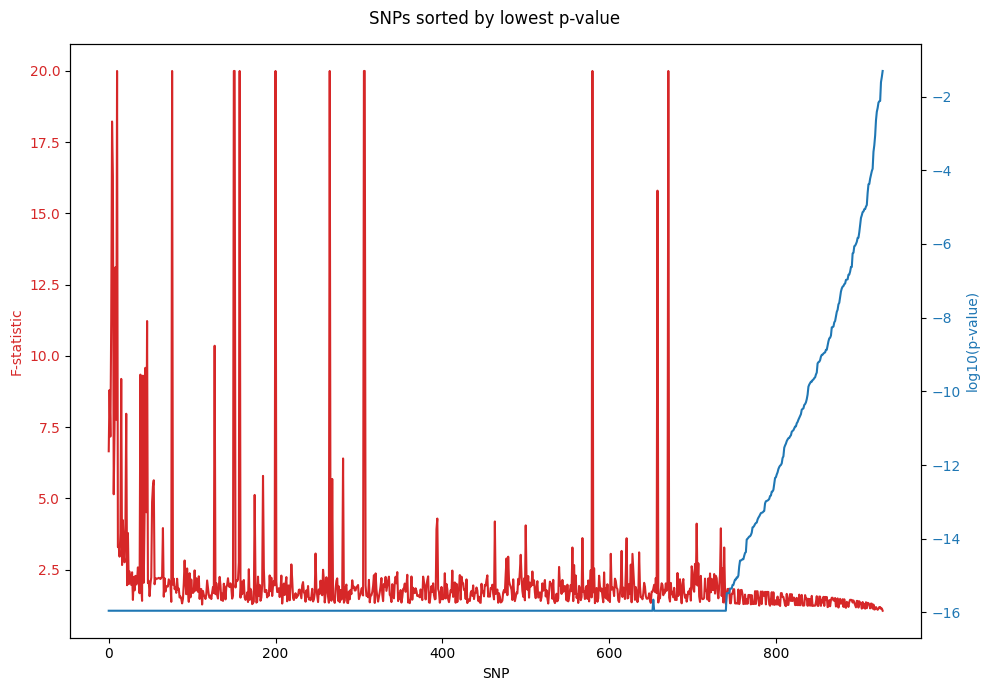

In [11]:
del b_05

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_10 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
b_10.filtering()
b_10.training(beta = 1)
b_10.clustering(algorithm = "kmeans_umap3d")
b_10.phylogeny(cluster_no = 8)

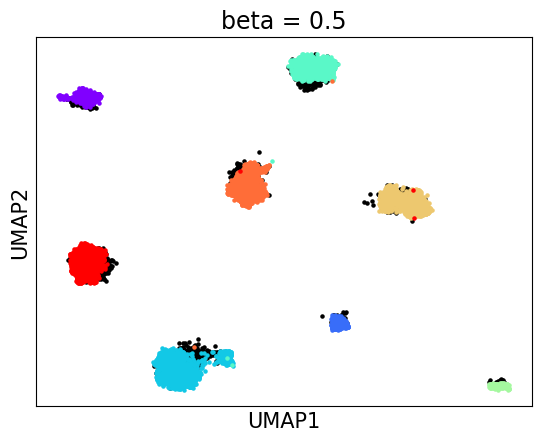

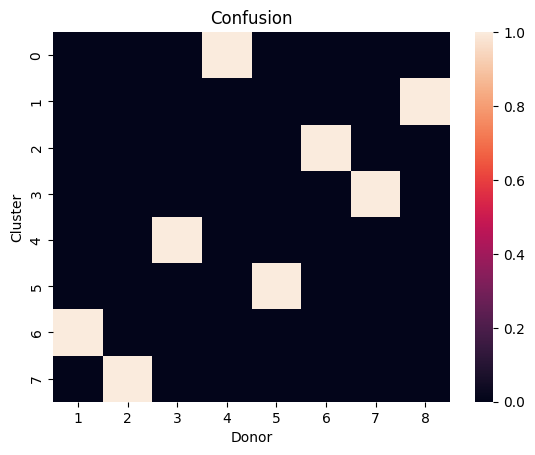

accuracy: 99.8762614474773
silhouette score: 0.8753759835076066


In [12]:
b_10_embedding_2d = b_10.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[b_10.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[b_10.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(b_10.embedding_2d[donors[8], 0], b_10.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(b_10.embedding_2d[donors[w], 0], b_10.embedding_2d[donors[w], 1], s = 5, color = b_10.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 0.5", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = b_10.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(b_10.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_10.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


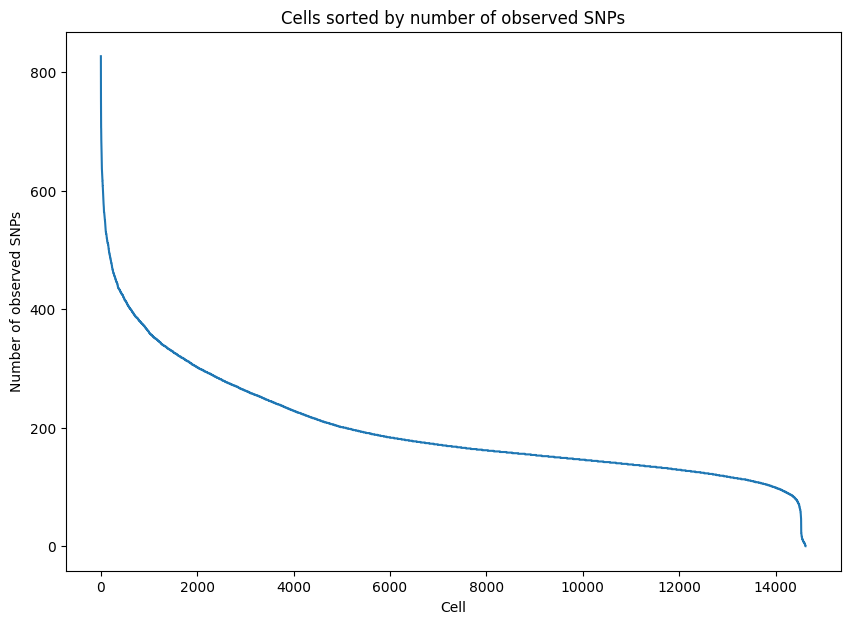

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


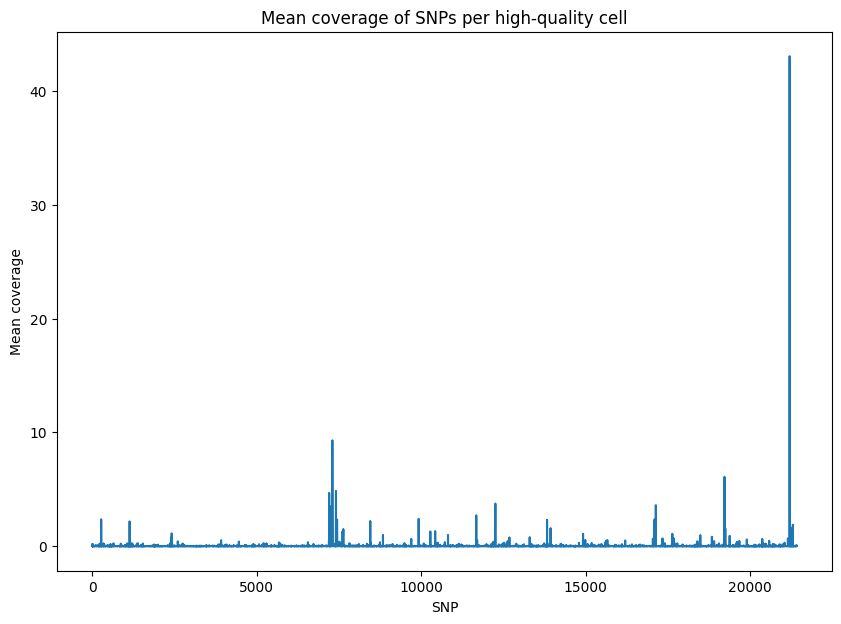

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


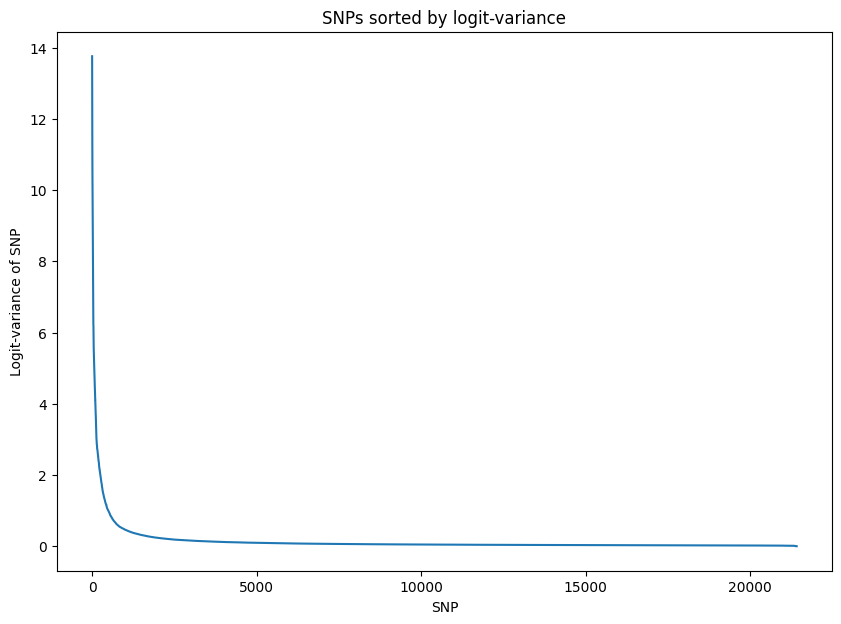

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 2.174335
Epoch[20/2000], Cost: 1.799459
Epoch[30/2000], Cost: 1.570752
Epoch[40/2000], Cost: 1.413502
Epoch[50/2000], Cost: 1.301203
Epoch[60/2000], Cost: 1.216136
Epoch[70/2000], Cost: 1.154082
Epoch[80/2000], Cost: 1.106150
Epoch[90/2000], Cost: 1.067137
Epoch[100/2000], Cost: 1.039619
Epoch[200/2000], Cost: 0.924768
Epoch[300/2000], Cost: 0.893925
Epoch[400/2000], Cost: 0.881308
Epoch[500/2000], Cost: 0.871132
Epoch[600/2000], Cost: 0.867043
Epoch[700/2000], Cost: 0.861063
Epoch[800/2000], Cost: 0.857742
Epoch[900/2000], Cost: 0.854084
Epoch[1000/2000], Cost: 0.851204
Epoch[1100/2000], Cost: 0.845723
Epoch[1200/2000], Cost: 0.841312
Epoch[1300/2000], Cost: 0.834117
Epoch[1400/2000], Cost: 0.828723
Epoch[1500/2000], Cost: 0.820432
Epoch[1600/20

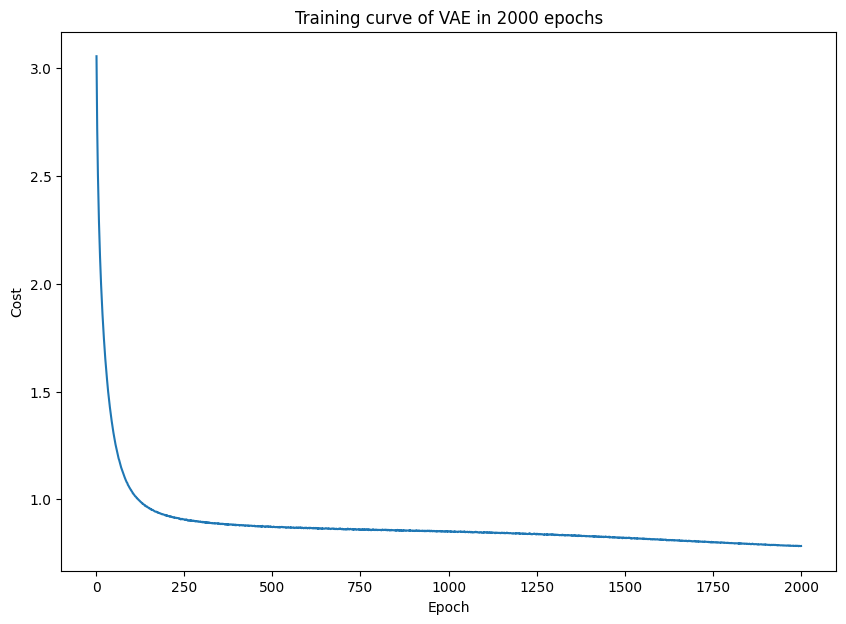

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


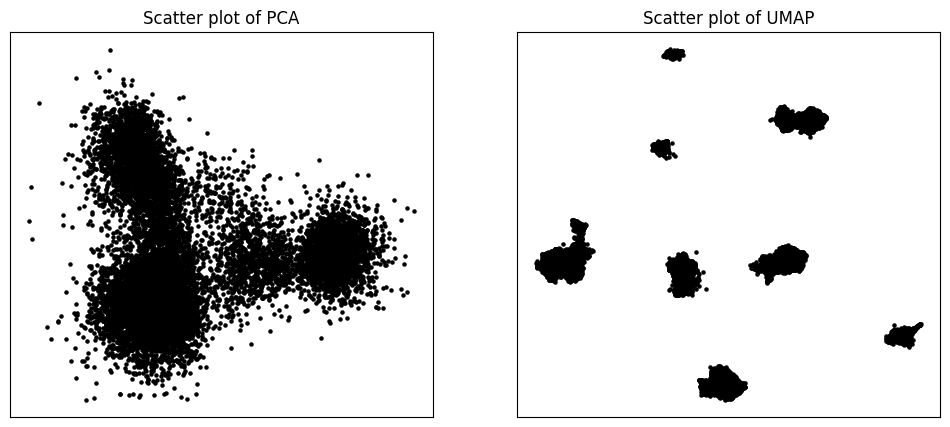

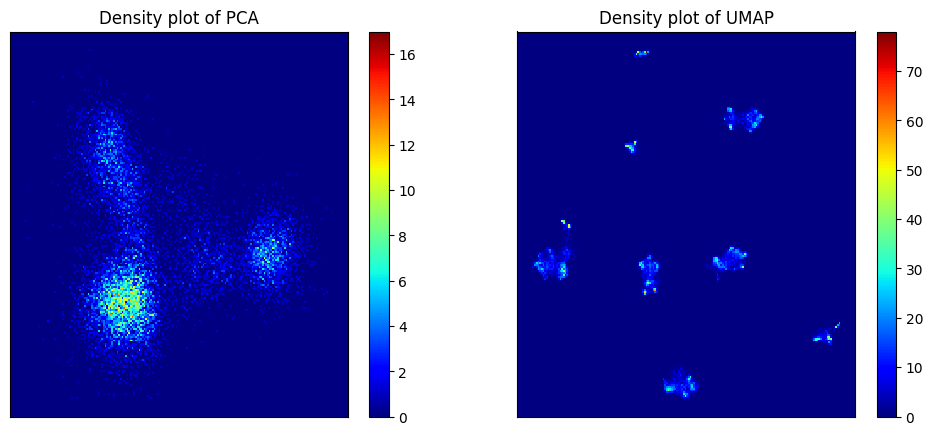

Start clustering.
2 clusters, Distortion: 394309.656250
3 clusters, Distortion: 295206.750000
4 clusters, Distortion: 145938.671875
5 clusters, Distortion: 86026.875000
6 clusters, Distortion: 46699.628906
7 clusters, Distortion: 18193.888672
8 clusters, Distortion: 9350.948242
9 clusters, Distortion: 7269.251465
10 clusters, Distortion: 6142.549316
11 clusters, Distortion: 5673.471680
12 clusters, Distortion: 4546.542969
13 clusters, Distortion: 4284.910156
14 clusters, Distortion: 3471.520264
15 clusters, Distortion: 3302.352051
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


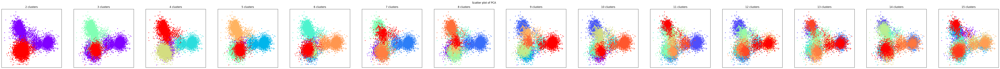

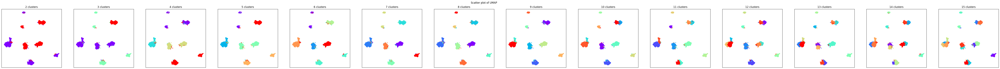

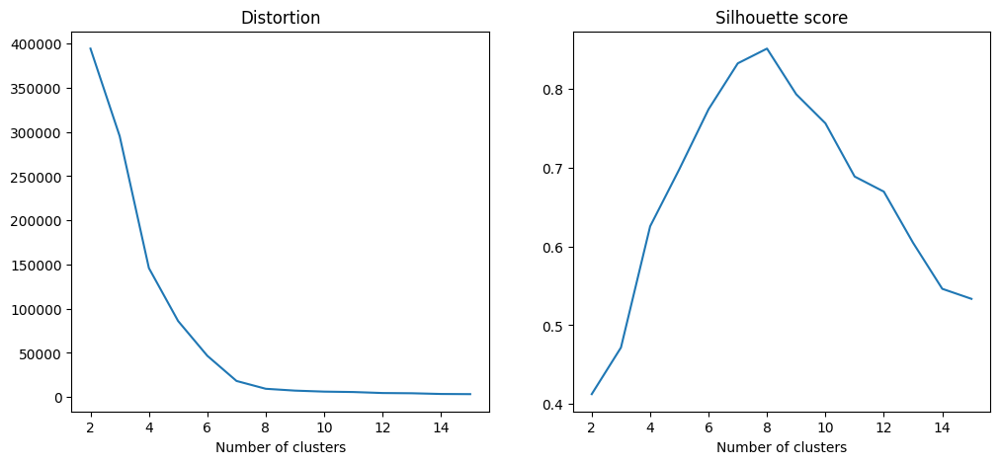

PCA and UMAP of individual clusters will be shown below.


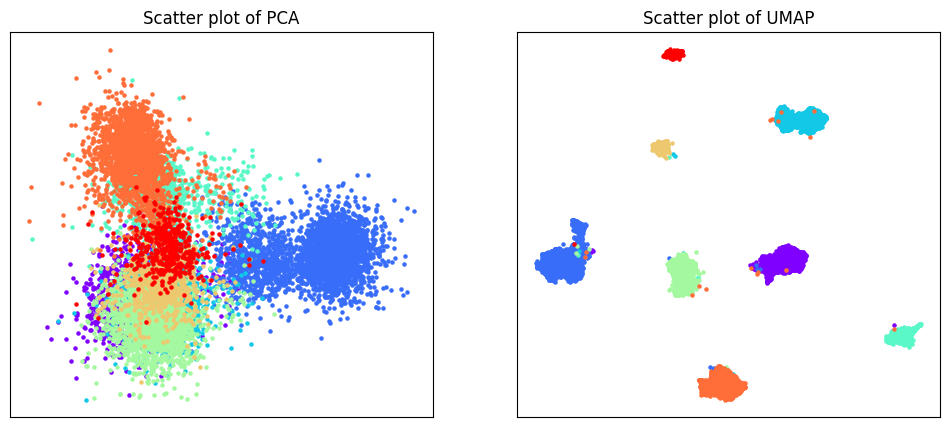

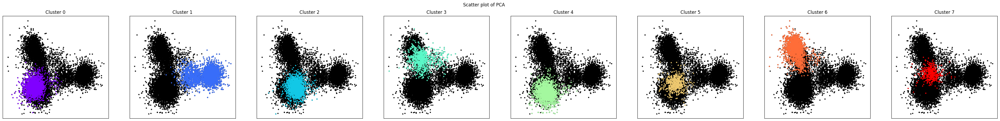

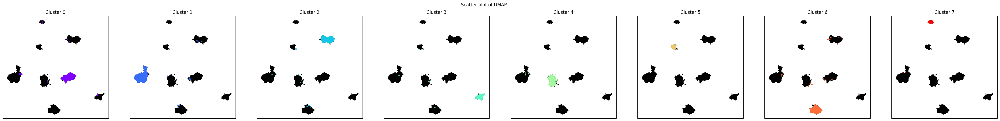

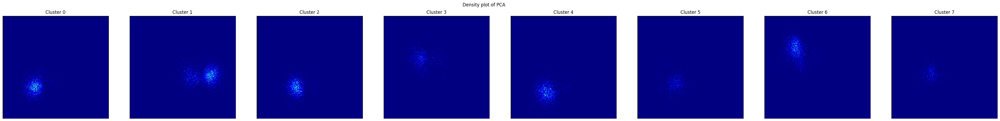

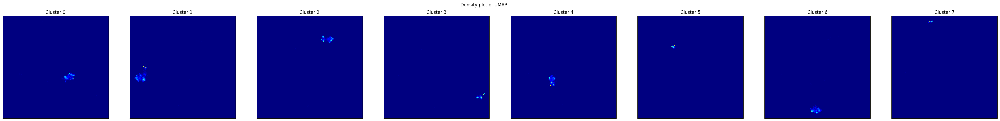

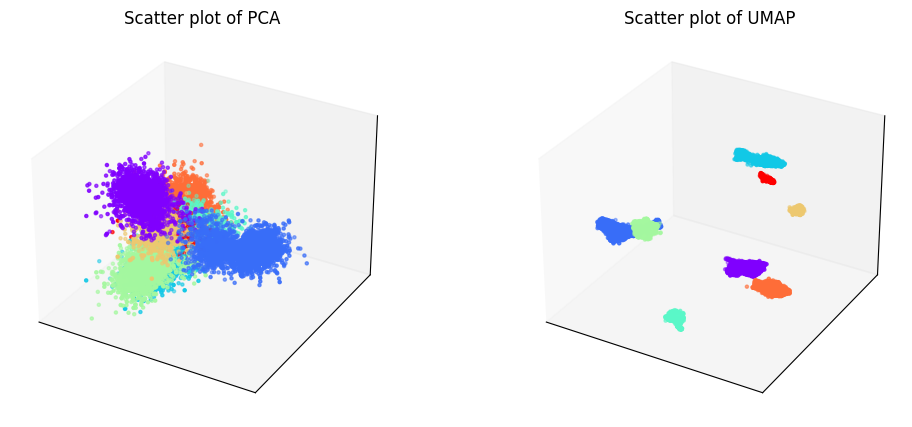

Phylogenetic tree in latent space will be shown below.


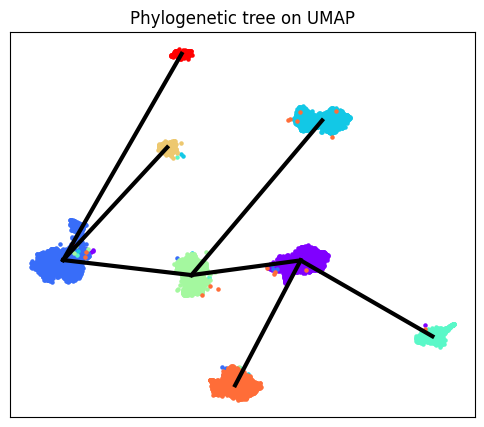

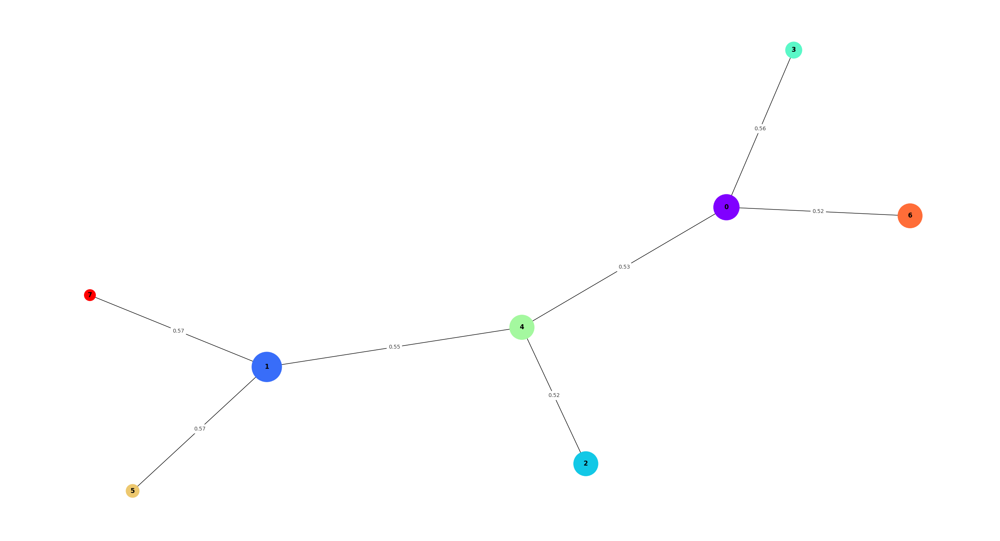

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


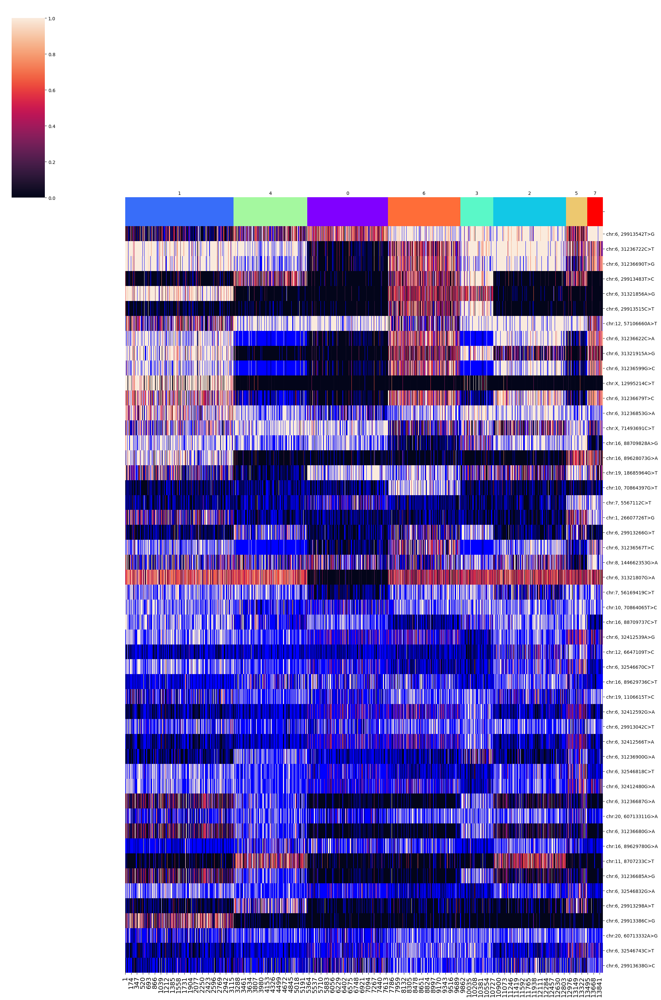

SNPs sorted by lowest p-value will be shown below


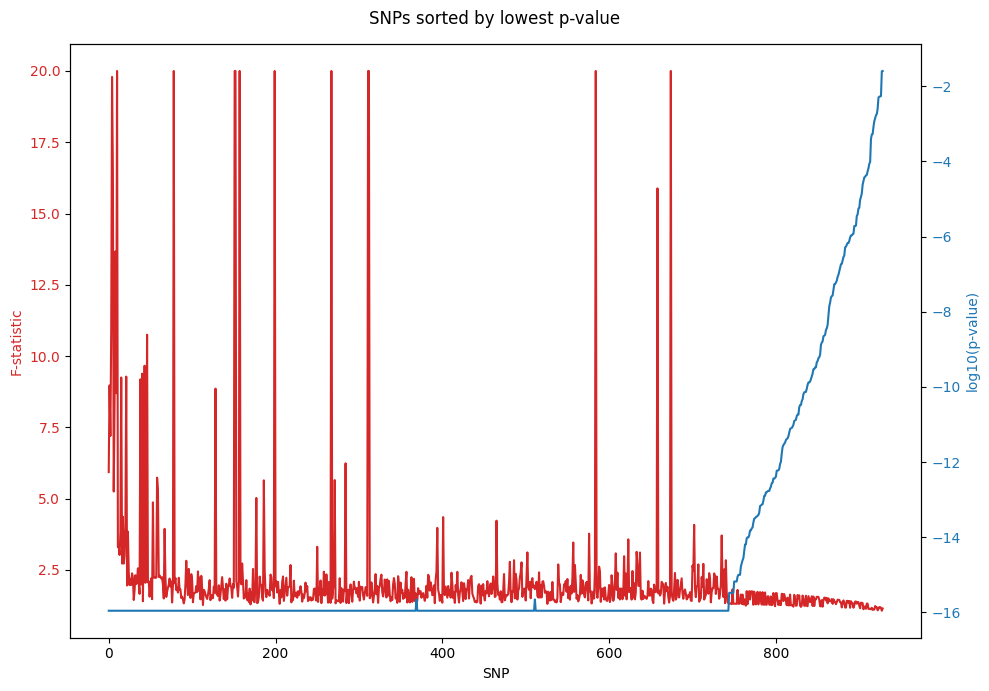

In [13]:
del b_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_15 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
b_15.filtering()
b_15.training(beta = 1.5)
b_15.clustering(algorithm = "kmeans_umap3d")
b_15.phylogeny(cluster_no = 8)

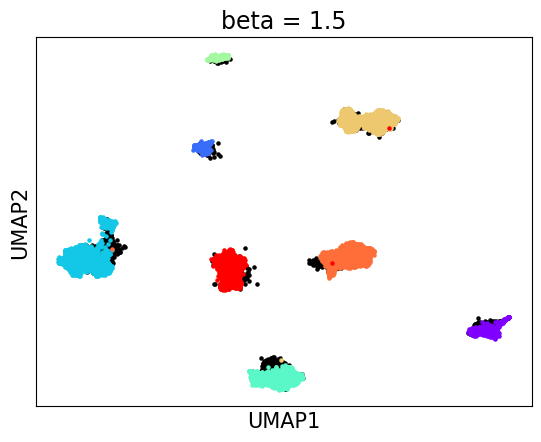

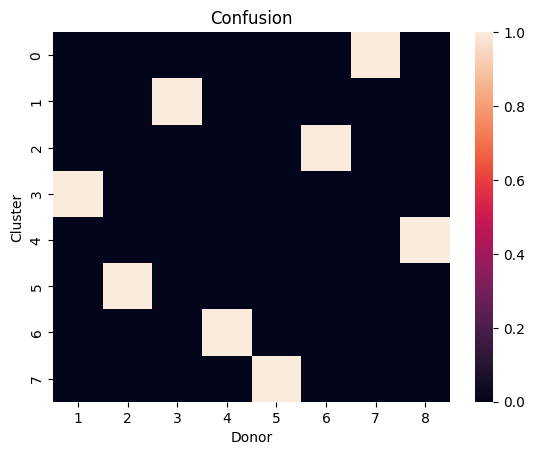

accuracy: 99.91261374815016
silhouette score: 0.8513741212712923


In [14]:
b_15_embedding_2d = b_15.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[b_15.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[b_15.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(b_15.embedding_2d[donors[8], 0], b_15.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(b_15.embedding_2d[donors[w], 0], b_15.embedding_2d[donors[w], 1], s = 5, color = b_15.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 1.5", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = b_15.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(b_15.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_15.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


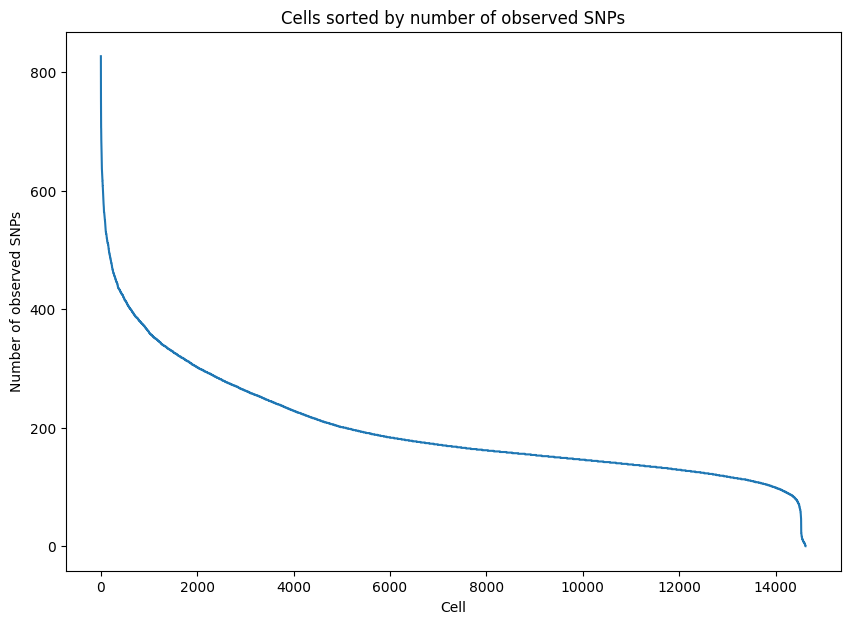

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


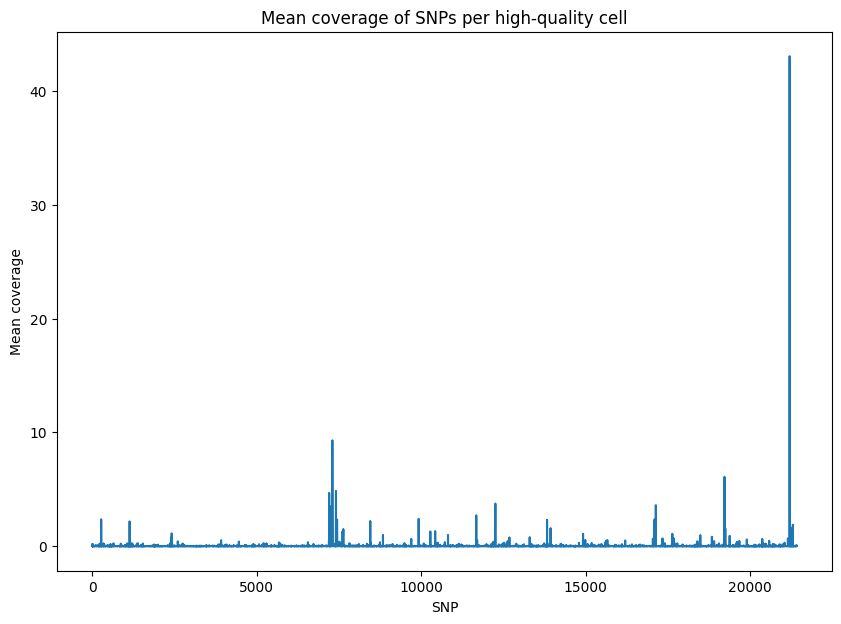

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


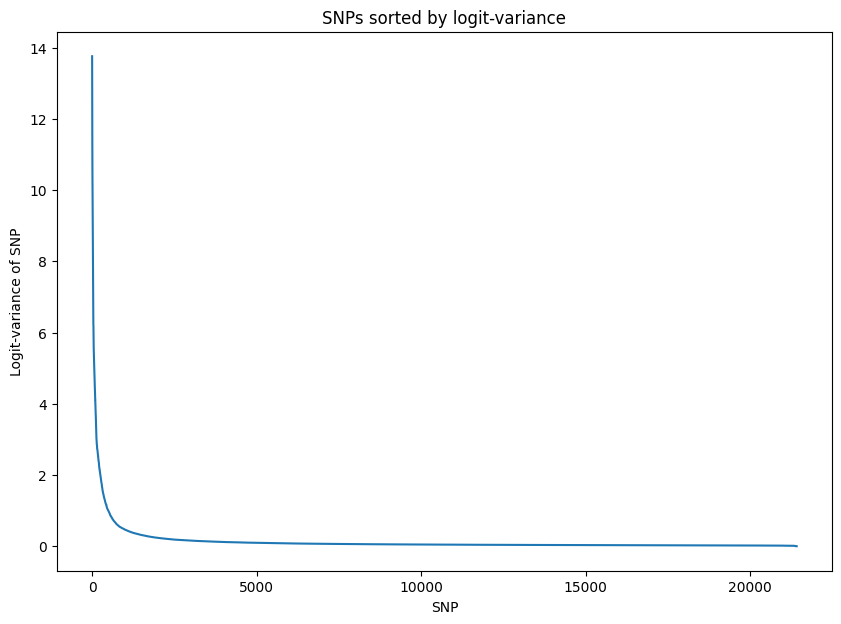

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 2.424412
Epoch[20/2000], Cost: 1.990940
Epoch[30/2000], Cost: 1.721271
Epoch[40/2000], Cost: 1.531148
Epoch[50/2000], Cost: 1.396228
Epoch[60/2000], Cost: 1.297284
Epoch[70/2000], Cost: 1.223607
Epoch[80/2000], Cost: 1.170189
Epoch[90/2000], Cost: 1.126146
Epoch[100/2000], Cost: 1.092570
Epoch[200/2000], Cost: 0.967679
Epoch[300/2000], Cost: 0.939160
Epoch[400/2000], Cost: 0.926201
Epoch[500/2000], Cost: 0.917844
Epoch[600/2000], Cost: 0.912875
Epoch[700/2000], Cost: 0.908968
Epoch[800/2000], Cost: 0.906308
Epoch[900/2000], Cost: 0.904023
Epoch[1000/2000], Cost: 0.901333
Epoch[1100/2000], Cost: 0.898471
Epoch[1200/2000], Cost: 0.894181
Epoch[1300/2000], Cost: 0.889972
Epoch[1400/2000], Cost: 0.883031
Epoch[1500/2000], Cost: 0.878919
Epoch[1600/20

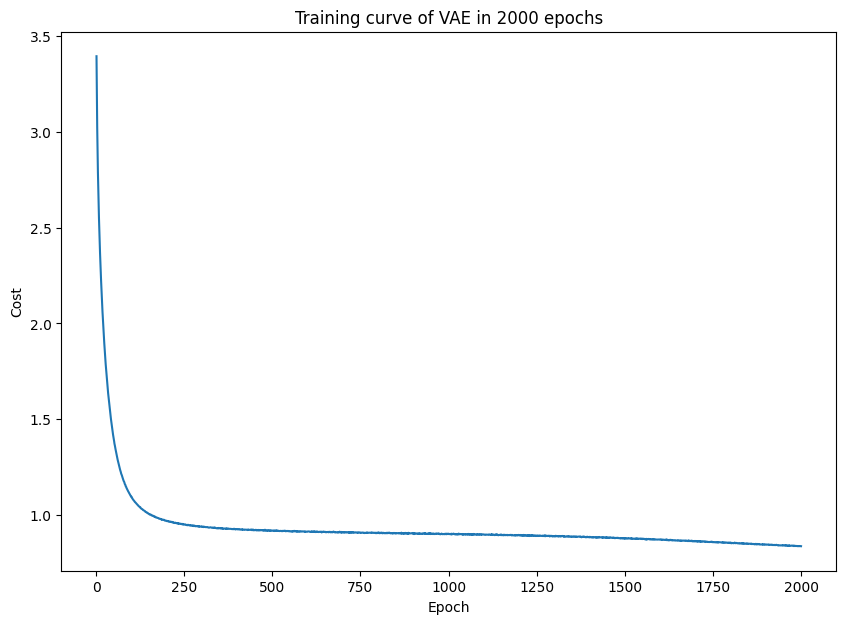

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


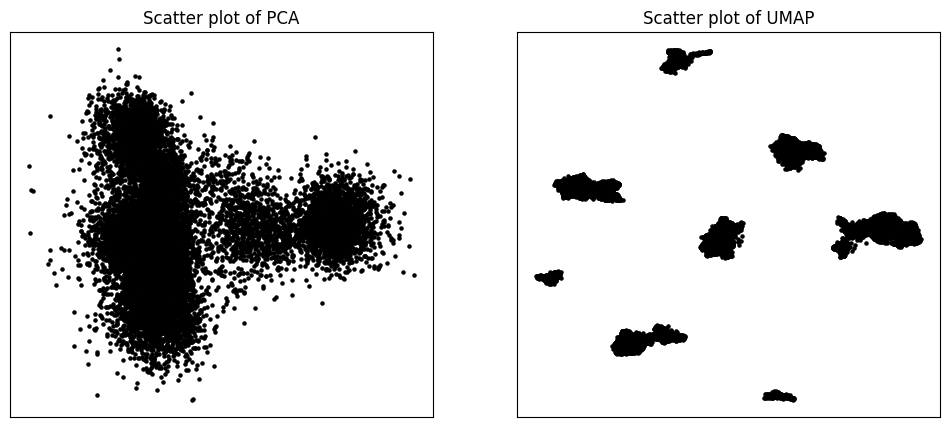

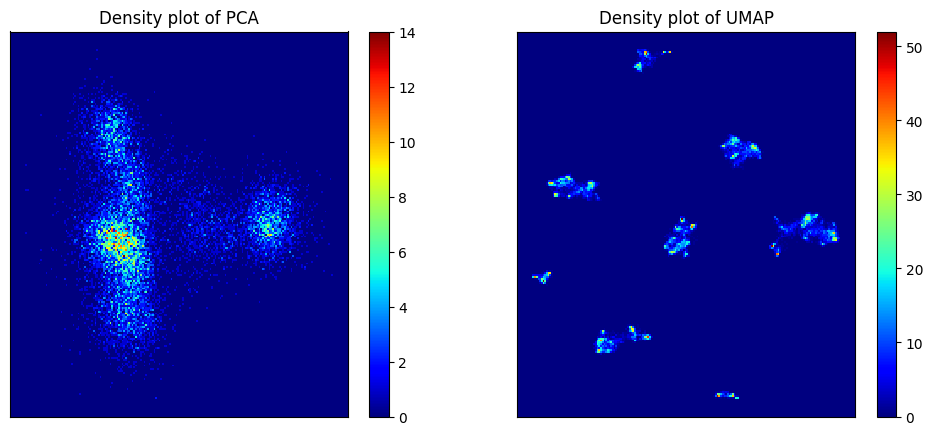

Start clustering.
2 clusters, Distortion: 473714.593750
3 clusters, Distortion: 287206.218750
4 clusters, Distortion: 182334.843750
5 clusters, Distortion: 97494.289062
6 clusters, Distortion: 57593.531250
7 clusters, Distortion: 19662.974609
8 clusters, Distortion: 12437.575195
9 clusters, Distortion: 9659.581055
10 clusters, Distortion: 9474.840820
11 clusters, Distortion: 6789.334961
12 clusters, Distortion: 6742.032715
13 clusters, Distortion: 4797.657227
14 clusters, Distortion: 4747.259766
15 clusters, Distortion: 4228.067383
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


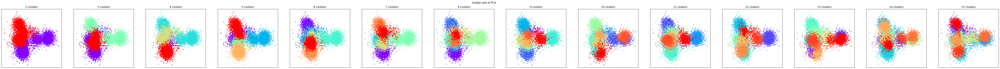

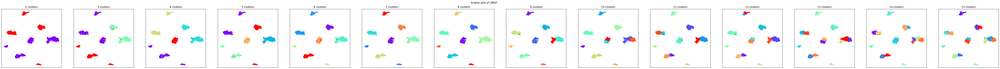

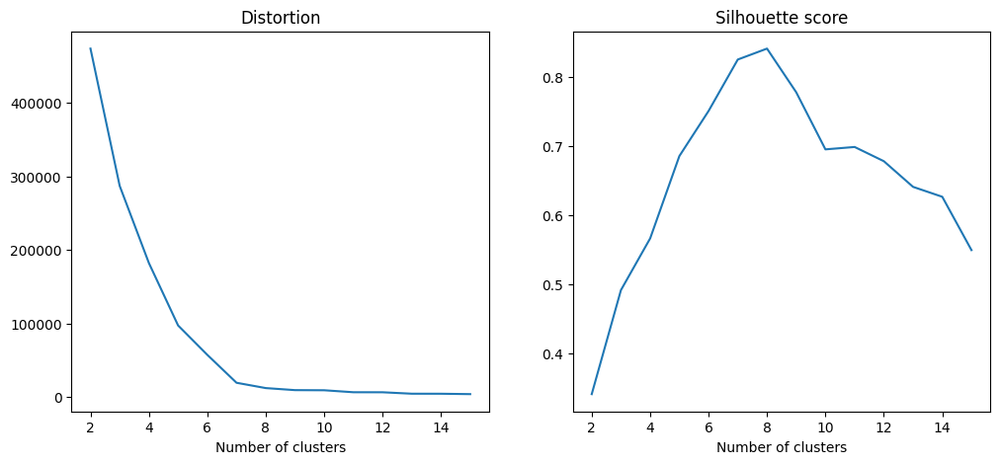

PCA and UMAP of individual clusters will be shown below.


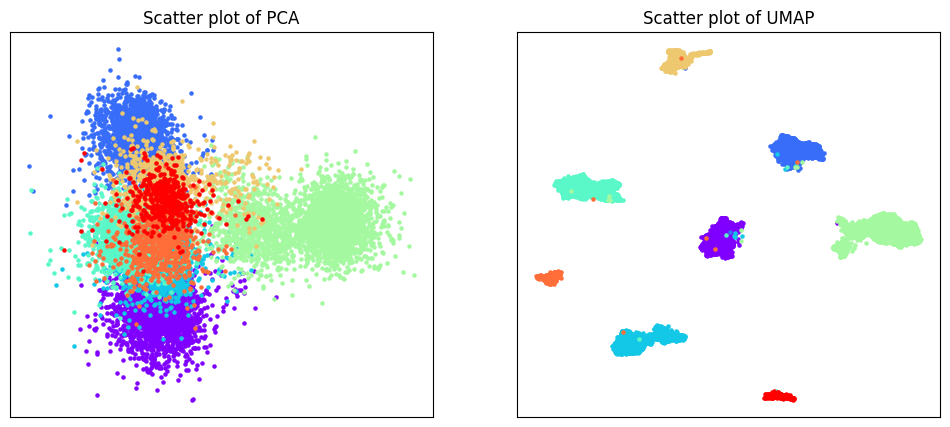

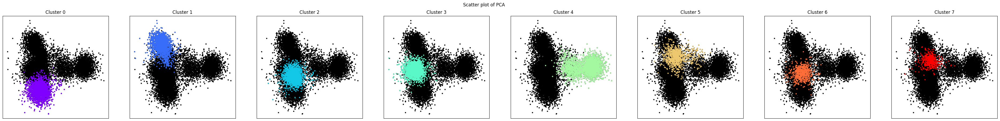

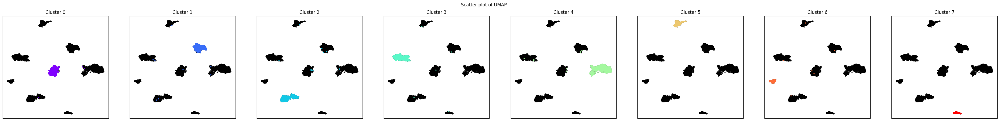

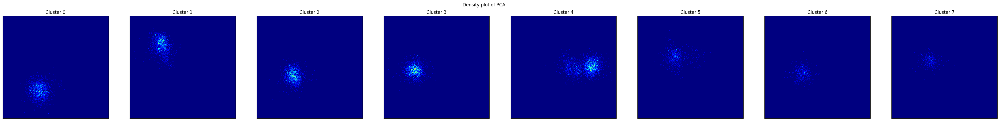

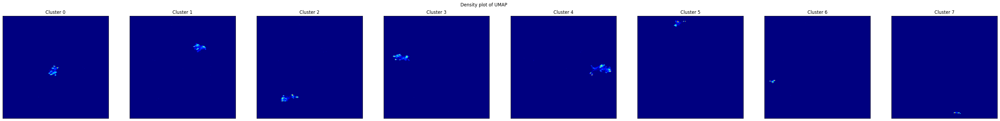

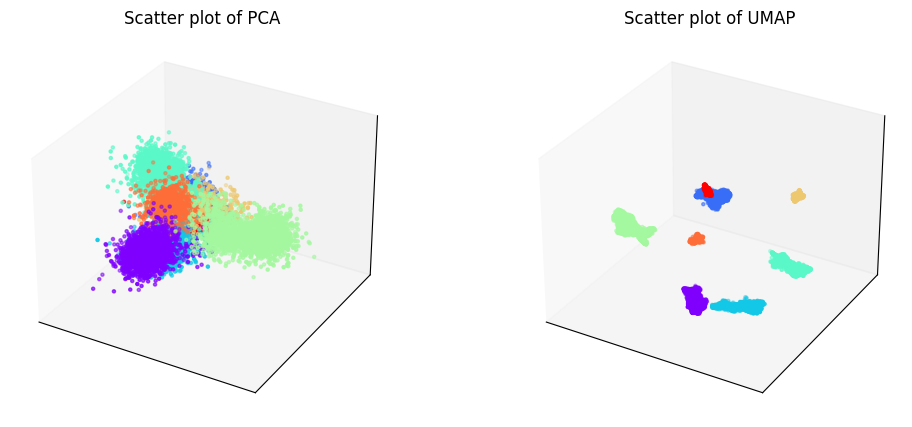

Phylogenetic tree in latent space will be shown below.


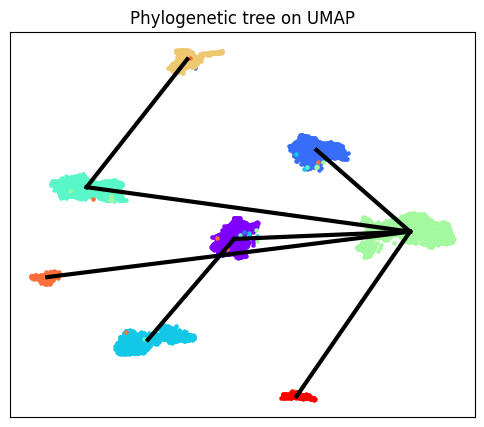

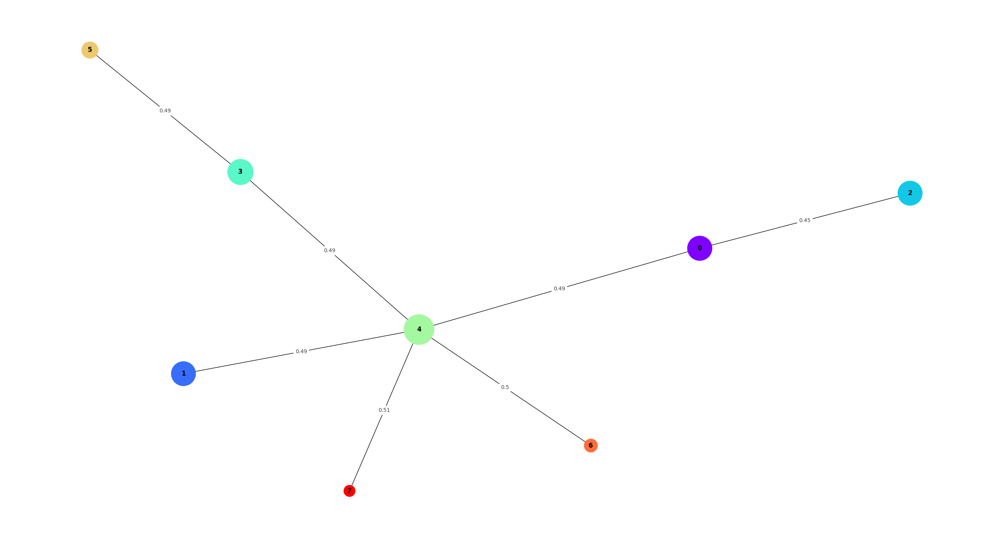

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


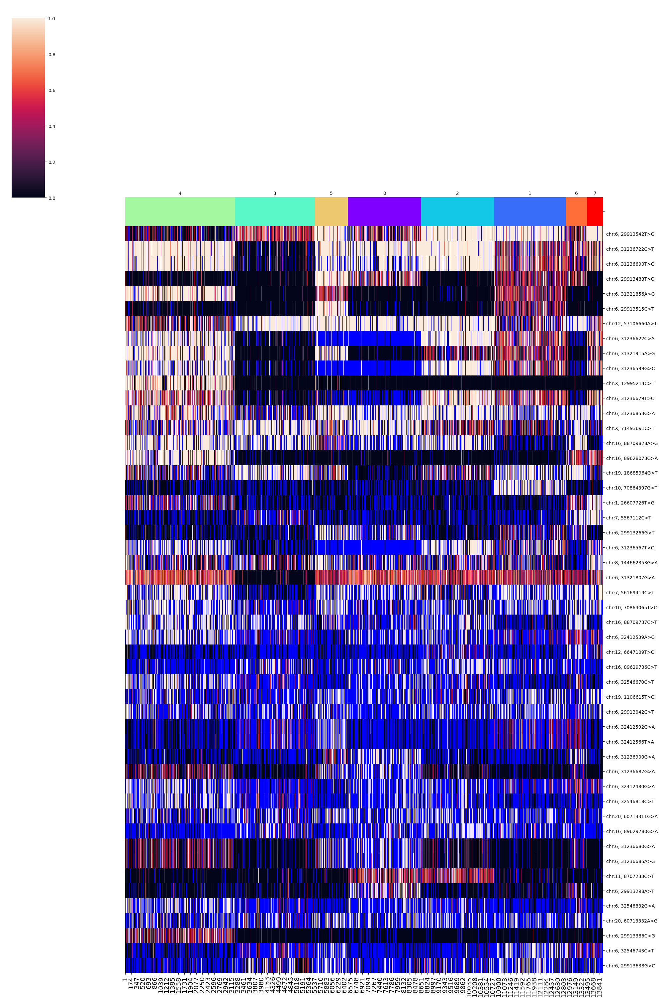

SNPs sorted by lowest p-value will be shown below


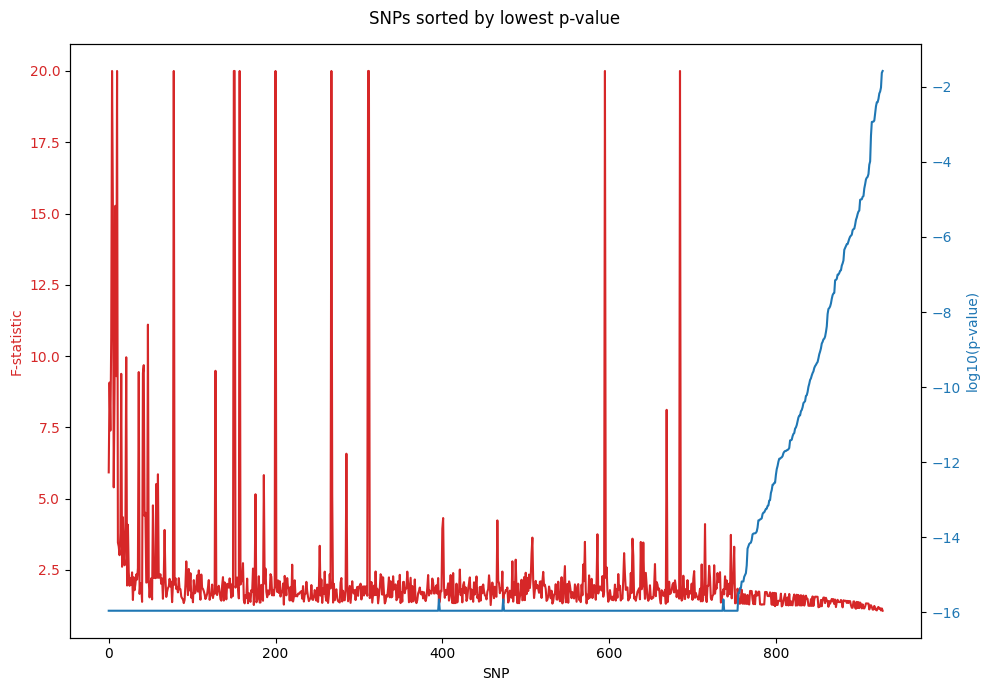

In [15]:
del b_15

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_20 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
b_20.filtering()
b_20.training(beta = 2)
b_20.clustering(algorithm = "kmeans_umap3d")
b_20.phylogeny(cluster_no = 8)

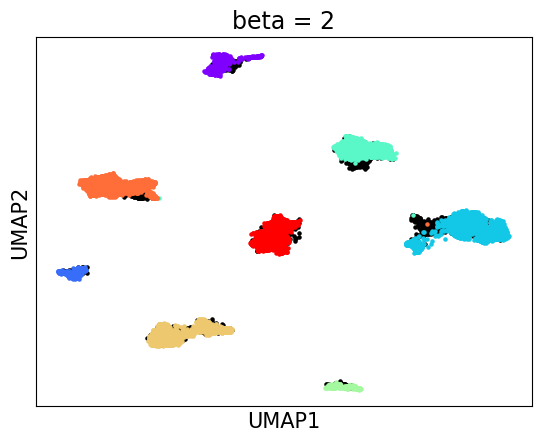

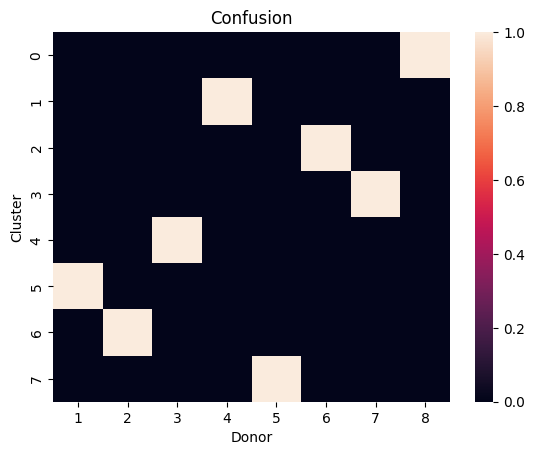

accuracy: 99.95672632612668
silhouette score: 0.843306059032169


In [16]:
b_20_embedding_2d = b_20.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[b_20.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[b_20.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(b_20.embedding_2d[donors[8], 0], b_20.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(b_20.embedding_2d[donors[w], 0], b_20.embedding_2d[donors[w], 1], s = 5, color = b_20.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 2", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = b_20.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(b_20.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_20.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

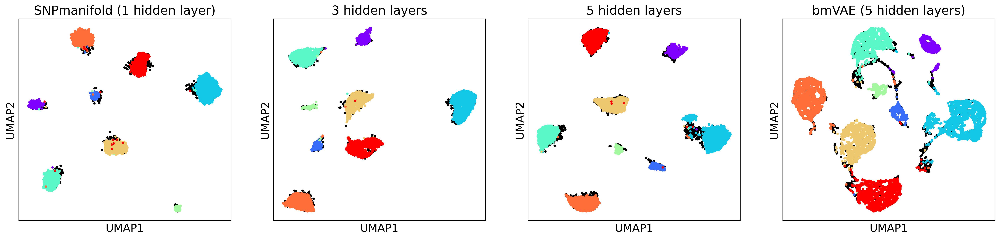

In [19]:
fig, axs = plt.subplots(1, 4, dpi = 300)
fig.set_size_inches(24, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[8], 0], normalized_layer1_embedding_2d[donors[8], 1], s = 5, color = "black")
    
for t in range(8):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

axs[1].scatter(unnormalized_layer3_embedding_2d[donors[8], 0], unnormalized_layer3_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[1].scatter(unnormalized_layer3_embedding_2d[donors[t], 0], unnormalized_layer3_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("3 hidden layers", fontsize = 17)

axs[2].scatter(unnormalized_layer5_embedding_2d[donors[8], 0], unnormalized_layer5_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[2].scatter(unnormalized_layer5_embedding_2d[donors[t], 0], unnormalized_layer5_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("5 hidden layers", fontsize = 17)

axs[3].scatter(bmVAE_embedding_2d[donors[8], 0], bmVAE_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[3].scatter(bmVAE_embedding_2d[donors[t], 0], bmVAE_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("bmVAE (5 hidden layers)", fontsize = 17)
    
plt.show()

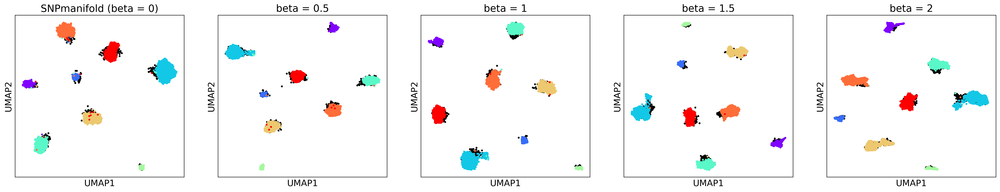

In [20]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[8], 0], normalized_layer1_embedding_2d[donors[8], 1], s = 5, color = "black")
    
for t in range(8):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (beta = 0)", fontsize = 17)

axs[1].scatter(b_05_embedding_2d[donors[8], 0], b_05_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[1].scatter(b_05_embedding_2d[donors[t], 0], b_05_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("beta = 0.5", fontsize = 17)

axs[2].scatter(b_10_embedding_2d[donors[8], 0], b_10_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[2].scatter(b_10_embedding_2d[donors[t], 0], b_10_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("beta = 1", fontsize = 17)

axs[3].scatter(b_15_embedding_2d[donors[8], 0], b_15_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[3].scatter(b_15_embedding_2d[donors[t], 0], b_15_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("beta = 1.5", fontsize = 17)

axs[4].scatter(b_20_embedding_2d[donors[8], 0], b_20_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[4].scatter(b_20_embedding_2d[donors[t], 0], b_20_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("beta = 2", fontsize = 17)
    
plt.show()

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


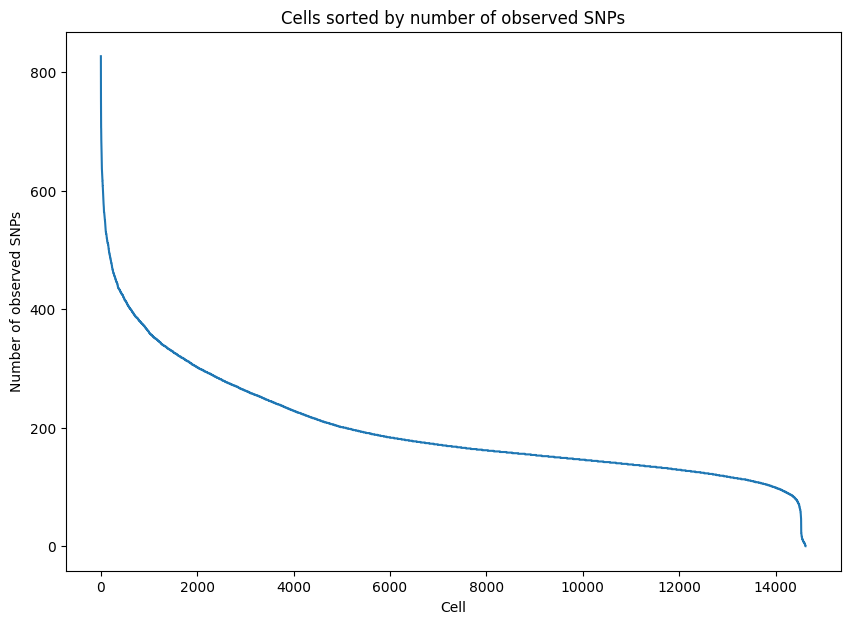

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


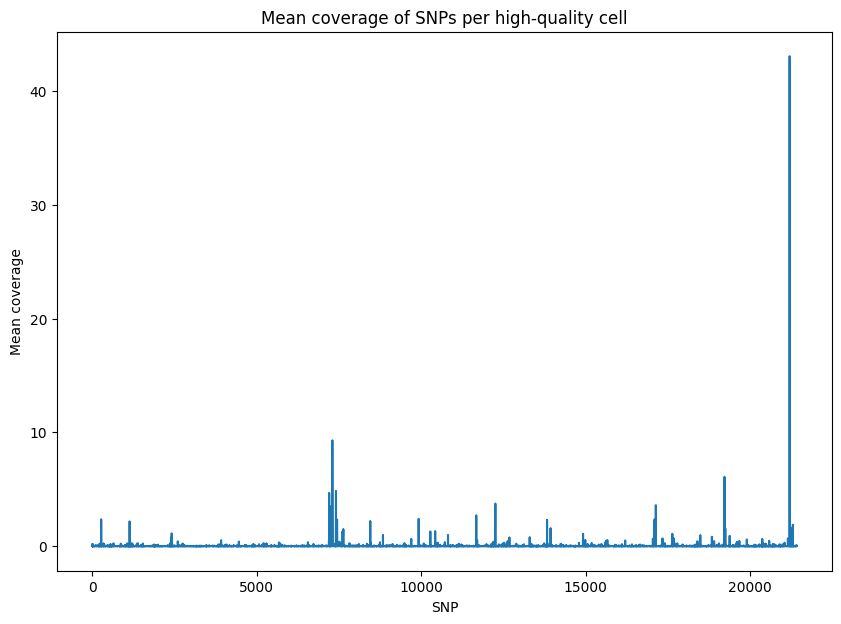

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


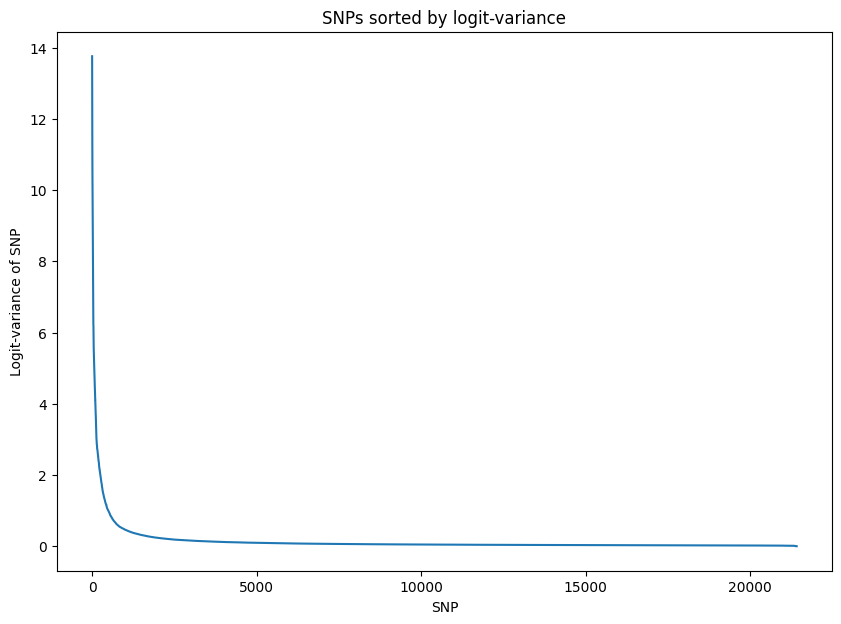

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.576526
Epoch[20/2000], Cost: 1.261812
Epoch[30/2000], Cost: 1.086667
Epoch[40/2000], Cost: 0.977476
Epoch[50/2000], Cost: 0.901515
Epoch[60/2000], Cost: 0.847138
Epoch[70/2000], Cost: 0.805223
Epoch[80/2000], Cost: 0.773330
Epoch[90/2000], Cost: 0.747308
Epoch[100/2000], Cost: 0.726520
Epoch[200/2000], Cost: 0.617488
Epoch[300/2000], Cost: 0.563727
Epoch[400/2000], Cost: 0.529204
Epoch[500/2000], Cost: 0.505486
Epoch[600/2000], Cost: 0.488229
Epoch[700/2000], Cost: 0.475222
Epoch[800/2000], Cost: 0.465103
Epoch[900/2000], Cost: 0.457133
Epoch[1000/2000], Cost: 0.450772
Epoch[1100/2000], Cost: 0.445586
Epoch[1200/2000], Cost: 0.441303
Epoch[1300/2000], Cost: 0.437699
Epoch[1400/2000], Cost: 0.434606
Epoch[1500/2000], Cost: 0.431934
Epoch[1600/20

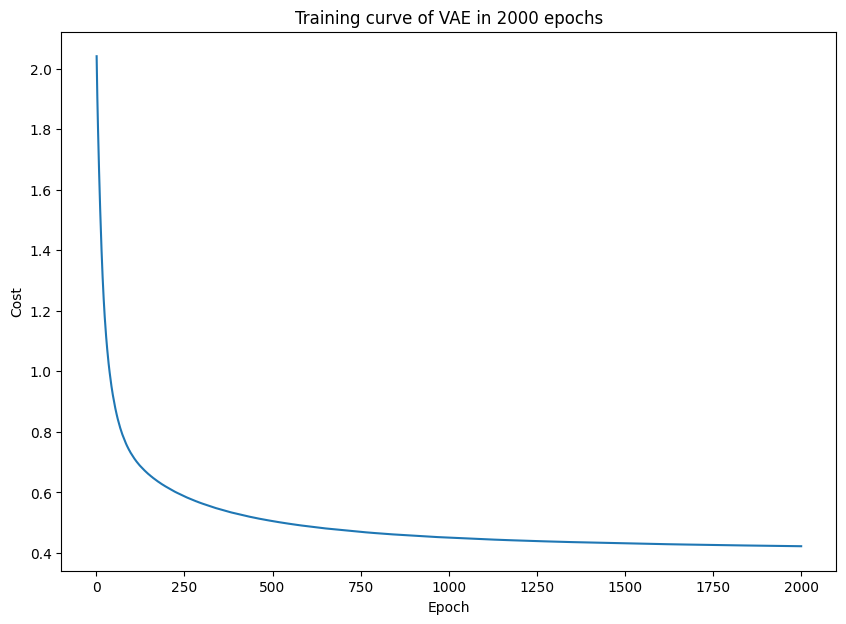

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


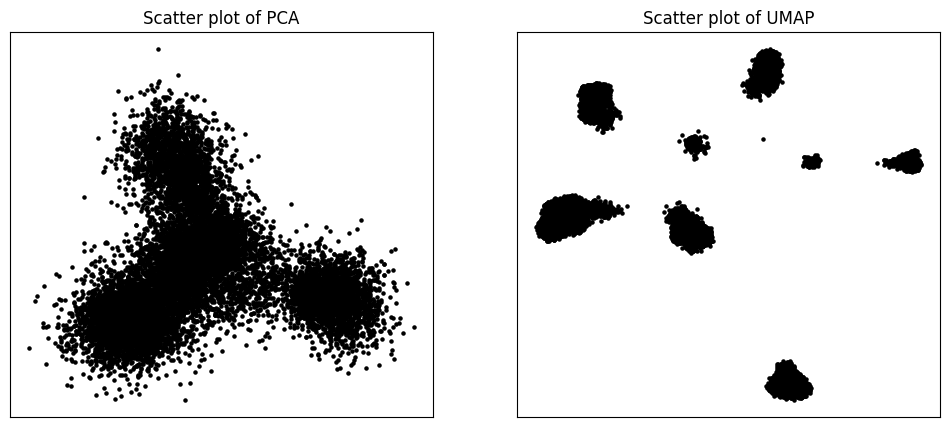

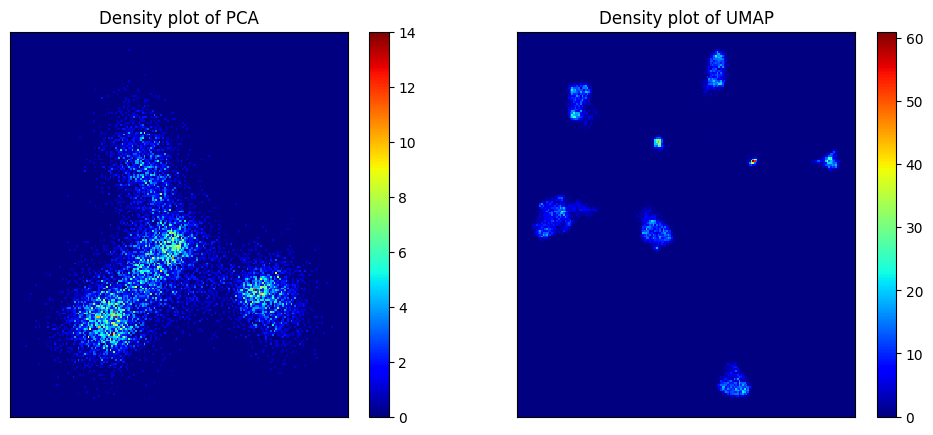

Start clustering.
2 clusters, Distortion: 250748.406250
3 clusters, Distortion: 148776.656250
4 clusters, Distortion: 104317.390625
5 clusters, Distortion: 70195.898438
6 clusters, Distortion: 31410.933594
7 clusters, Distortion: 22657.175781
8 clusters, Distortion: 5247.563477
9 clusters, Distortion: 4795.658691
10 clusters, Distortion: 4089.936035
11 clusters, Distortion: 3659.232666
12 clusters, Distortion: 3293.718506
13 clusters, Distortion: 3070.126465
14 clusters, Distortion: 2660.579590
15 clusters, Distortion: 2438.011475
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


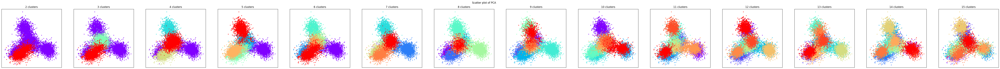

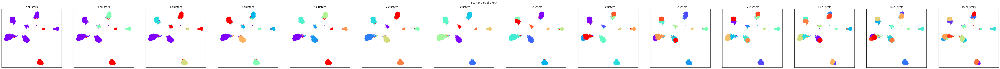

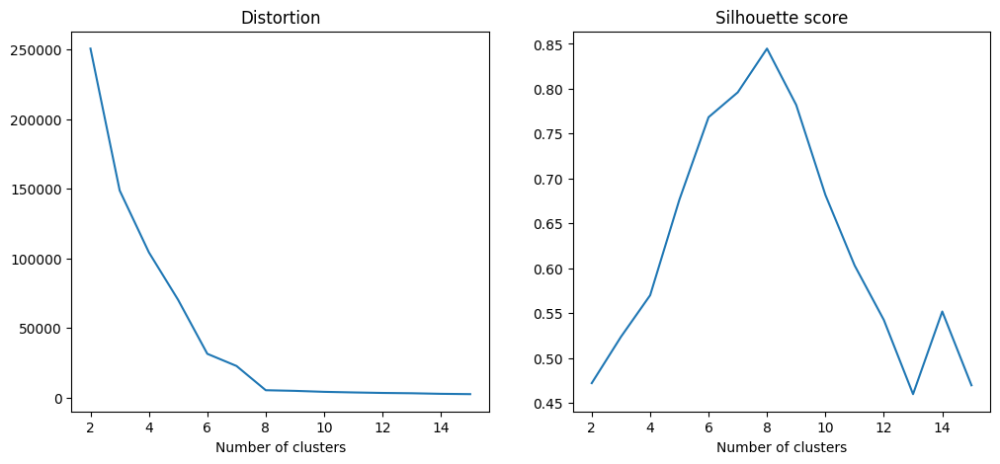

PCA and UMAP of individual clusters will be shown below.


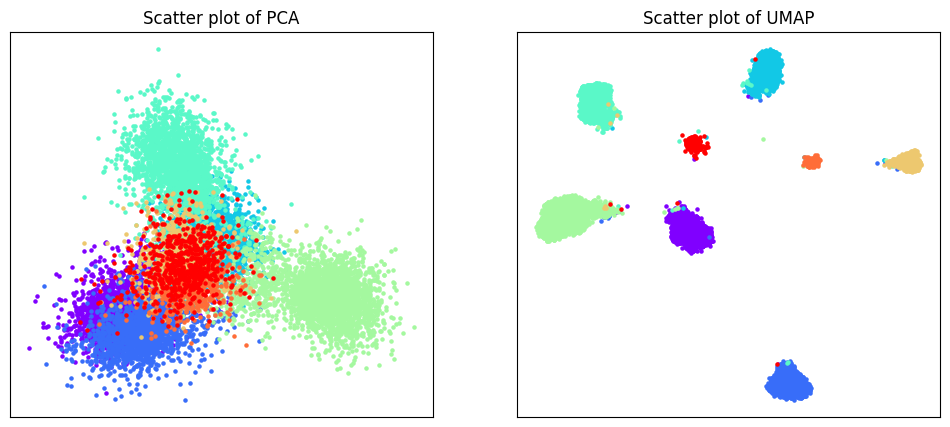

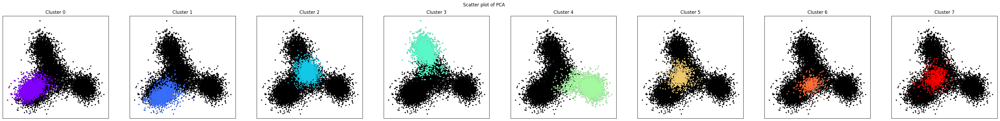

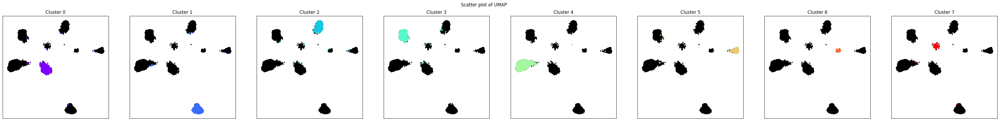

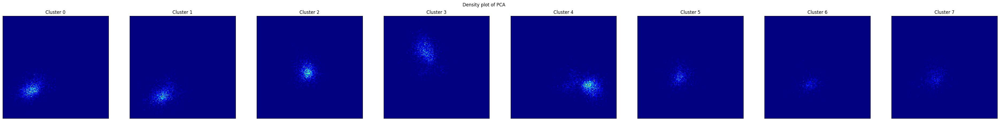

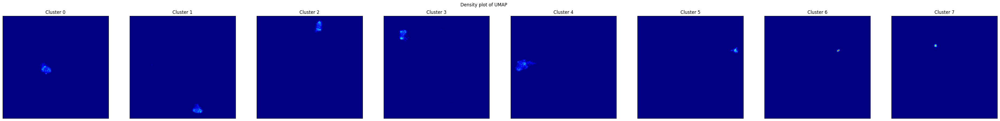

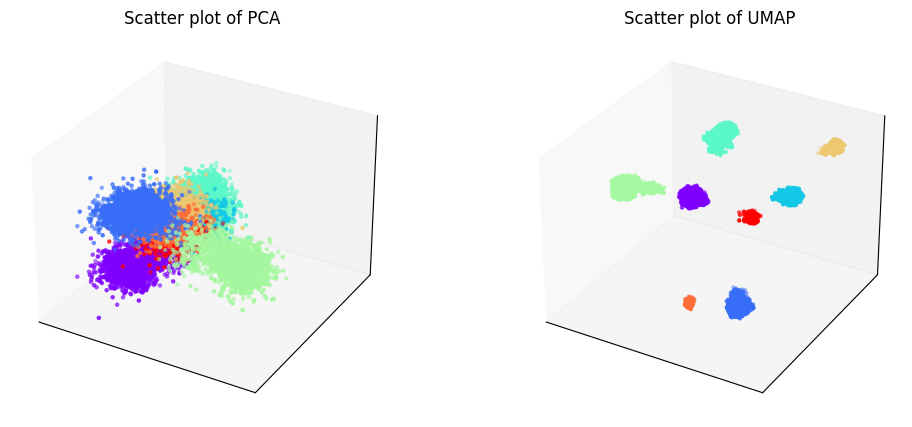

Phylogenetic tree in latent space will be shown below.


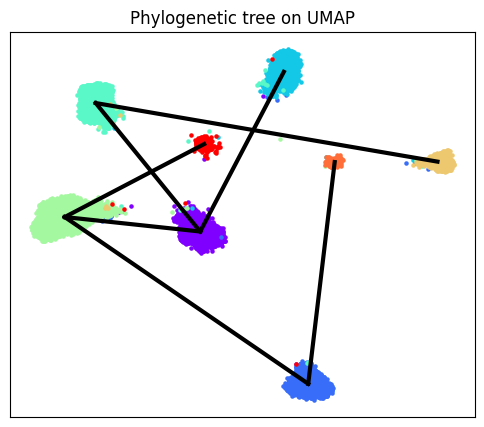

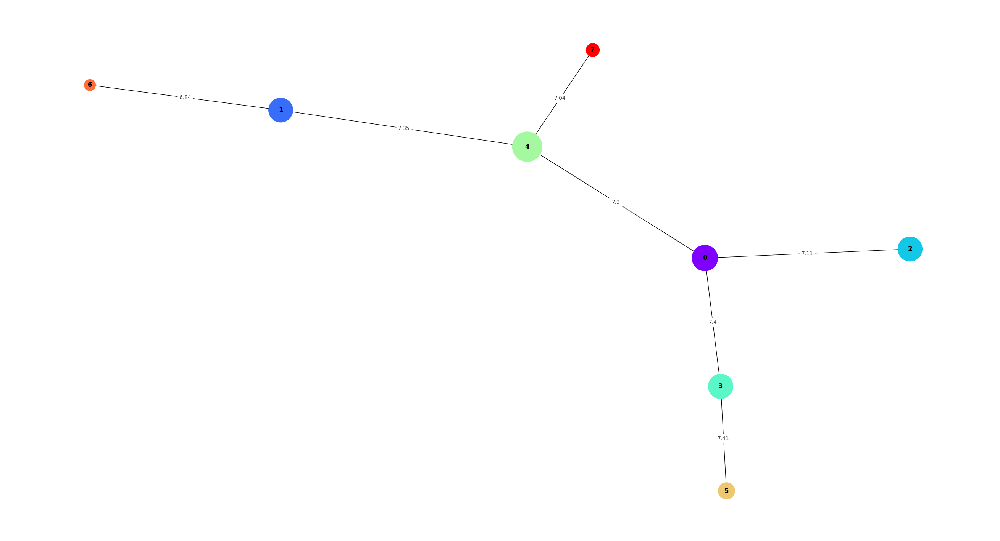

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


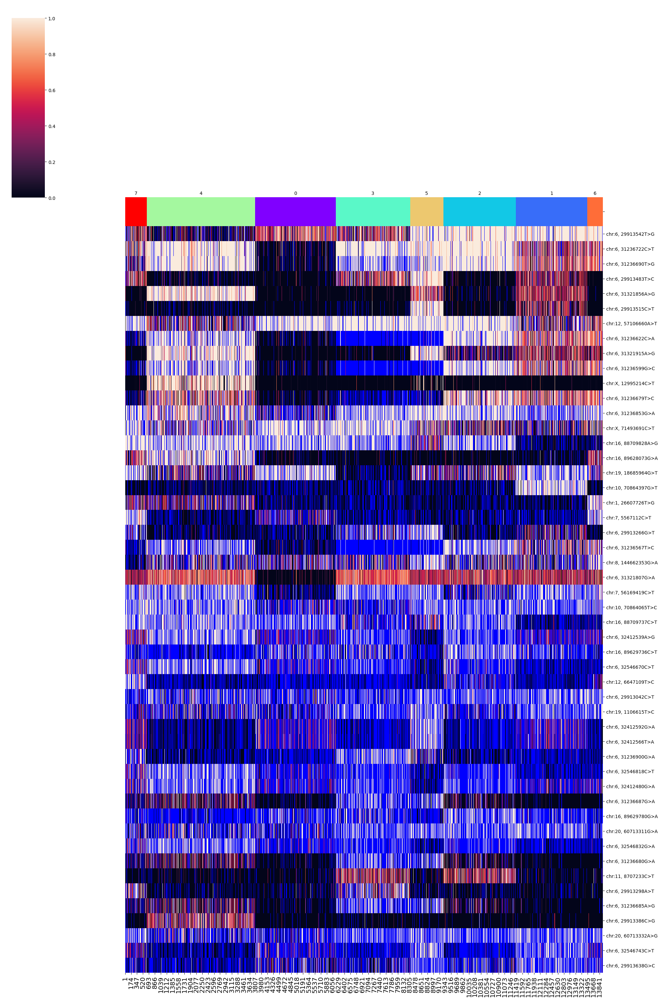

SNPs sorted by lowest p-value will be shown below


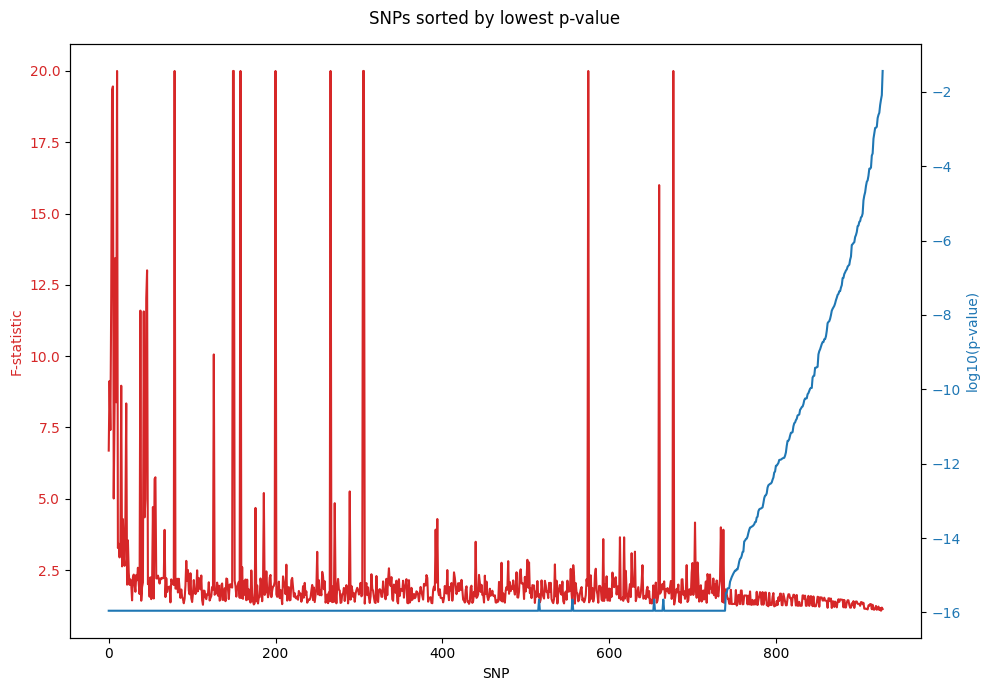

In [21]:
del b_20

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_10 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
D_10.filtering()
D_10.training(z_dim = np.ceil(929 / 10).astype(int))
D_10.clustering(algorithm = "kmeans_umap3d")
D_10.phylogeny(cluster_no = 8)

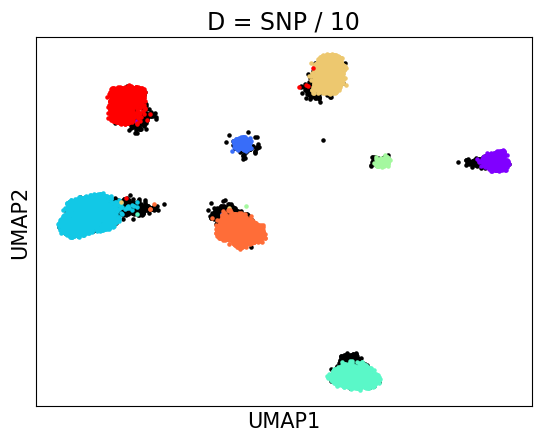

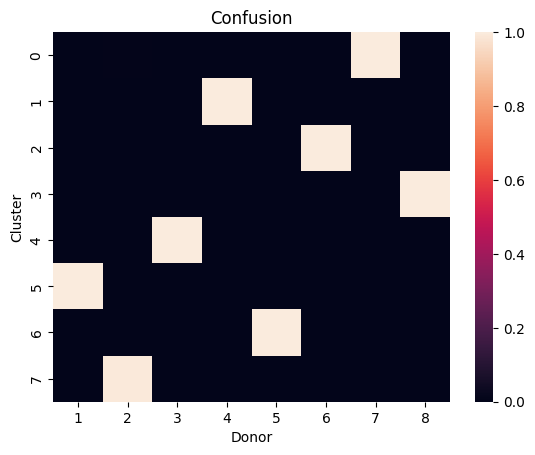

accuracy: 99.8440423612067
silhouette score: 0.8586408064234349


In [23]:
D_10_embedding_2d = D_10.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[D_10.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[D_10.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(D_10.embedding_2d[donors[8], 0], D_10.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(D_10.embedding_2d[donors[w], 0], D_10.embedding_2d[donors[w], 1], s = 5, color = D_10.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 10", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = D_10.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(D_10.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_10.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


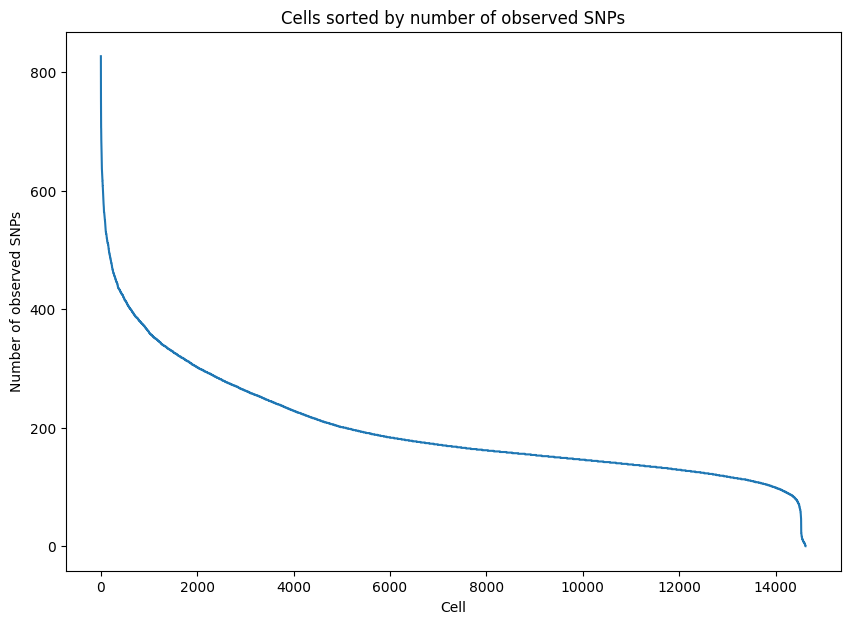

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


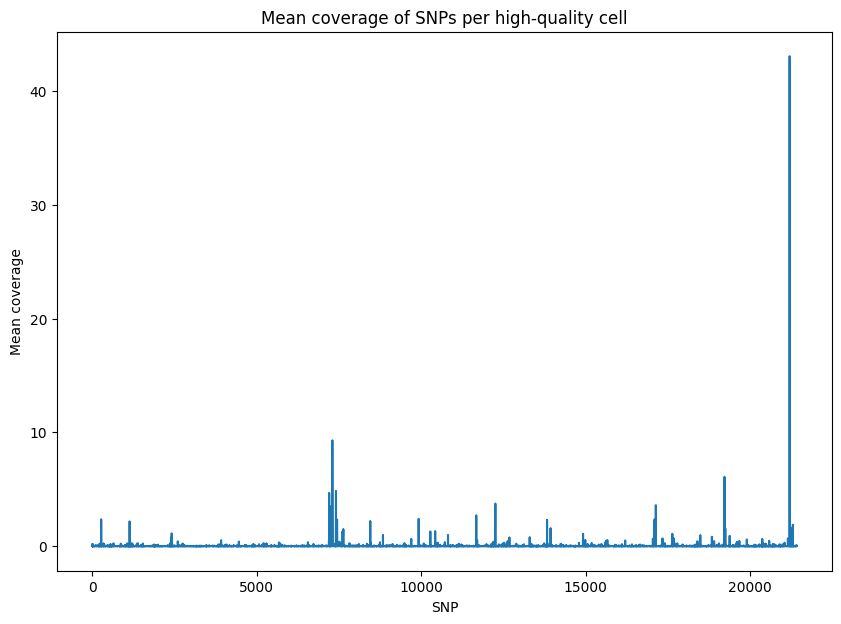

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


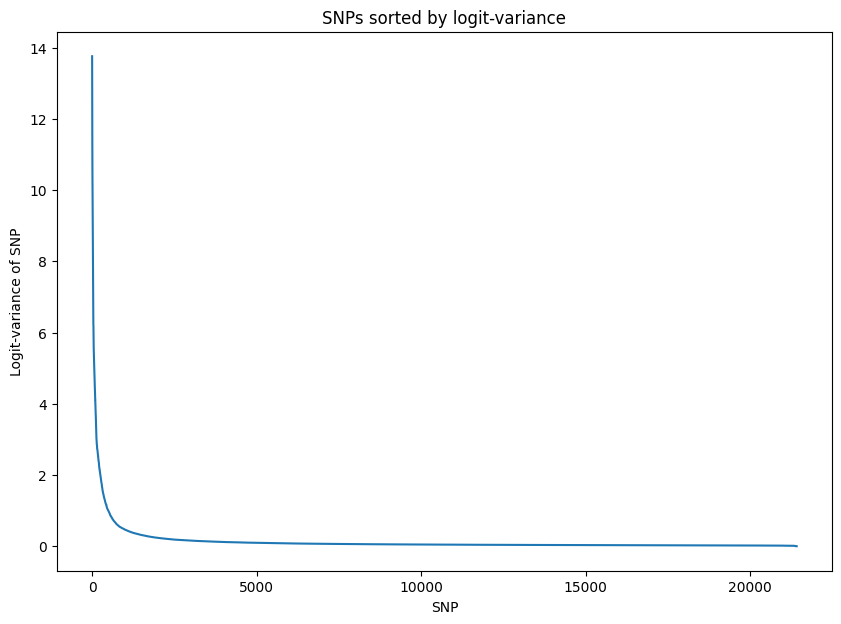

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.743370
Epoch[20/2000], Cost: 1.558515
Epoch[30/2000], Cost: 1.408907
Epoch[40/2000], Cost: 1.288612
Epoch[50/2000], Cost: 1.195287
Epoch[60/2000], Cost: 1.123538
Epoch[70/2000], Cost: 1.066683
Epoch[80/2000], Cost: 1.018672
Epoch[90/2000], Cost: 0.977701
Epoch[100/2000], Cost: 0.941692
Epoch[200/2000], Cost: 0.754709
Epoch[300/2000], Cost: 0.693519
Epoch[400/2000], Cost: 0.662792
Epoch[500/2000], Cost: 0.643319
Epoch[600/2000], Cost: 0.629509
Epoch[700/2000], Cost: 0.619156
Epoch[800/2000], Cost: 0.611053
Epoch[900/2000], Cost: 0.604597
Epoch[1000/2000], Cost: 0.599385
Epoch[1100/2000], Cost: 0.595132
Epoch[1200/2000], Cost: 0.591664
Epoch[1300/2000], Cost: 0.588793
Epoch[1400/2000], Cost: 0.586432
Epoch[1500/2000], Cost: 0.584439
Epoch[1600/20

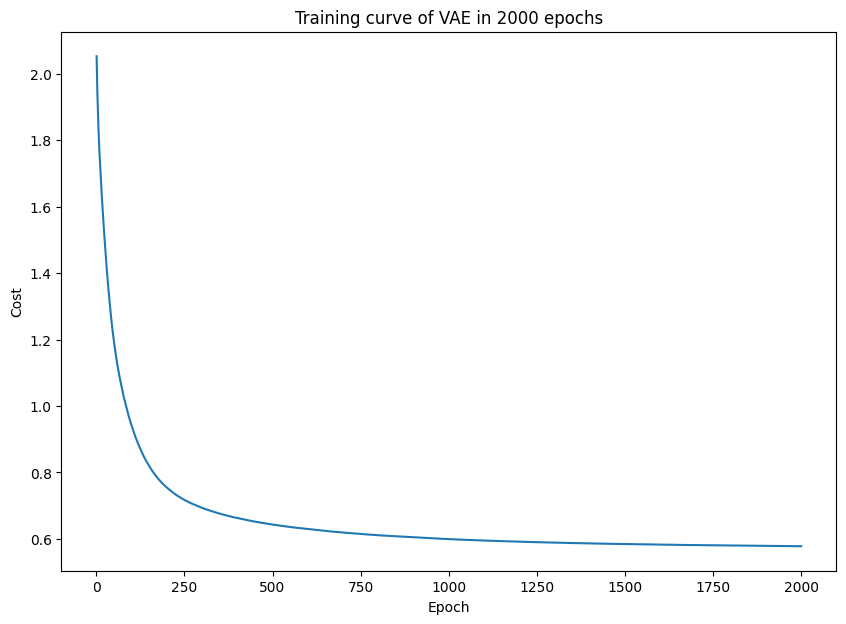

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


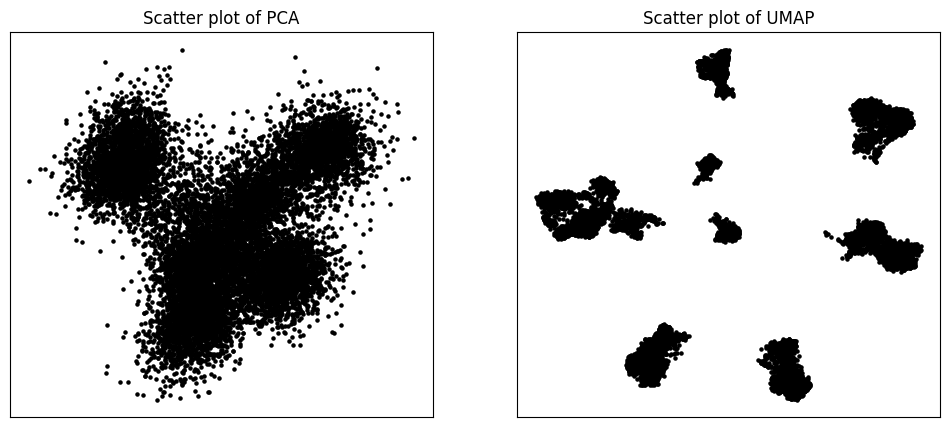

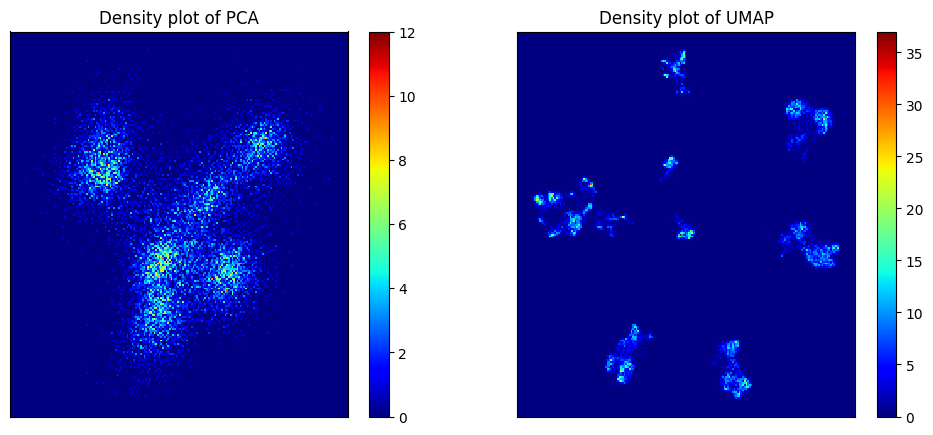

Start clustering.
2 clusters, Distortion: 358084.812500
3 clusters, Distortion: 202270.750000
4 clusters, Distortion: 122780.523438
5 clusters, Distortion: 88264.070312
6 clusters, Distortion: 31769.289062
7 clusters, Distortion: 19243.453125
8 clusters, Distortion: 18451.375000
9 clusters, Distortion: 10306.549805
10 clusters, Distortion: 10242.285156
11 clusters, Distortion: 7784.880859
12 clusters, Distortion: 7283.650391
13 clusters, Distortion: 5829.837891
14 clusters, Distortion: 5842.623047
15 clusters, Distortion: 4660.607422
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


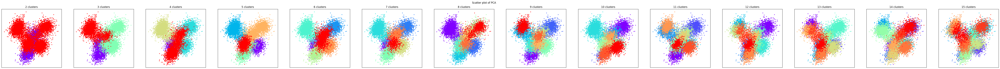

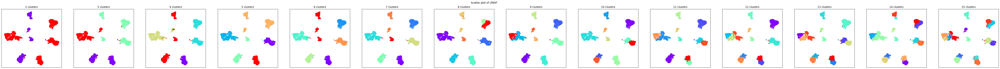

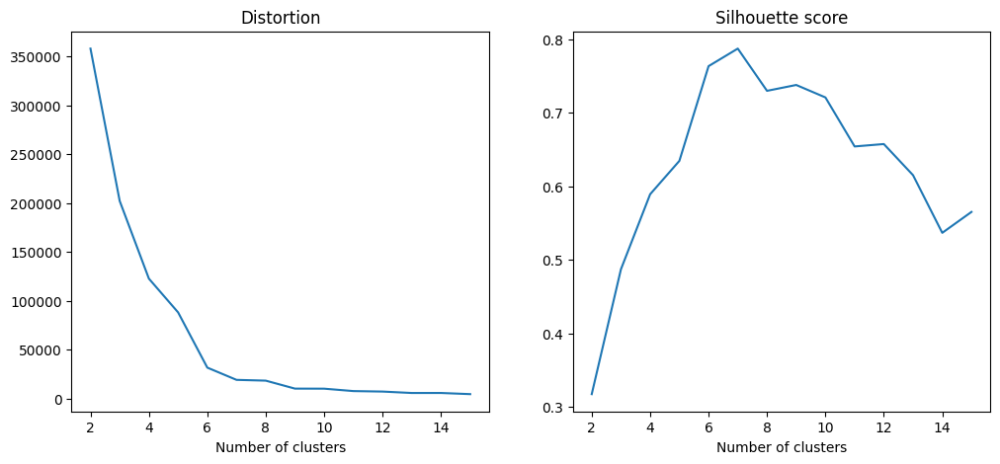

PCA and UMAP of individual clusters will be shown below.


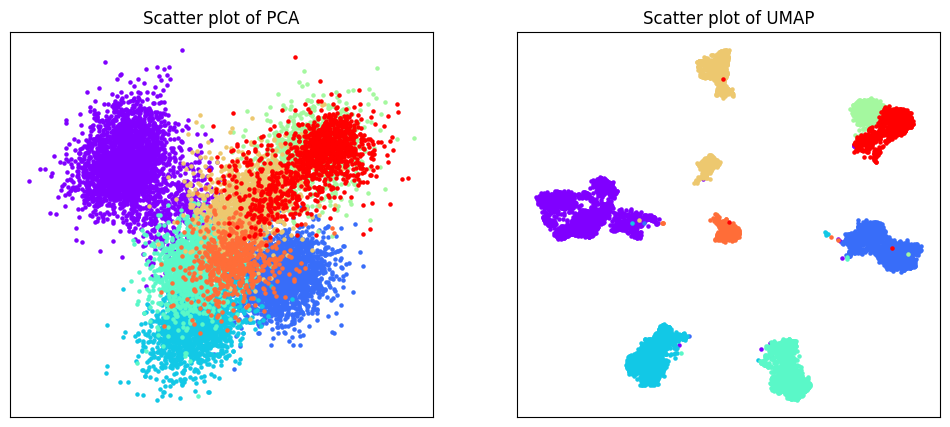

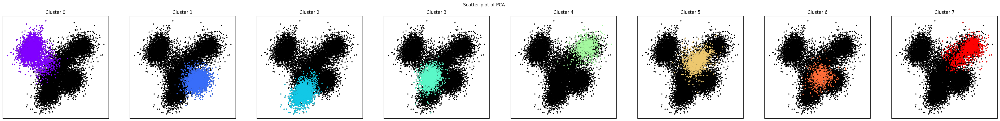

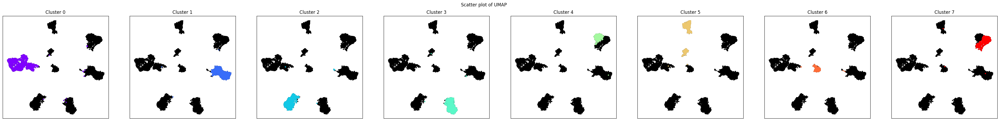

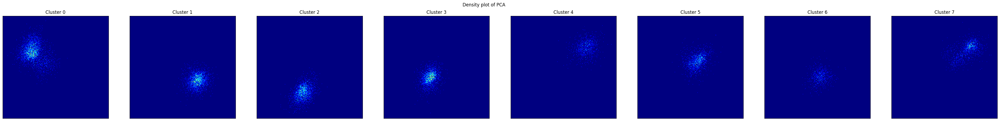

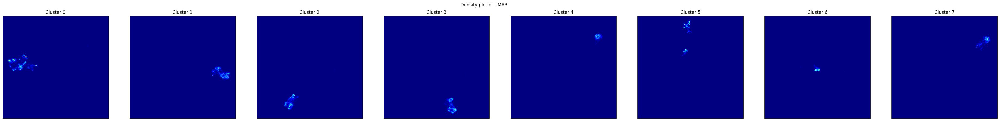

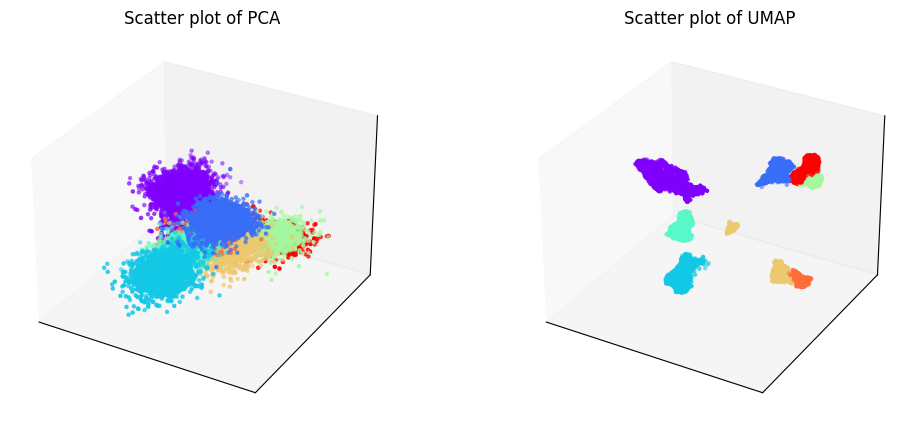

Phylogenetic tree in latent space will be shown below.


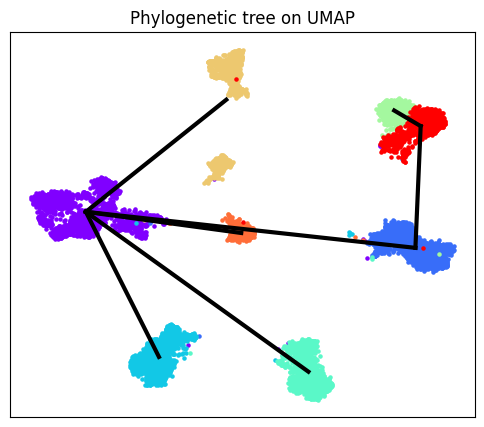

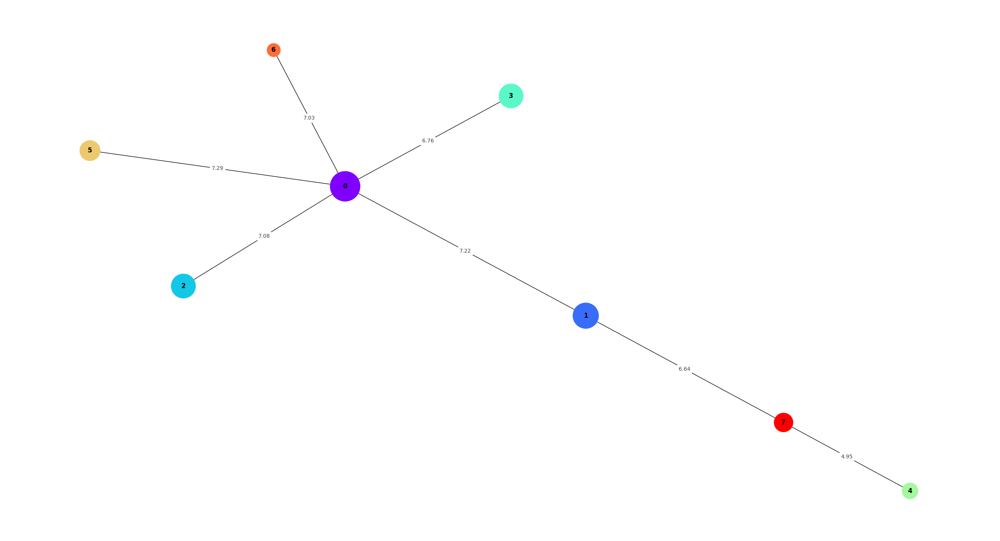

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


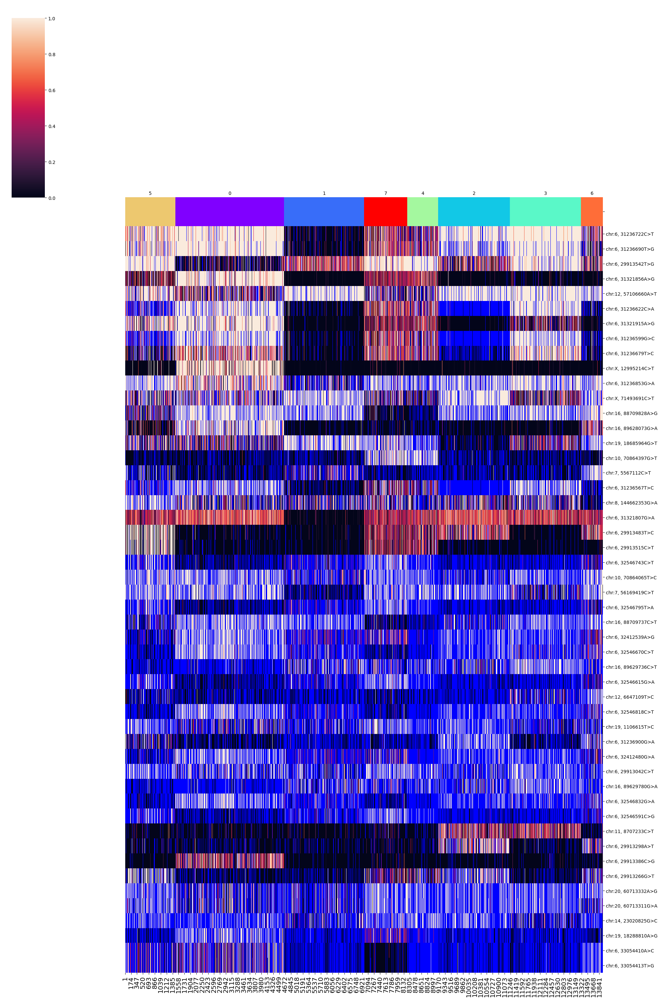

SNPs sorted by lowest p-value will be shown below


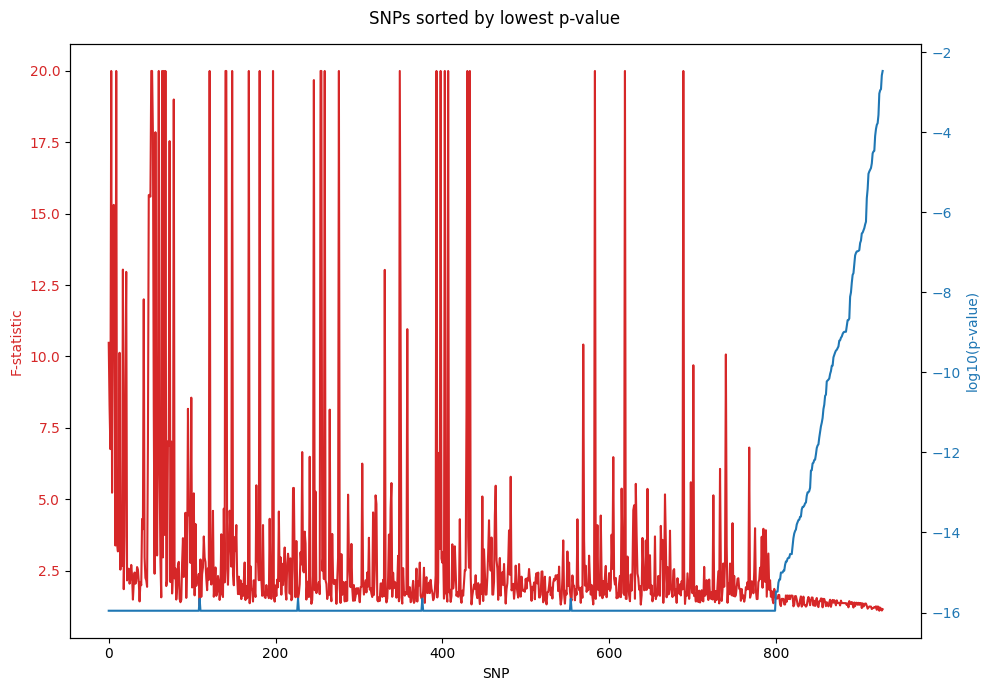

In [24]:
del D_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_30 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
D_30.filtering()
D_30.training(z_dim = np.ceil(929 / 30).astype(int))
D_30.clustering(algorithm = "kmeans_umap3d")
D_30.phylogeny(cluster_no = 8)

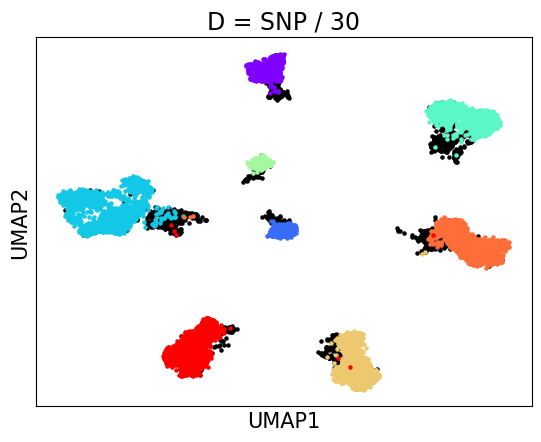

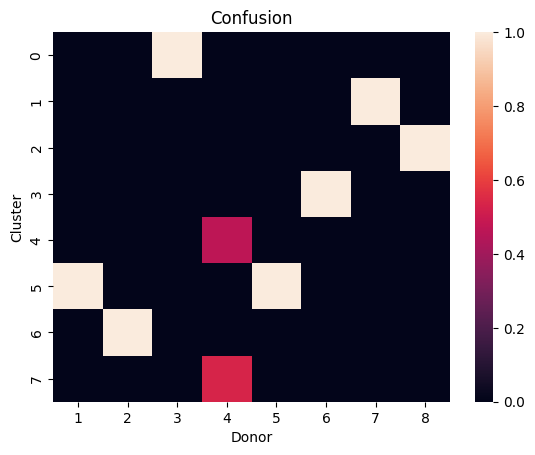

accuracy: 94.09129750421259
silhouette score: 0.8309914650867134


In [25]:
D_30_embedding_2d = D_30.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[D_30.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[D_30.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(D_30.embedding_2d[donors[8], 0], D_30.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(D_30.embedding_2d[donors[w], 0], D_30.embedding_2d[donors[w], 1], s = 5, color = D_30.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 30", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = D_30.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(D_30.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_30.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


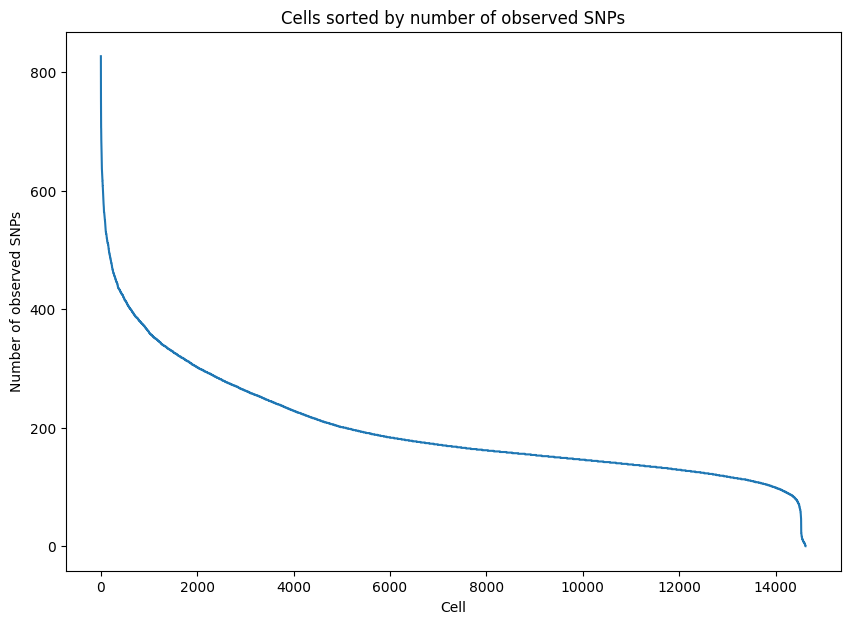

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


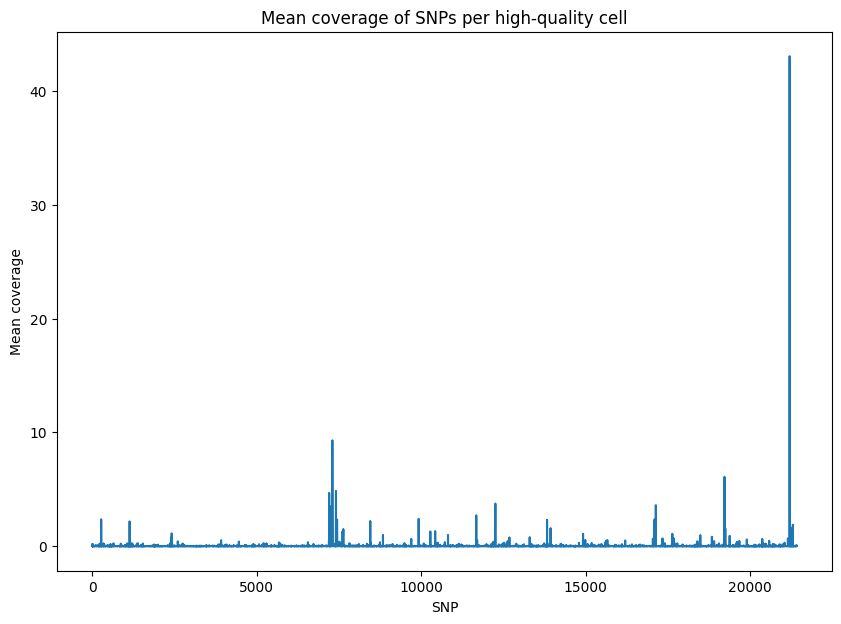

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


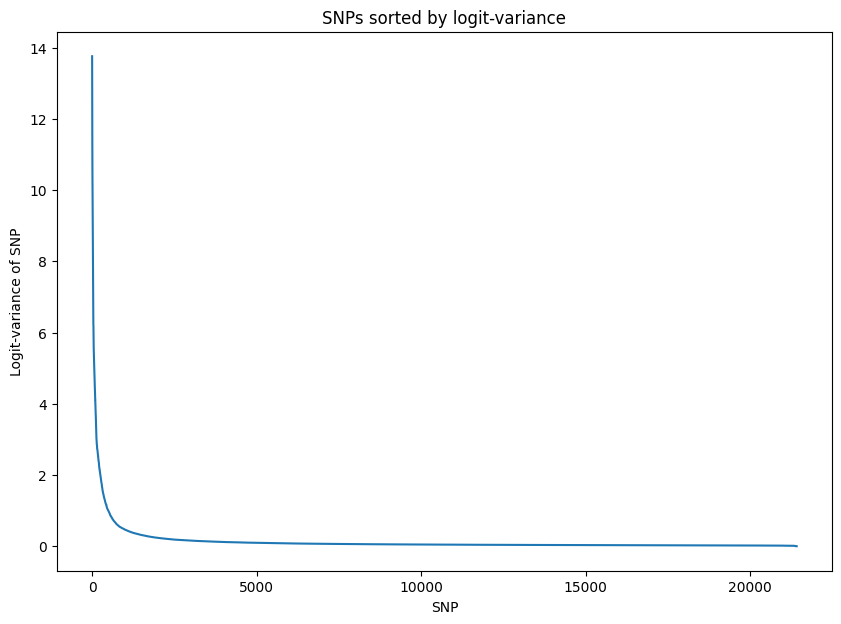

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.820368
Epoch[20/2000], Cost: 1.673441
Epoch[30/2000], Cost: 1.555182
Epoch[40/2000], Cost: 1.451124
Epoch[50/2000], Cost: 1.361960
Epoch[60/2000], Cost: 1.287037
Epoch[70/2000], Cost: 1.222779
Epoch[80/2000], Cost: 1.168988
Epoch[90/2000], Cost: 1.123319
Epoch[100/2000], Cost: 1.084610
Epoch[200/2000], Cost: 0.870649
Epoch[300/2000], Cost: 0.773941
Epoch[400/2000], Cost: 0.725602
Epoch[500/2000], Cost: 0.700577
Epoch[600/2000], Cost: 0.685130
Epoch[700/2000], Cost: 0.674150
Epoch[800/2000], Cost: 0.665758
Epoch[900/2000], Cost: 0.659268
Epoch[1000/2000], Cost: 0.654099
Epoch[1100/2000], Cost: 0.649854
Epoch[1200/2000], Cost: 0.646345
Epoch[1300/2000], Cost: 0.643372
Epoch[1400/2000], Cost: 0.640828
Epoch[1500/2000], Cost: 0.638670
Epoch[1600/20

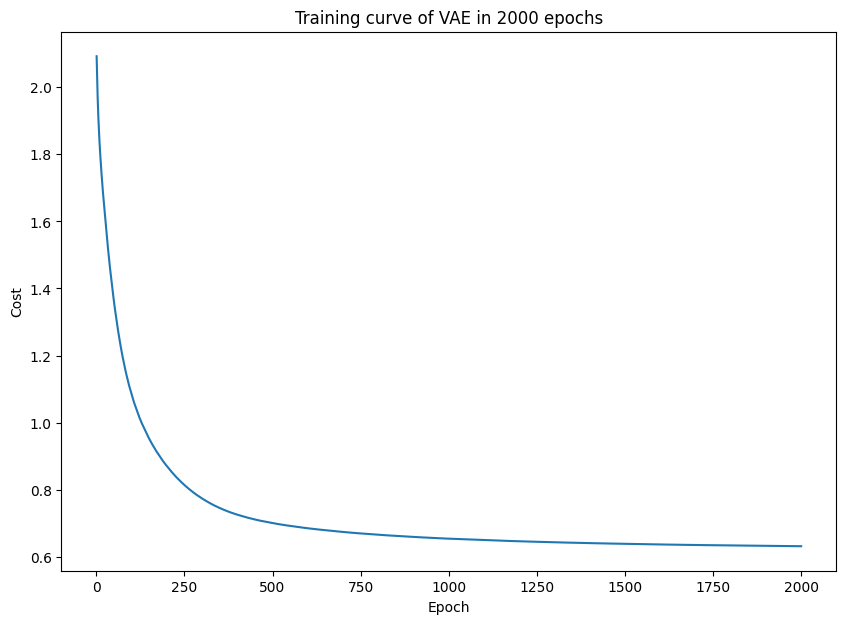

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


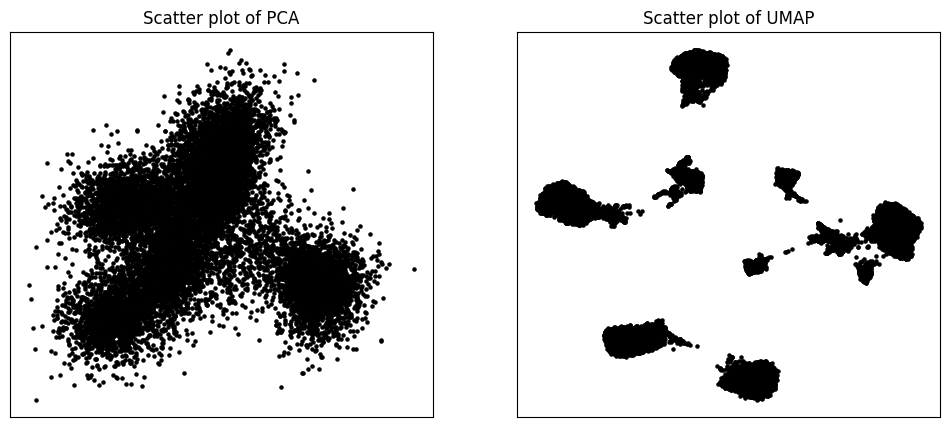

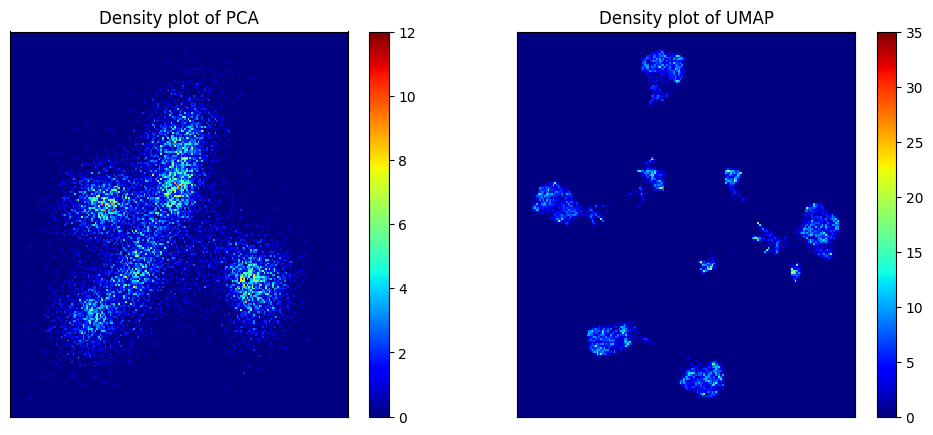

Start clustering.
2 clusters, Distortion: 335088.406250
3 clusters, Distortion: 236218.718750
4 clusters, Distortion: 113809.250000
5 clusters, Distortion: 81874.343750
6 clusters, Distortion: 64673.164062
7 clusters, Distortion: 29075.732422
8 clusters, Distortion: 14173.565430
9 clusters, Distortion: 10177.312500
10 clusters, Distortion: 8896.720703
11 clusters, Distortion: 7914.308105
12 clusters, Distortion: 8150.436035
13 clusters, Distortion: 6870.438477
14 clusters, Distortion: 7258.159180
15 clusters, Distortion: 5602.002441
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


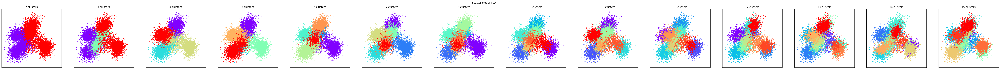

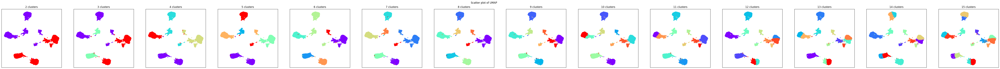

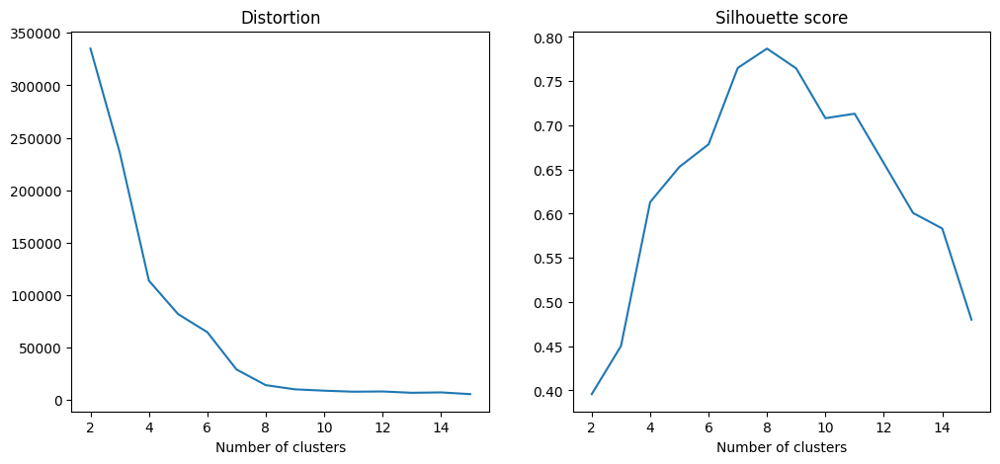

PCA and UMAP of individual clusters will be shown below.


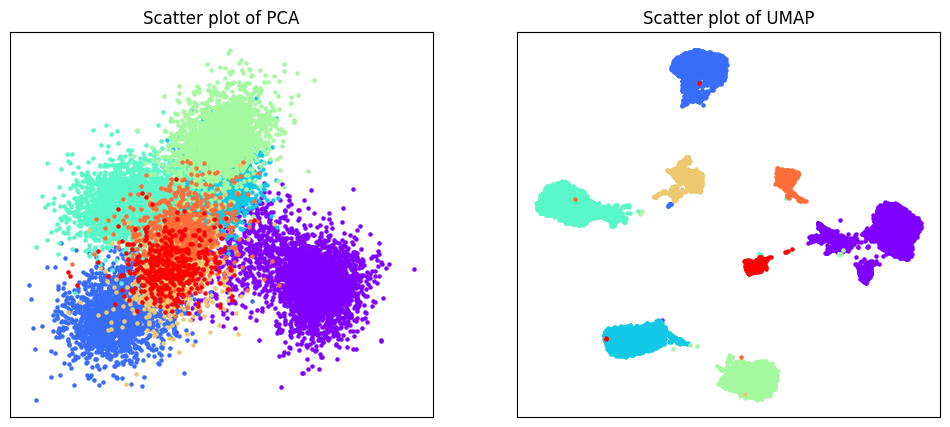

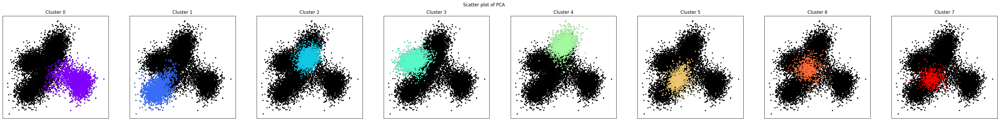

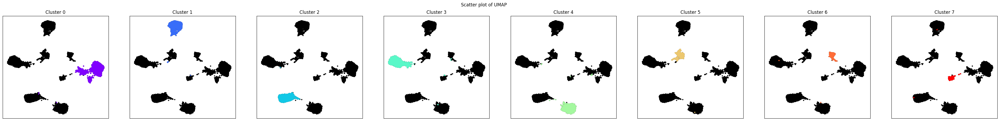

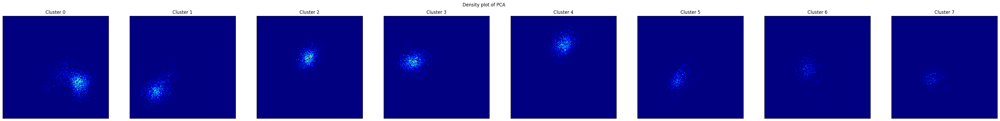

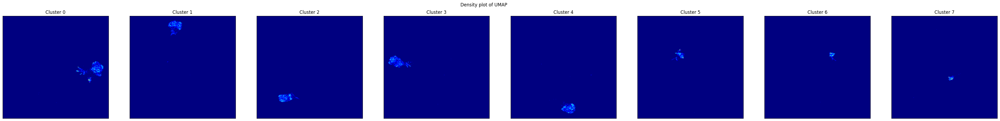

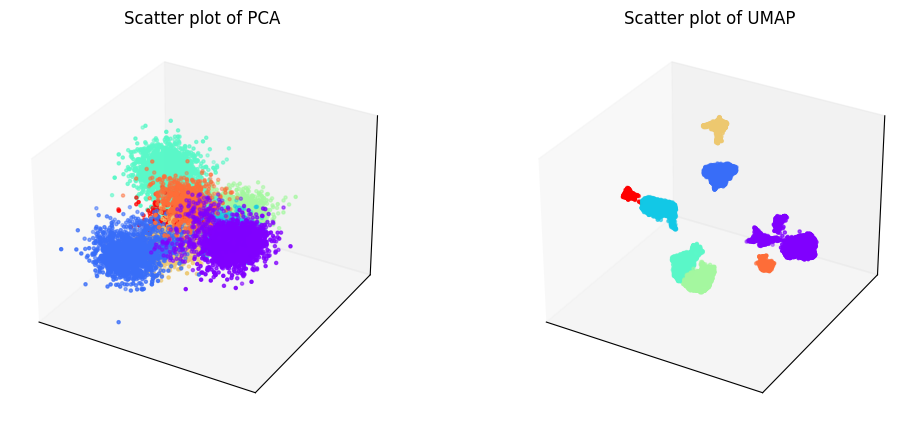

Phylogenetic tree in latent space will be shown below.


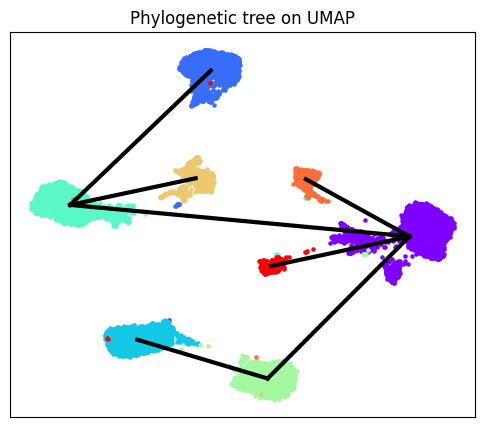

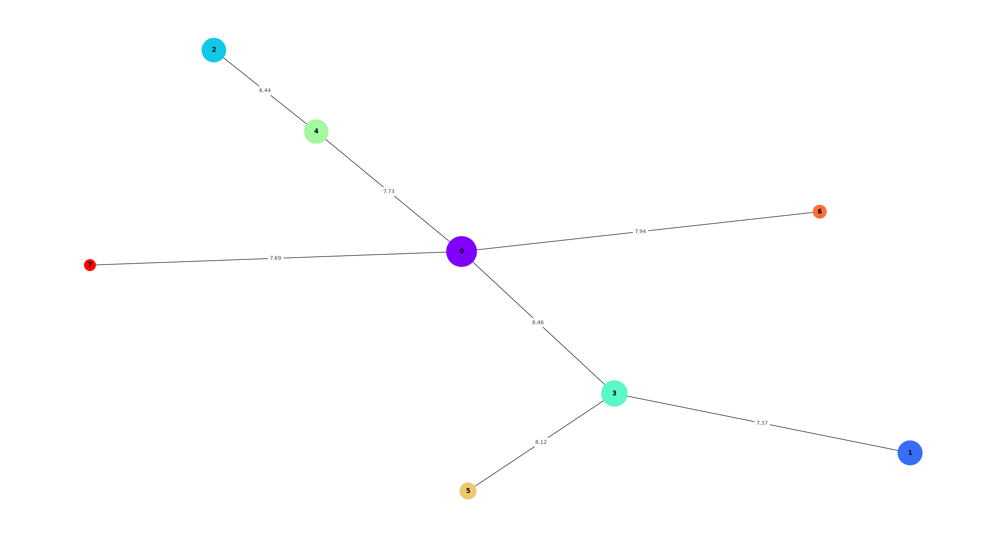

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


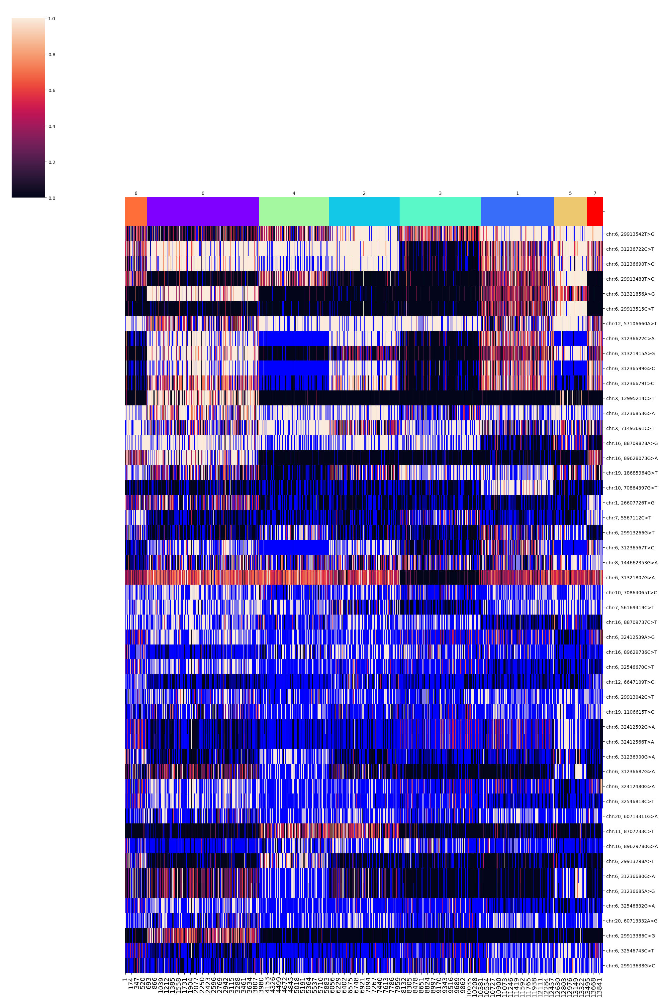

SNPs sorted by lowest p-value will be shown below


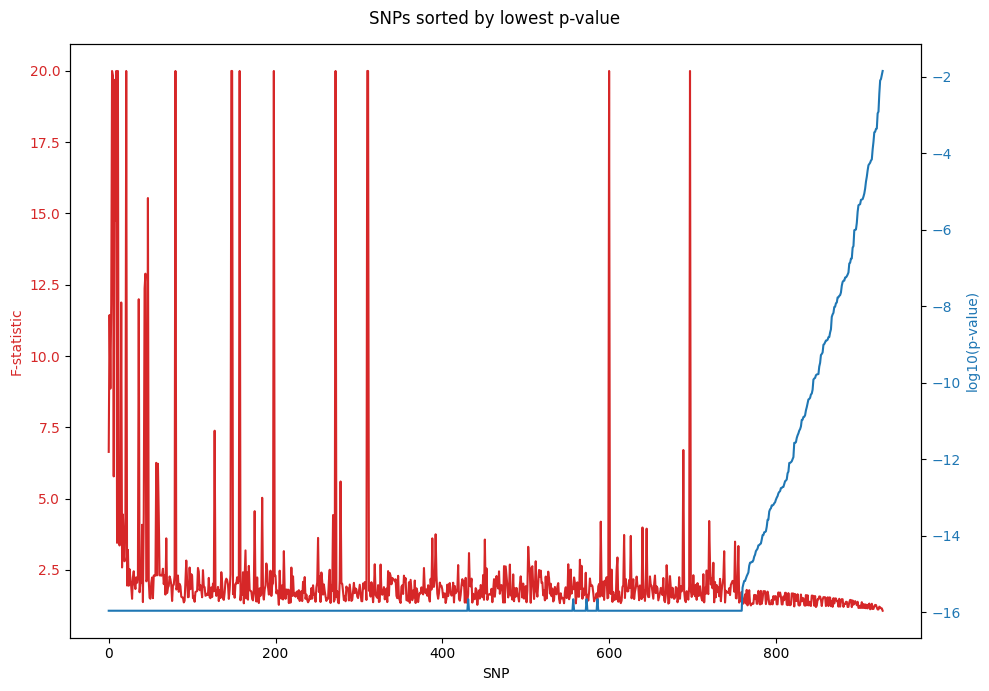

In [26]:
del D_30

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_50 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
D_50.filtering()
D_50.training(z_dim = np.ceil(929 / 50).astype(int))
D_50.clustering(algorithm = "kmeans_umap3d")
D_50.phylogeny(cluster_no = 8)

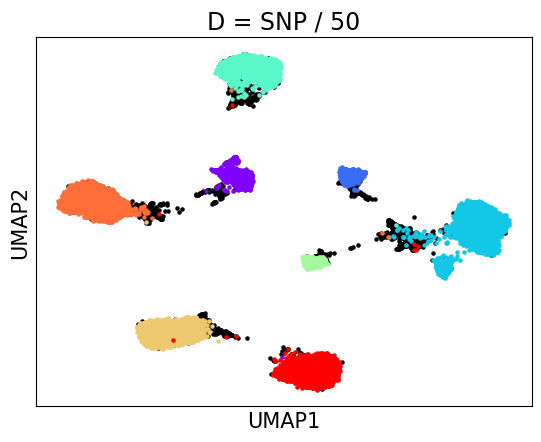

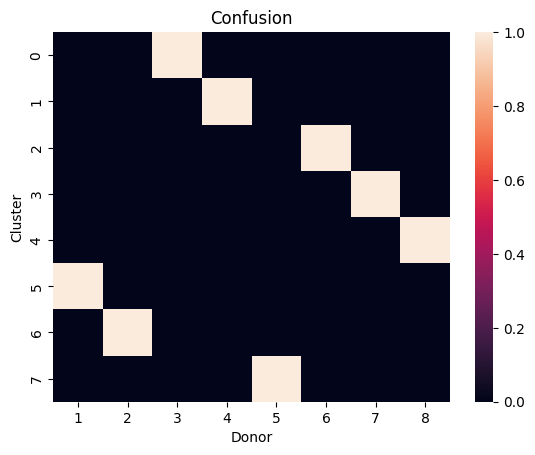

accuracy: 99.87787595343877
silhouette score: 0.8209082446904723


In [27]:
D_50_embedding_2d = D_50.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[D_50.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[D_50.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(D_50.embedding_2d[donors[8], 0], D_50.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(D_50.embedding_2d[donors[w], 0], D_50.embedding_2d[donors[w], 1], s = 5, color = D_50.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 50", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = D_50.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(D_50.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_50.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


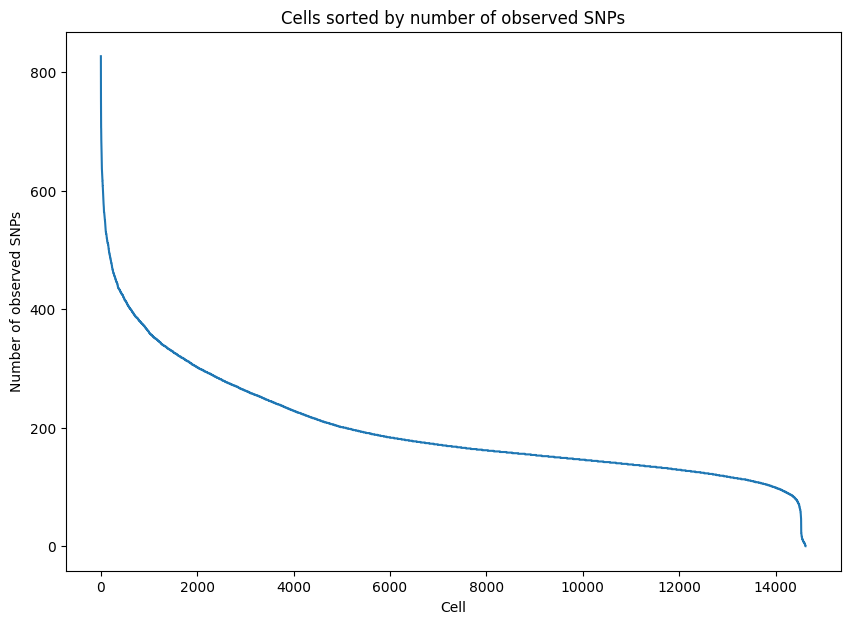

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


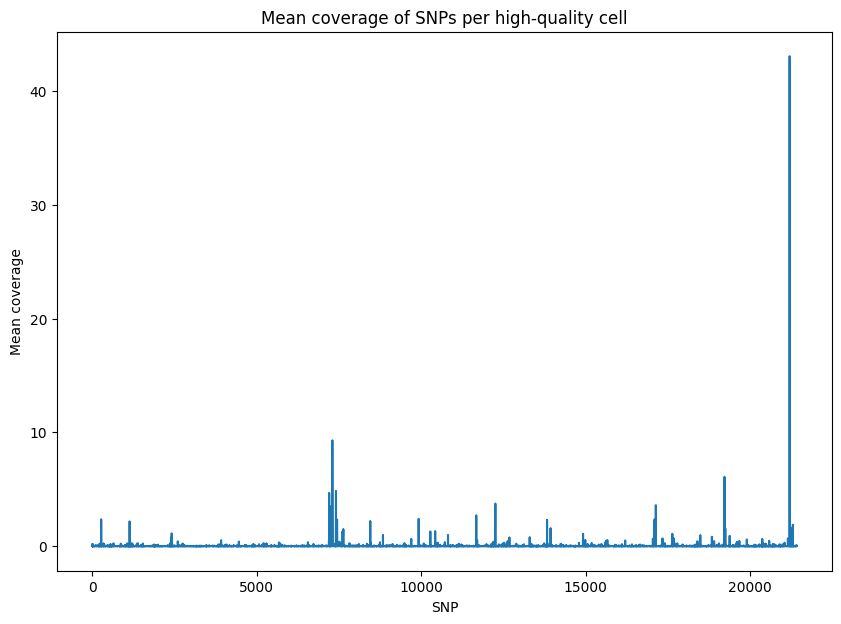

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


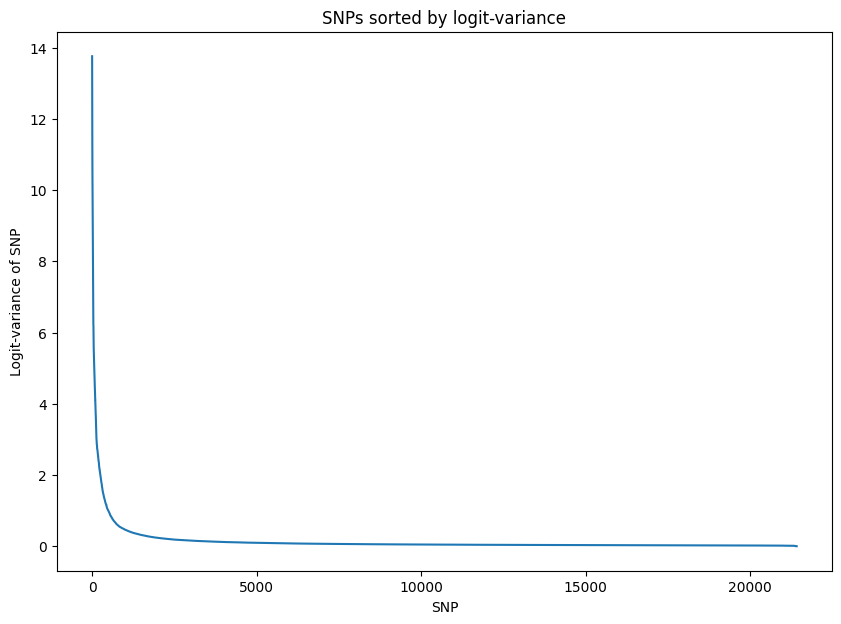

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.882100
Epoch[20/2000], Cost: 1.786754
Epoch[30/2000], Cost: 1.722281
Epoch[40/2000], Cost: 1.664671
Epoch[50/2000], Cost: 1.610547
Epoch[60/2000], Cost: 1.558643
Epoch[70/2000], Cost: 1.508433
Epoch[80/2000], Cost: 1.460638
Epoch[90/2000], Cost: 1.415537
Epoch[100/2000], Cost: 1.373141
Epoch[200/2000], Cost: 1.097922
Epoch[300/2000], Cost: 0.976769
Epoch[400/2000], Cost: 0.900989
Epoch[500/2000], Cost: 0.844585
Epoch[600/2000], Cost: 0.802723
Epoch[700/2000], Cost: 0.771823
Epoch[800/2000], Cost: 0.749795
Epoch[900/2000], Cost: 0.734661
Epoch[1000/2000], Cost: 0.724255
Epoch[1100/2000], Cost: 0.717003
Epoch[1200/2000], Cost: 0.711560
Epoch[1300/2000], Cost: 0.707326
Epoch[1400/2000], Cost: 0.703798
Epoch[1500/2000], Cost: 0.700805
Epoch[1600/20

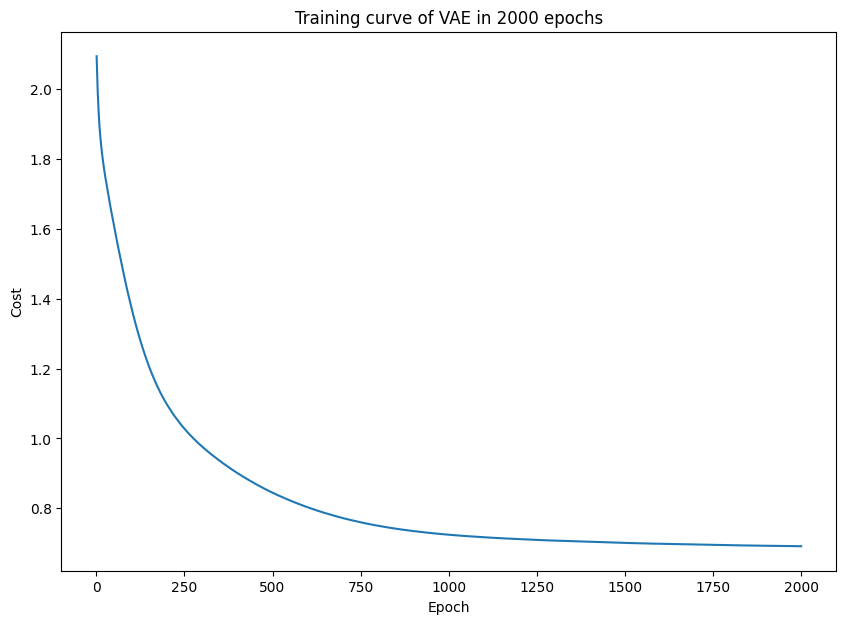

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


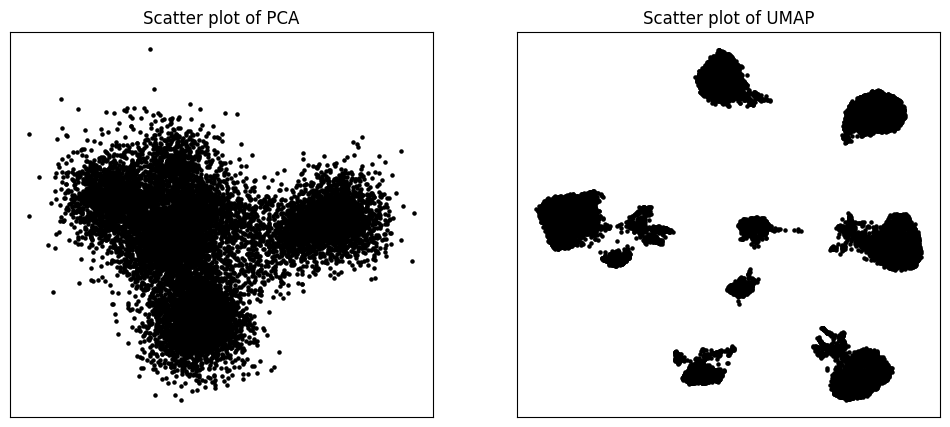

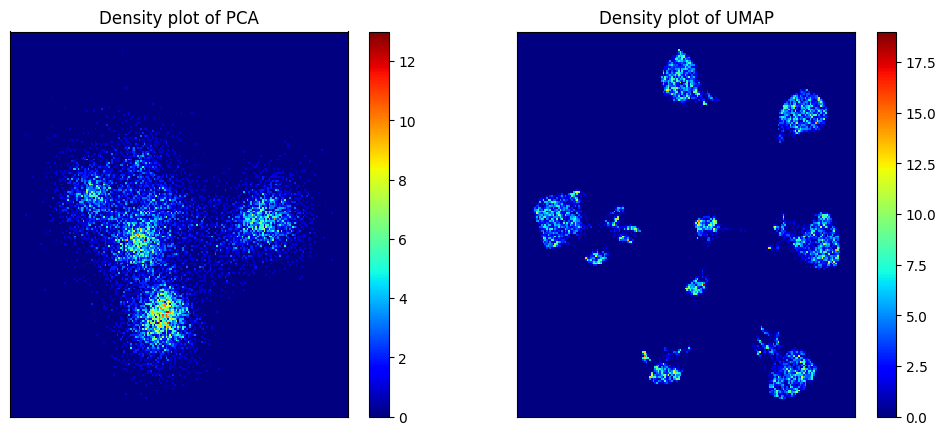

Start clustering.
2 clusters, Distortion: 436514.937500
3 clusters, Distortion: 256956.000000
4 clusters, Distortion: 110056.218750
5 clusters, Distortion: 74983.898438
6 clusters, Distortion: 47398.902344
7 clusters, Distortion: 23153.064453
8 clusters, Distortion: 22550.968750
9 clusters, Distortion: 14722.849609
10 clusters, Distortion: 12123.753906
11 clusters, Distortion: 12810.135742
12 clusters, Distortion: 9550.660156
13 clusters, Distortion: 9150.131836
14 clusters, Distortion: 9167.610352
15 clusters, Distortion: 8185.419922
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


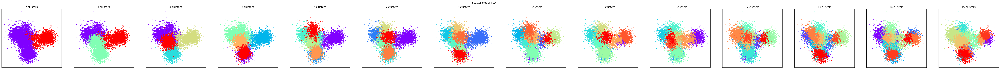

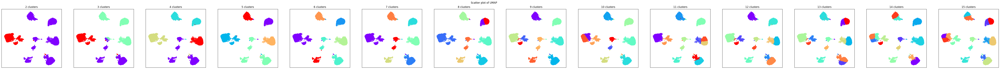

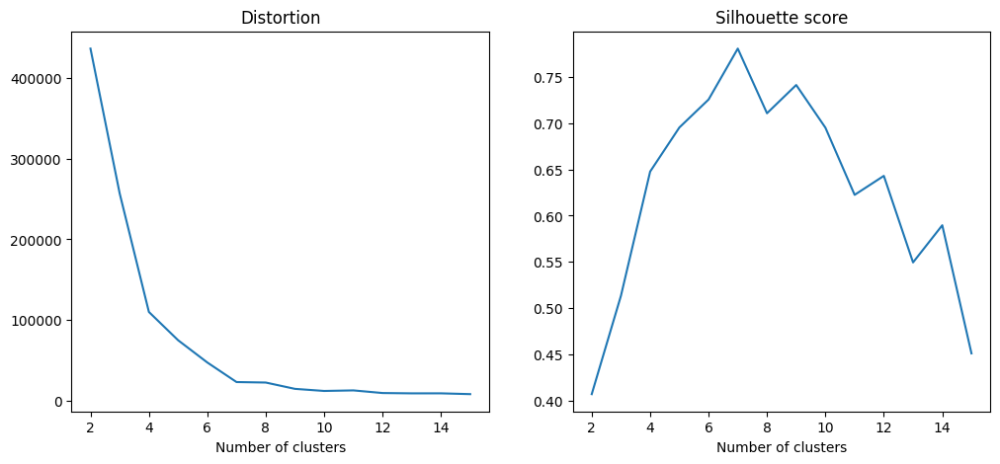

PCA and UMAP of individual clusters will be shown below.


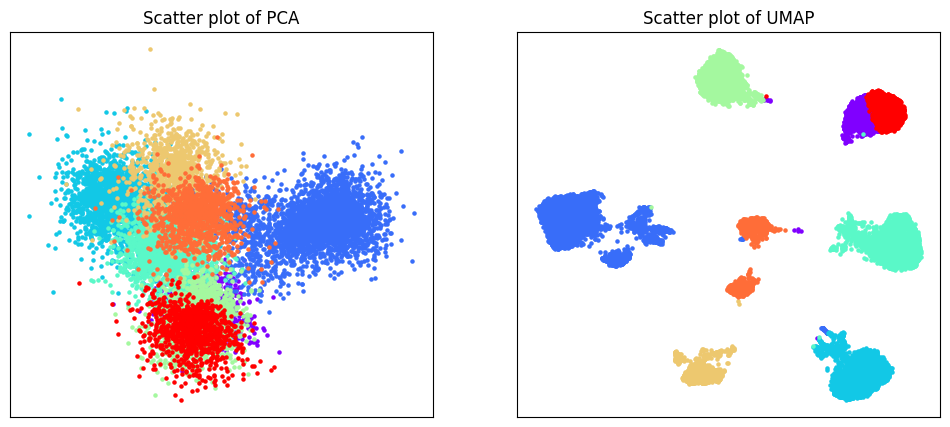

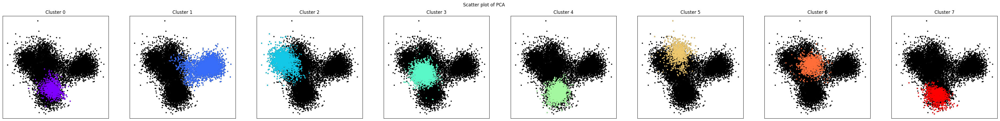

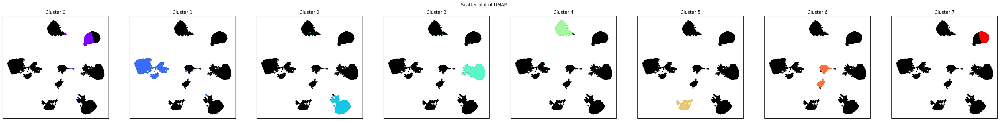

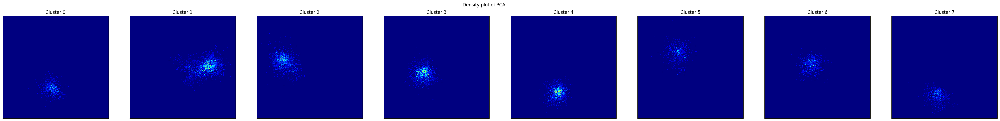

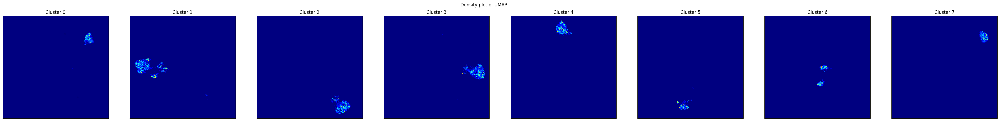

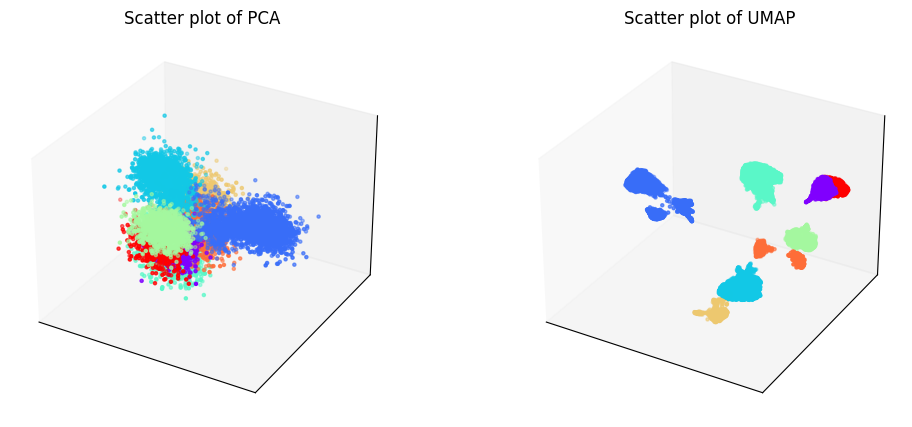

Phylogenetic tree in latent space will be shown below.


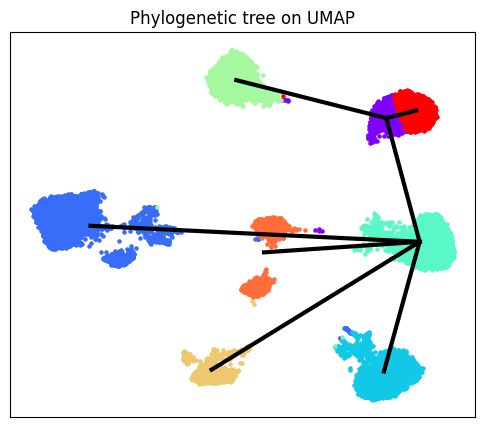

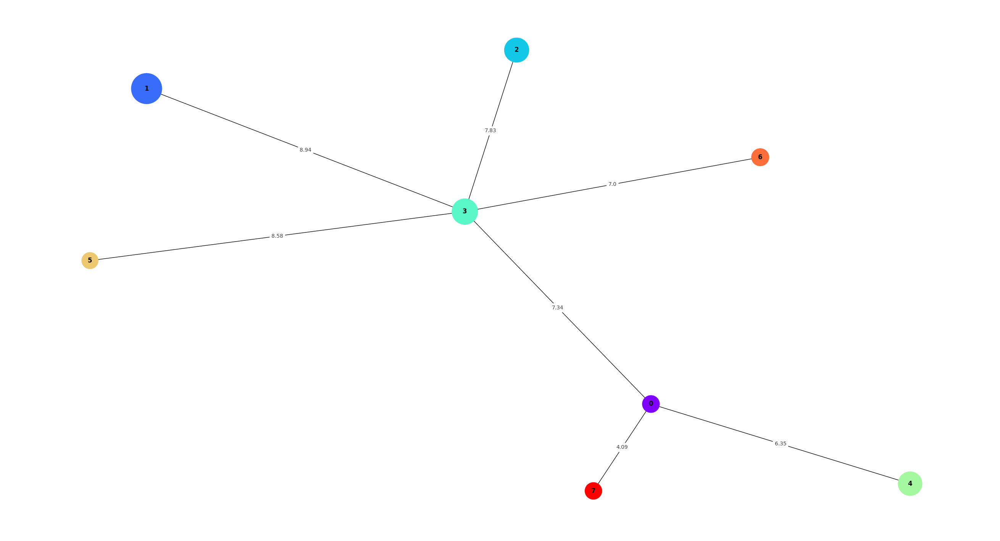

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


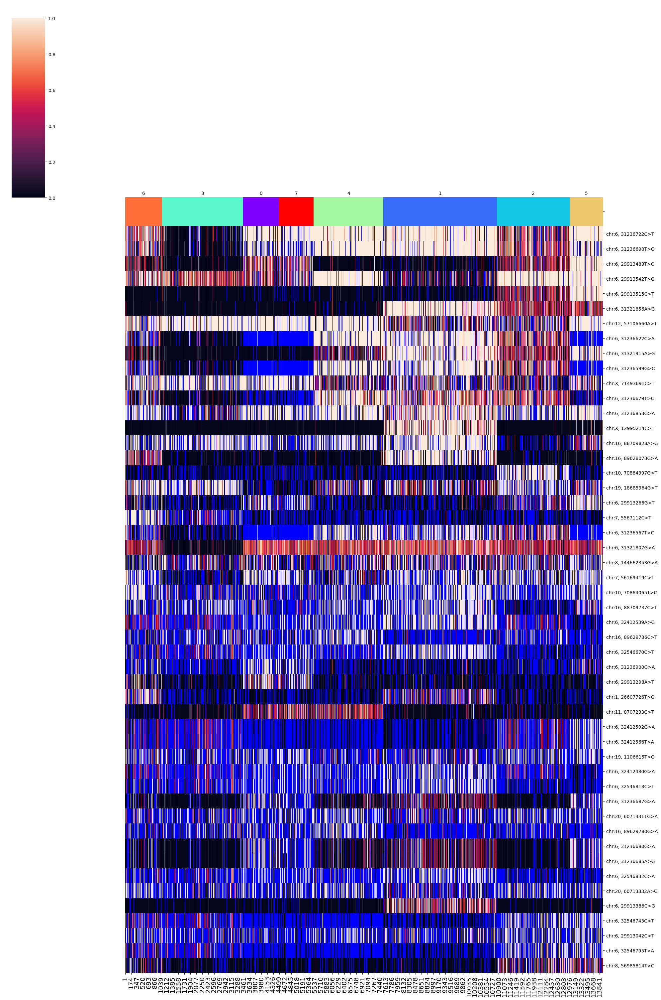

SNPs sorted by lowest p-value will be shown below


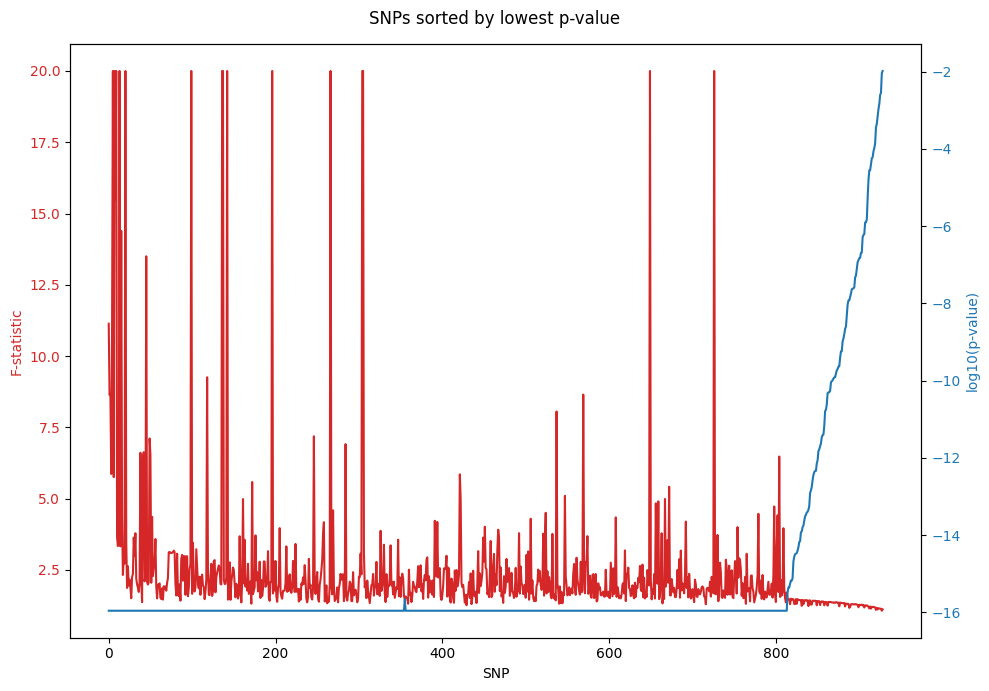

In [28]:
del D_50

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_100 = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8")
D_100.filtering()
D_100.training(z_dim = np.ceil(929 / 100).astype(int))
D_100.clustering(algorithm = "kmeans_umap3d")
D_100.phylogeny(cluster_no = 8)

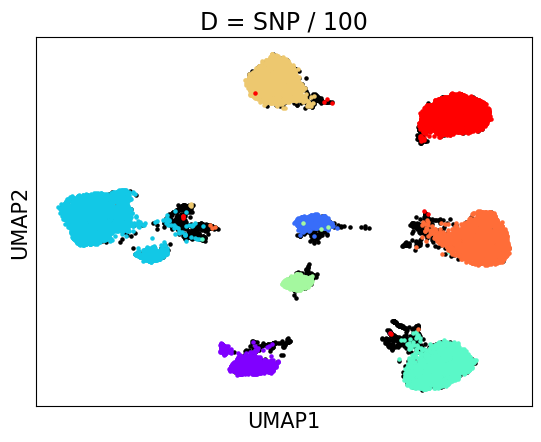

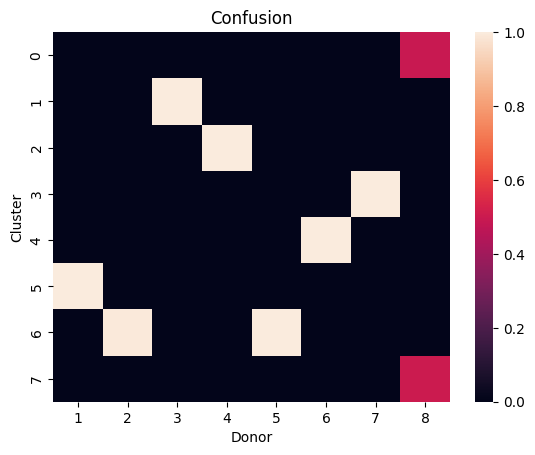

accuracy: 93.63758515949634
silhouette score: 0.8172572562489043


In [29]:
D_100_embedding_2d = D_100.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[D_100.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[D_100.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(D_100.embedding_2d[donors[8], 0], D_100.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(D_100.embedding_2d[donors[w], 0], D_100.embedding_2d[donors[w], 1], s = 5, color = D_100.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 100", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = D_100.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(D_100.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_100.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


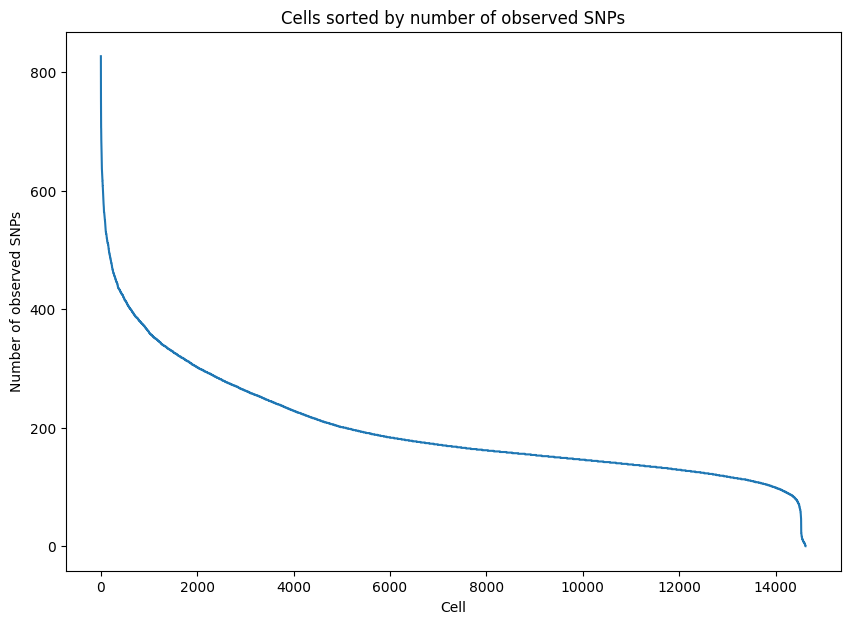

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   100


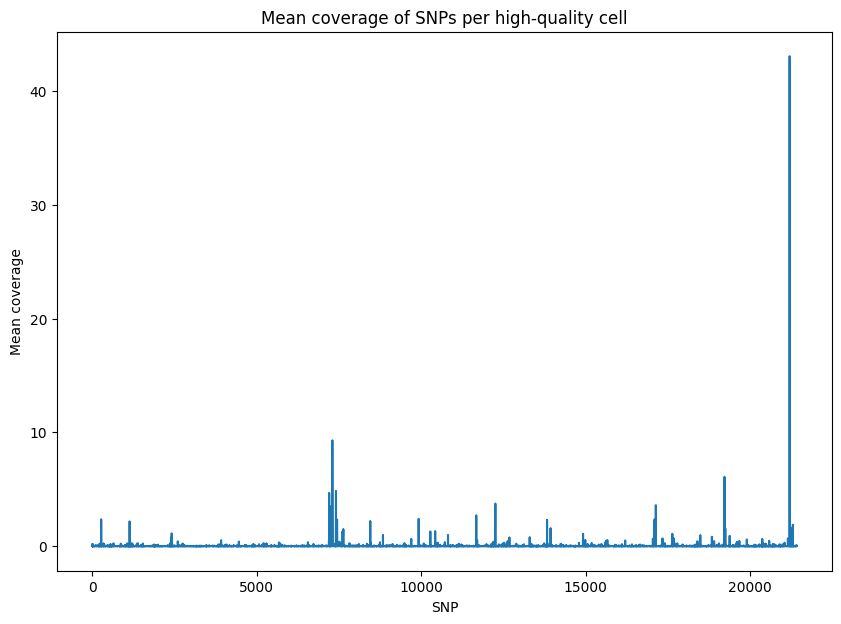

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


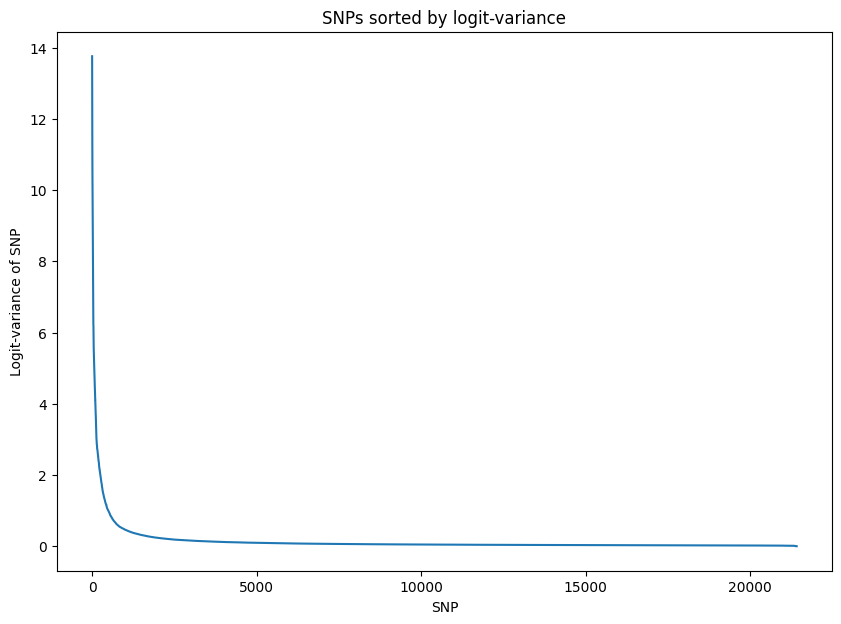

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 13939 cells and 929 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.148147
Epoch[20/2000], Cost: 0.907098
Epoch[30/2000], Cost: 0.792419
Epoch[40/2000], Cost: 0.725623
Epoch[50/2000], Cost: 0.679159
Epoch[60/2000], Cost: 0.642972
Epoch[70/2000], Cost: 0.613601
Epoch[80/2000], Cost: 0.588621
Epoch[90/2000], Cost: 0.567042
Epoch[100/2000], Cost: 0.548054
Epoch[200/2000], Cost: 0.441691
Epoch[300/2000], Cost: 0.402535
Epoch[400/2000], Cost: 0.384920
Epoch[500/2000], Cost: 0.375757
Epoch[600/2000], Cost: 0.370613
Epoch[700/2000], Cost: 0.367512
Epoch[800/2000], Cost: 0.365600
Epoch[900/2000], Cost: 0.364394
Epoch[1000/2000], Cost: 0.363554
Epoch[1100/2000], Cost: 0.363052
Epoch[1200/2000], Cost: 0.362602
Epoch[1300/2000], Cost: 0.362326
Epoch[1400/2000], Cost: 0.362151
Epoch[1500/2000], Cost: 0.362224
Epoch[1600/20

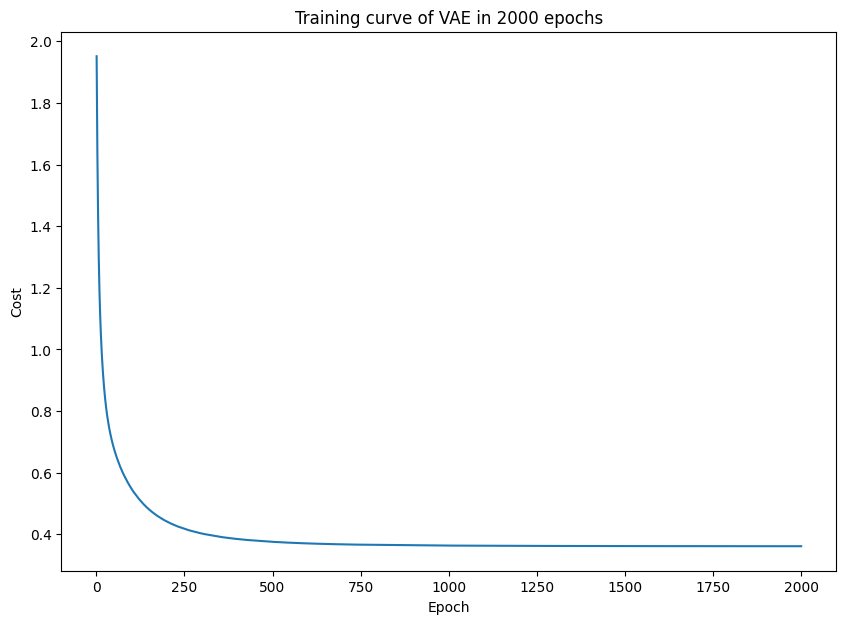

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


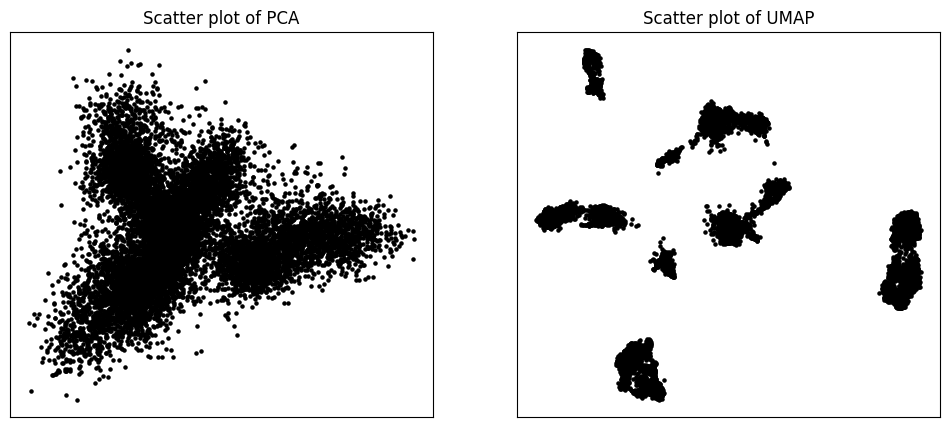

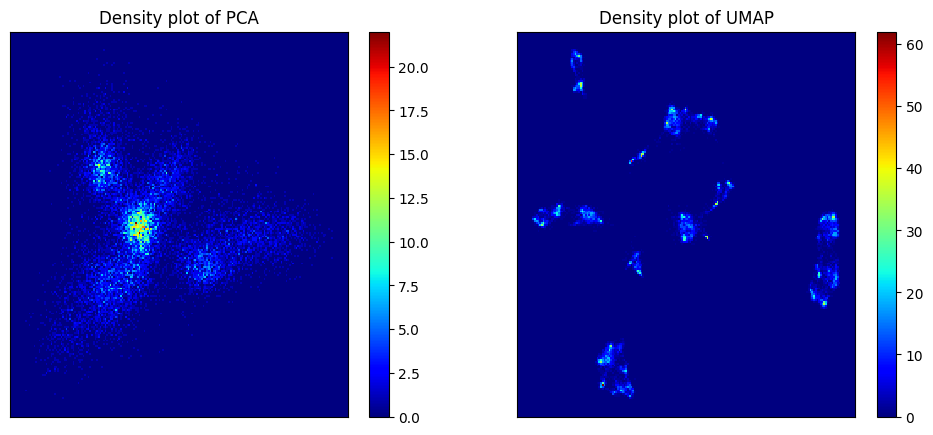

Start clustering.
2 clusters, Distortion: 334971.437500
3 clusters, Distortion: 166092.718750
4 clusters, Distortion: 67504.718750
5 clusters, Distortion: 41493.546875
6 clusters, Distortion: 34401.511719
7 clusters, Distortion: 22324.091797
8 clusters, Distortion: 17460.134766
9 clusters, Distortion: 16033.175781
10 clusters, Distortion: 9440.186523
11 clusters, Distortion: 7562.361328
12 clusters, Distortion: 5580.885254
13 clusters, Distortion: 5192.277344
14 clusters, Distortion: 4529.798340
15 clusters, Distortion: 3789.402588
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


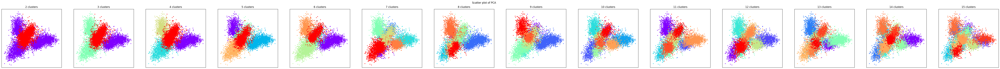

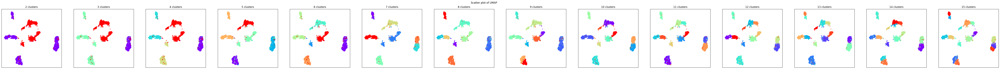

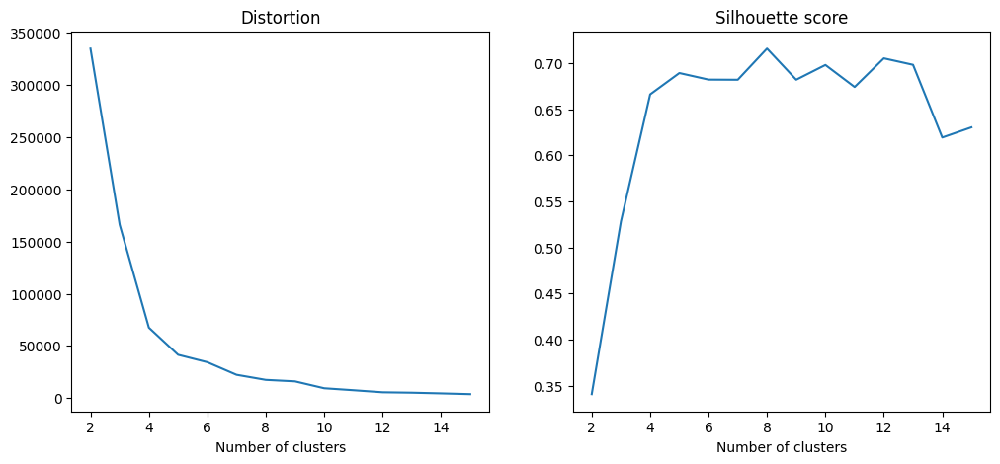

PCA and UMAP of individual clusters will be shown below.


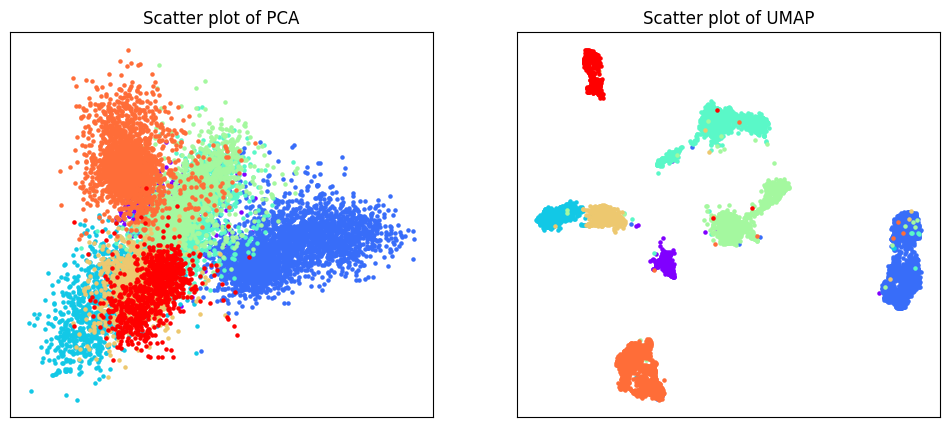

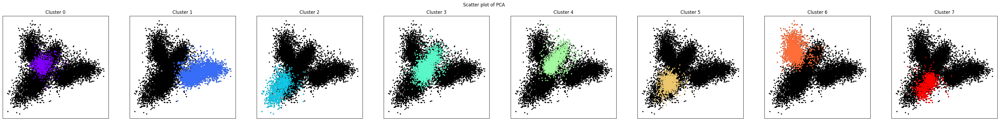

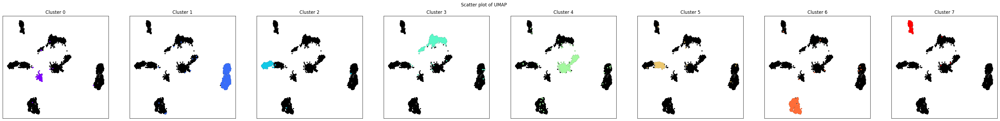

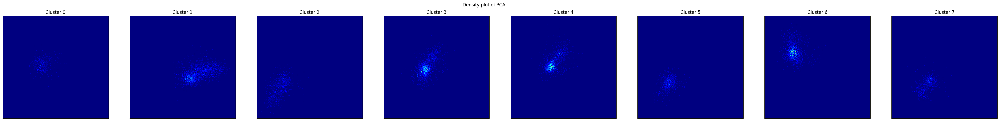

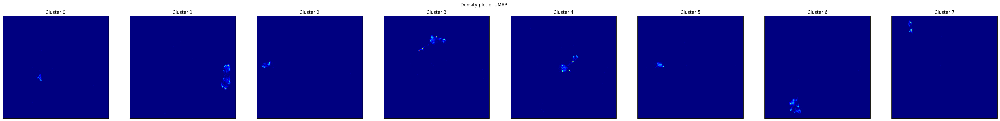

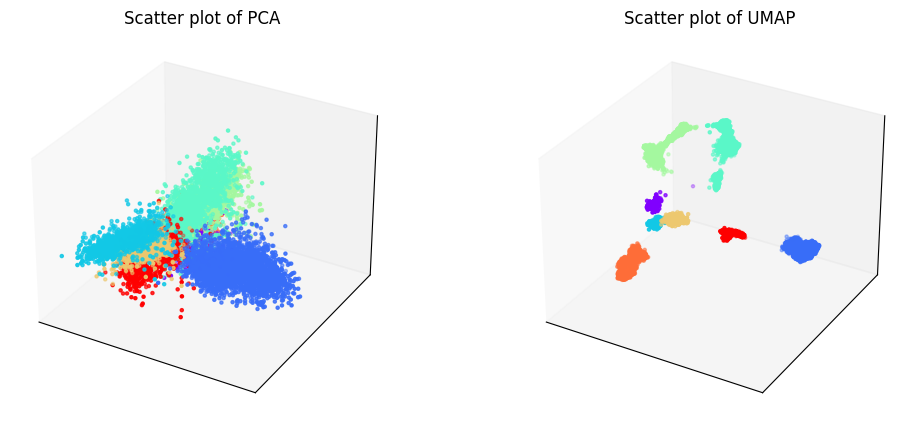

Phylogenetic tree in latent space will be shown below.


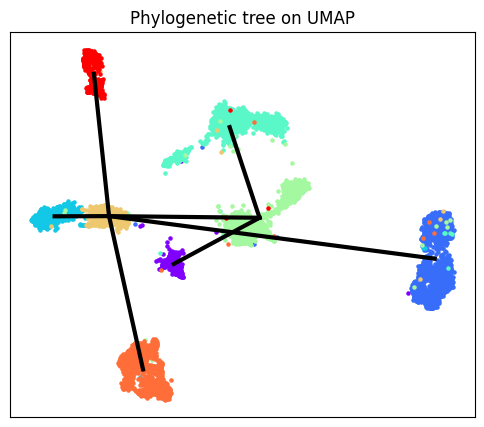

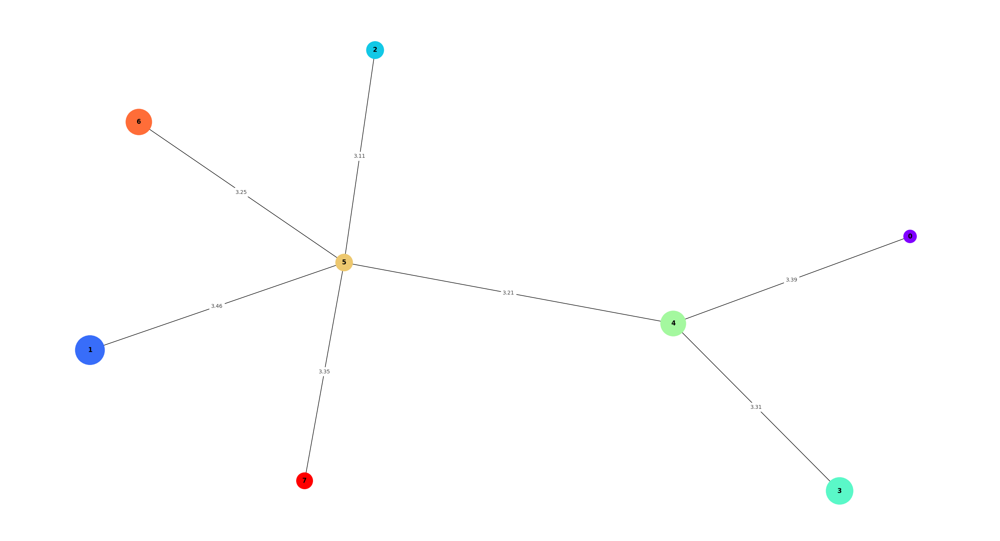

/tmp/ipykernel_1810998/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 13939 cells and 50 SNPs will be shown below.


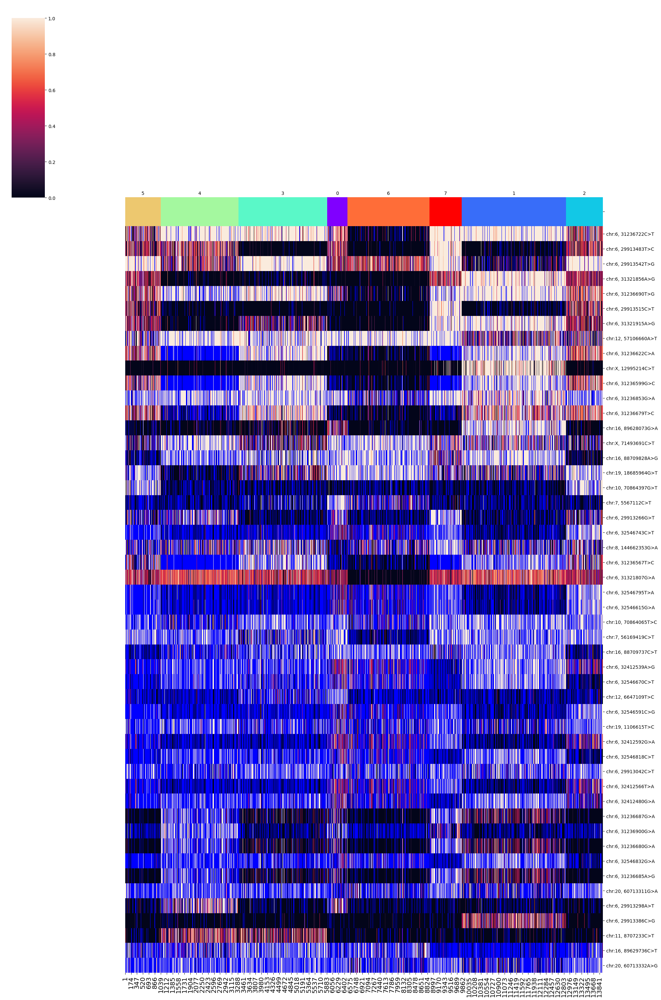

SNPs sorted by lowest p-value will be shown below


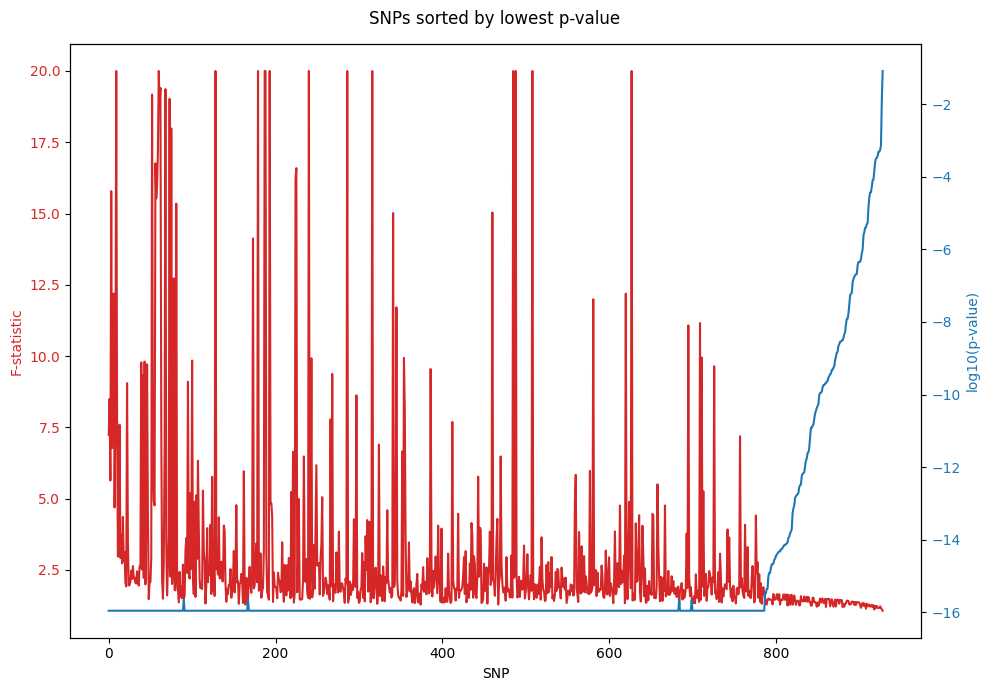

In [33]:
%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

unnormalized = SNP_VAE(path = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8", SNPread = 'unnormalized')
unnormalized.filtering()
unnormalized.training()
unnormalized.clustering(algorithm = "kmeans_umap3d")
unnormalized.phylogeny(cluster_no = 8)

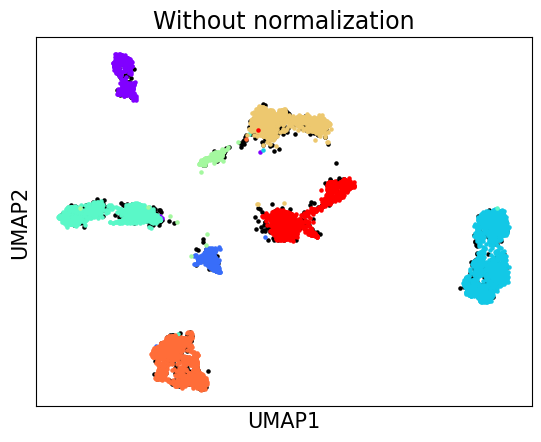

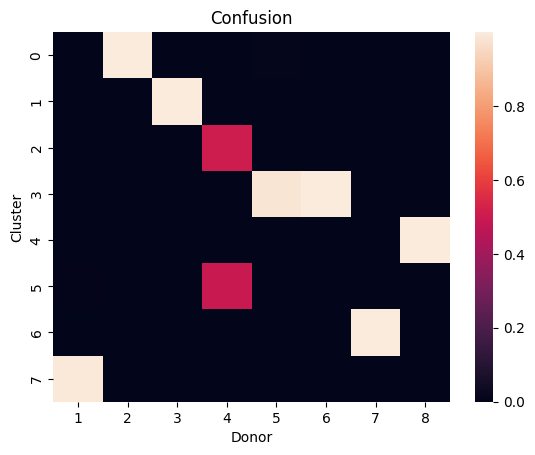

accuracy: 93.37962177587528
silhouette score: 0.711900841079888


In [34]:
unnormalized_embedding_2d = unnormalized.embedding_2d

df = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/id.csv', delimiter = ',')[unnormalized.cell_filter]
doublet = np.genfromtxt('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor8/doublet.csv', delimiter = ',')[unnormalized.cell_filter]
df[doublet == 1] = 8

donors = []

fig, axs = plt.subplots(1, 1)

for h in range(9):
    
    donors.append(np.where(df == h)[0])

axs.scatter(unnormalized.embedding_2d[donors[8], 0], unnormalized.embedding_2d[donors[8], 1], s = 5, color = "black")

for w in range(8):
    
    axs.scatter(unnormalized.embedding_2d[donors[w], 0], unnormalized.embedding_2d[donors[w], 1], s = 5, color = unnormalized.colors[w])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("Without normalization", fontsize = 17)

plt.show()

reference = df.astype(int)
predict = unnormalized.assigned_label
    
matrix = np.zeros((8, 8))
ref_sum = np.zeros(8)

for q in range(sum(unnormalized.cell_filter)):
    
    if reference[q] <= 7:

        matrix[reference[q], predict[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(max(predict) + 1))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3, 4, 5, 6, 7], :], xticklabels = [1, 2, 3, 4, 5, 6, 7, 8], yticklabels = [0, 1, 2, 3, 4, 5, 6, 7])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized.pair_embedding_3d[reference <= 7, :][:, reference <= 7], reference[reference <= 7], metric = "precomputed")}')

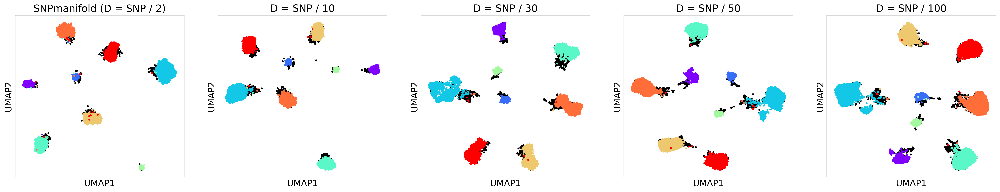

In [35]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[8], 0], normalized_layer1_embedding_2d[donors[8], 1], s = 5, color = "black")
    
for t in range(8):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (D = SNP / 2)", fontsize = 17)

axs[1].scatter(D_10_embedding_2d[donors[8], 0], D_10_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[1].scatter(D_10_embedding_2d[donors[t], 0], D_10_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("D = SNP / 10", fontsize = 17)

axs[2].scatter(D_30_embedding_2d[donors[8], 0], D_30_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[2].scatter(D_30_embedding_2d[donors[t], 0], D_30_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("D = SNP / 30", fontsize = 17)

axs[3].scatter(D_50_embedding_2d[donors[8], 0], D_50_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[3].scatter(D_50_embedding_2d[donors[t], 0], D_50_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("D = SNP / 50", fontsize = 17)

axs[4].scatter(D_100_embedding_2d[donors[8], 0], D_100_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[4].scatter(D_100_embedding_2d[donors[t], 0], D_100_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("D = SNP / 100", fontsize = 17)
    
plt.show()

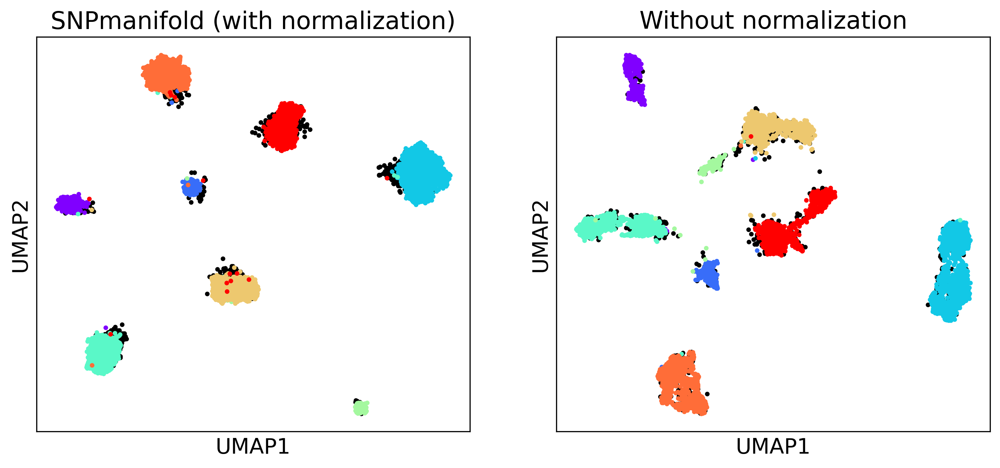

In [36]:
fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(12, 5)

axs[0].scatter(normalized_layer1_embedding_2d[donors[8], 0], normalized_layer1_embedding_2d[donors[8], 1], s = 5, color = "black")
    
for t in range(8):
    
    axs[0].scatter(normalized_layer1_embedding_2d[donors[t], 0], normalized_layer1_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (with normalization)", fontsize = 17)

axs[1].scatter(unnormalized_embedding_2d[donors[8], 0], unnormalized_embedding_2d[donors[8], 1], s = 5, color = "black")

for t in range(8):
    
    axs[1].scatter(unnormalized_embedding_2d[donors[t], 0], unnormalized_embedding_2d[donors[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 8))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("Without normalization", fontsize = 17)
    
plt.show()